In [1]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
# !unzip /content/drive/MyDrive/dissertation/COVID-19-CT-Seg_20cases.zip -d /content/drive/MyDrive/dissertation/covid19cases
# !unzip /content/drive/MyDrive/dissertation/Infection_Mask.zip -d /content/drive/MyDrive/dissertation/infectionmask
import os
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import nibabel as nib
from scipy import ndimage
import matplotlib.pyplot as plt
import glob
import pandas as pd
from sklearn.model_selection import KFold
import seaborn as sns
import matplotlib.gridspec as gridspec
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)

Mounted at /content/drive


#### Dataset

In [2]:
depth = 64
height = 128
width = 128

def read_nifti_file(filepath):
    scan = nib.load(filepath)
    scan = scan.get_fdata()
    return scan

def normalize(volume, radiopaedia=False):
    if radiopaedia:
        min = 0
        max = 255
    else:
        min = -1250
        max = 250
    volume[volume < min] = min
    volume[volume > max] = max
    volume = (volume - min) / (max - min)
    volume = volume.astype("float32")
    return volume

def resize_volume(volume, height, width, depth, order=1):
    current_height = volume.shape[0]
    current_width = volume.shape[1]
    current_depth = volume.shape[2]
    height = current_height / height
    width = current_width / width
    depth = current_depth / depth
    height_factor = 1 / height
    width_factor = 1 / width
    depth_factor = 1 / depth
    volume = ndimage.zoom(volume, (height_factor, width_factor, depth_factor), order=order)
    return volume

def process_scan(path, ct=True, height=height, width=width, depth=depth):
    volume = read_nifti_file(path)
    if ct:
        if path.split("/")[-1][0] == "r":
            radiopaedia = True
        else:
            radiopaedia = False
        volume = normalize(volume, radiopaedia=radiopaedia)
        volume = resize_volume(volume, height, width, depth, order=1)
    else:
        volume = resize_volume(volume, height, width, depth, order=0)
    volume = ndimage.rotate(volume, 90, reshape=False, order=0)
    return volume

def plot_slices(num_rows, num_columns, width, height, data):
    data = np.rot90(np.array(data))
    data = np.transpose(data)
    data = np.reshape(data, (num_rows, num_columns, width, height))
    rows_data, columns_data = data.shape[0], data.shape[1]
    heights = [slc[0].shape[0] for slc in data]
    widths = [slc.shape[1] for slc in data[0]]
    fig_width = 12.0
    fig_height = fig_width * sum(heights) / sum(widths)
    f, axarr = plt.subplots(
        rows_data,
        columns_data,
        figsize=(fig_width, fig_height),
        gridspec_kw={"height_ratios": heights},
    )
    for i in range(rows_data):
        for j in range(columns_data):
            axarr[i, j].imshow(data[i][j], cmap="gray")
            axarr[i, j].axis("off")
    plt.subplots_adjust(wspace=0, hspace=0, left=0, right=1, bottom=0, top=1)
    plt.show()

base_path = "/content/drive/MyDrive/dissertation/"
covid_base_path = base_path + "covid19cases/"
covid19paths = glob.glob(covid_base_path + "*.nii.gz")
np.random.seed(2021) 
np.random.shuffle(covid19paths)
infectionpaths = []
for covid19path in covid19paths:
    infectionpaths.append(covid19path.replace("covid19cases/", "infectionmask/"))

if os.path.isfile(base_path + "ct_metadata.csv"):
    ct_metadata = pd.read_csv(base_path + "ct_metadata.csv")
else:
    def get_height_width_depth(path):
        volume = read_nifti_file(path)
        return volume.shape[0], volume.shape[1], volume.shape[2], path
    heights = []
    widths = []
    depths = []
    paths = []
    for path in covid19paths:
        h, w, d, p = get_height_width_depth(path)
        heights.append(h)
        widths.append(w)
        depths.append(d)
        paths.append(p.split(sep="/")[-1])
    ct_metadata = pd.DataFrame({"height": heights, "width": widths, "depth": depths, "path": paths})
    ct_metadata.to_csv(base_path + "ct_metadata.csv", index=False)

covid19s = [process_scan(covid19path) for covid19path in covid19paths]
covid19masks = [process_scan(infectionpath, ct=False) for infectionpath in infectionpaths]

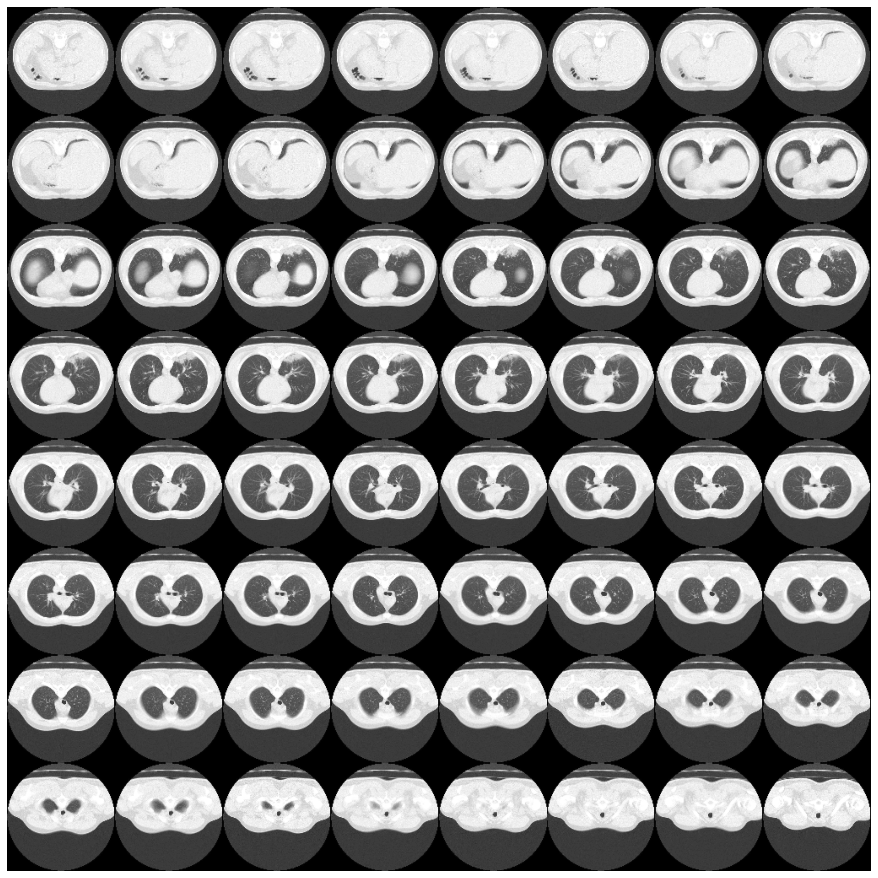

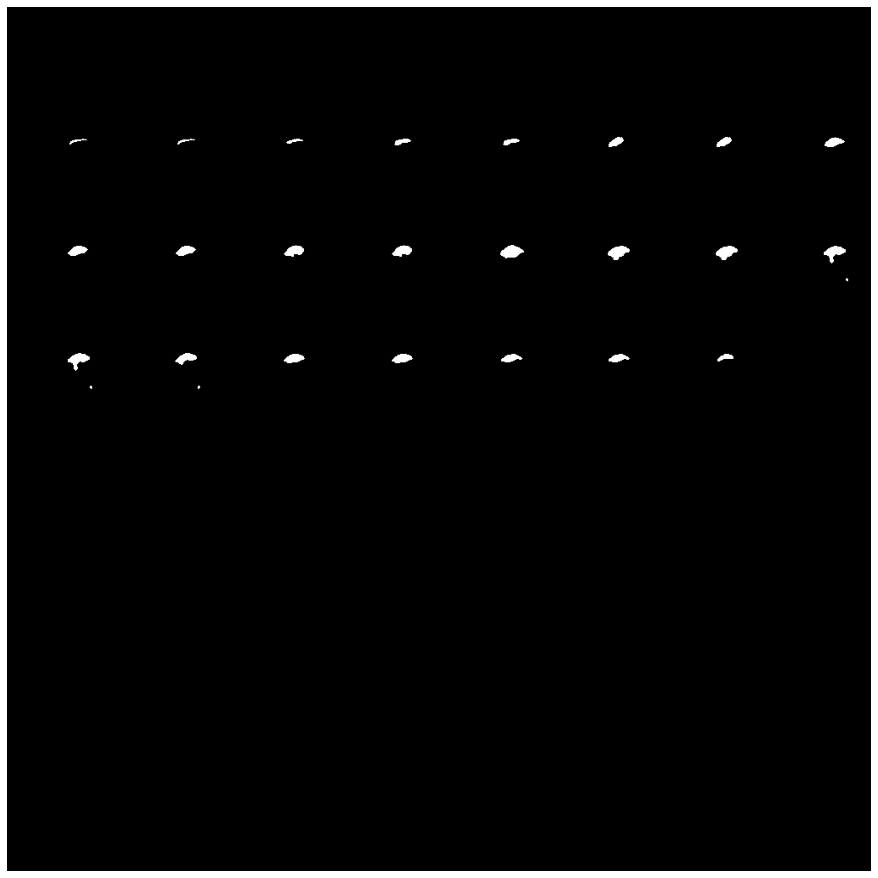

****************************************************************************************************


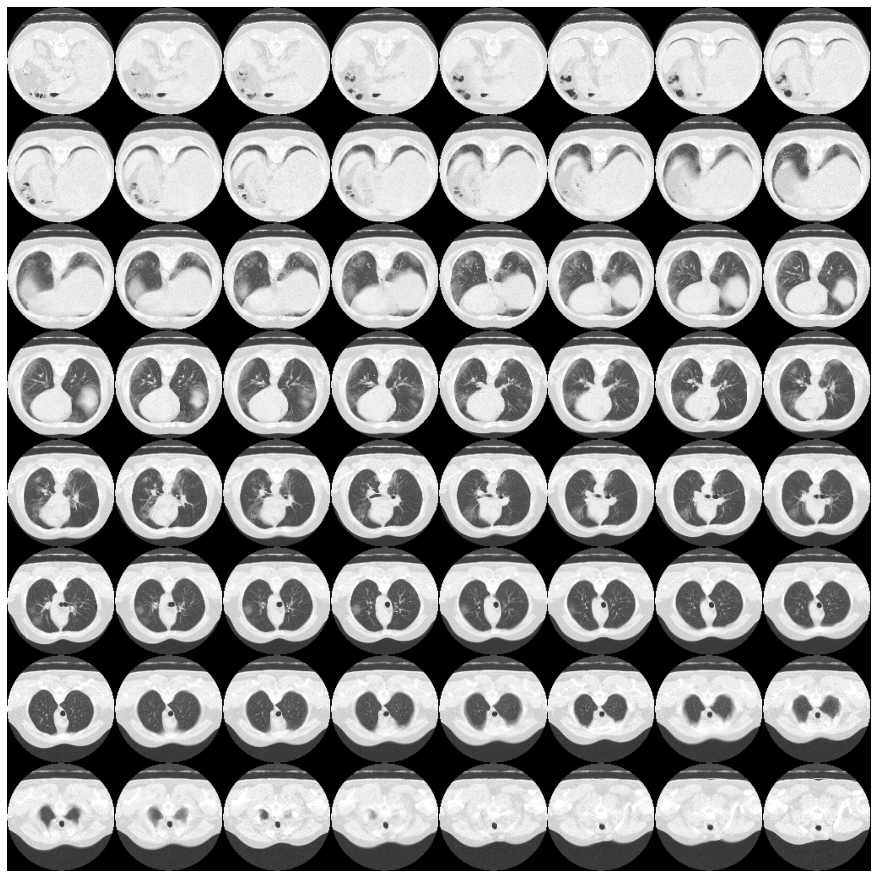

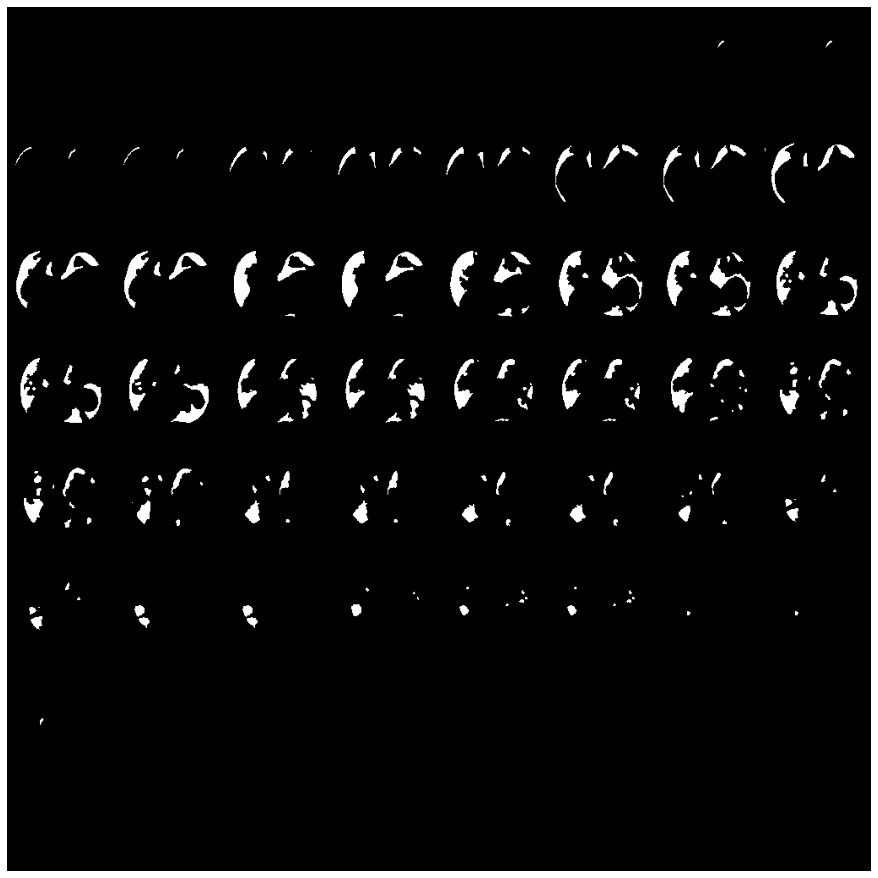

****************************************************************************************************


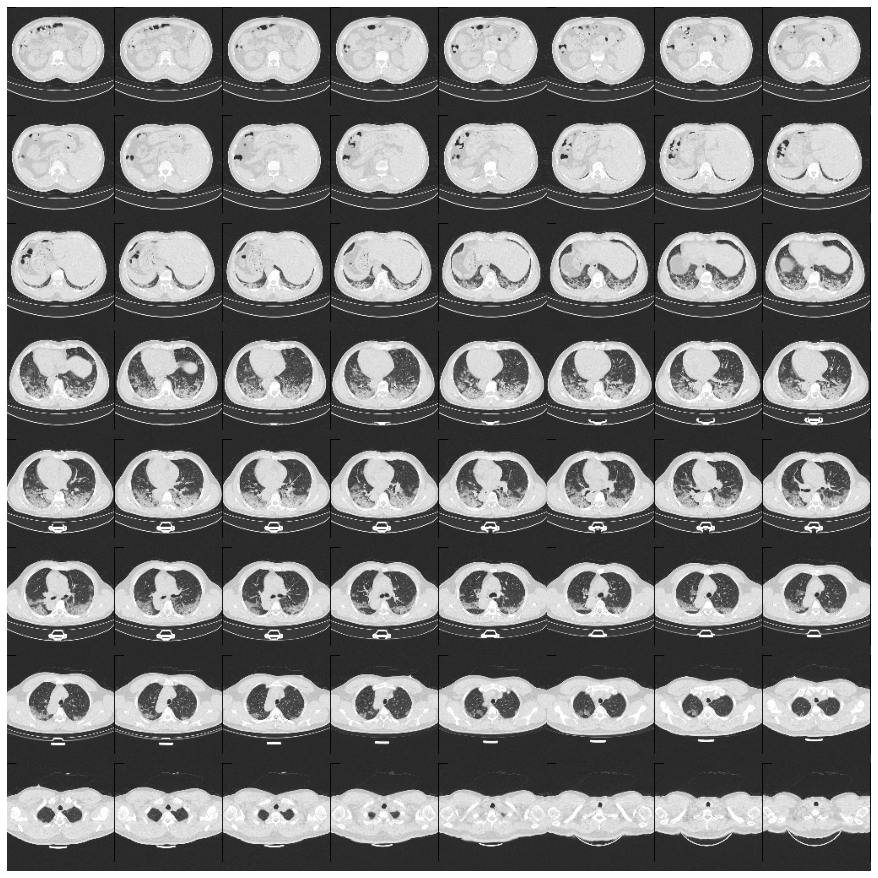

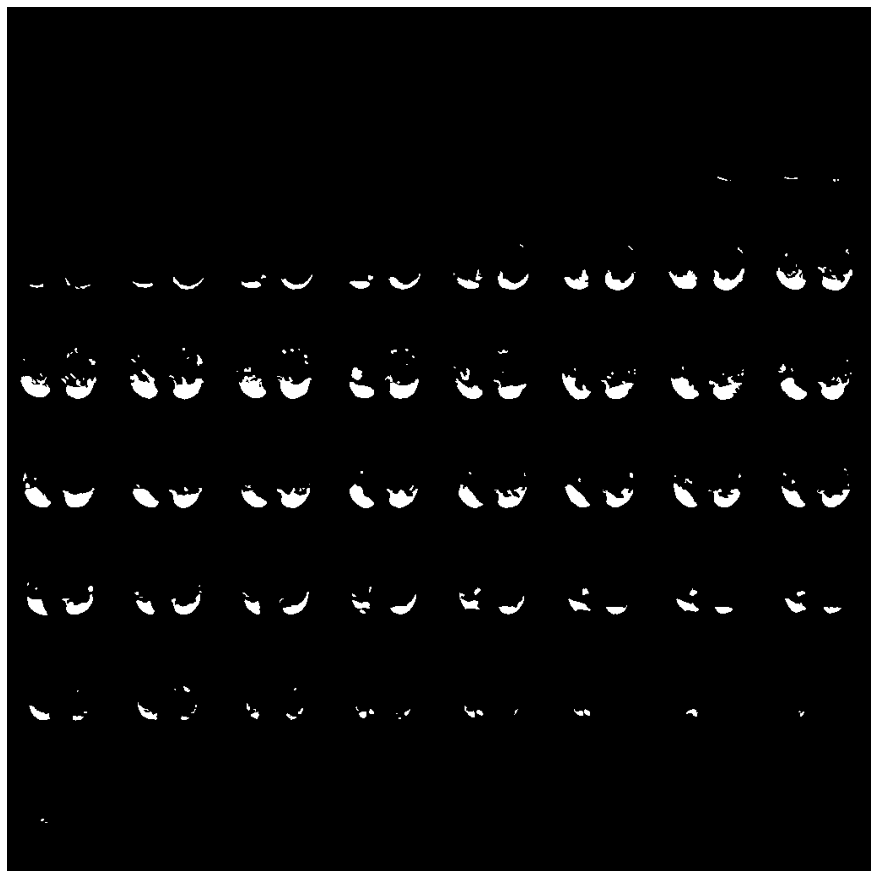

****************************************************************************************************


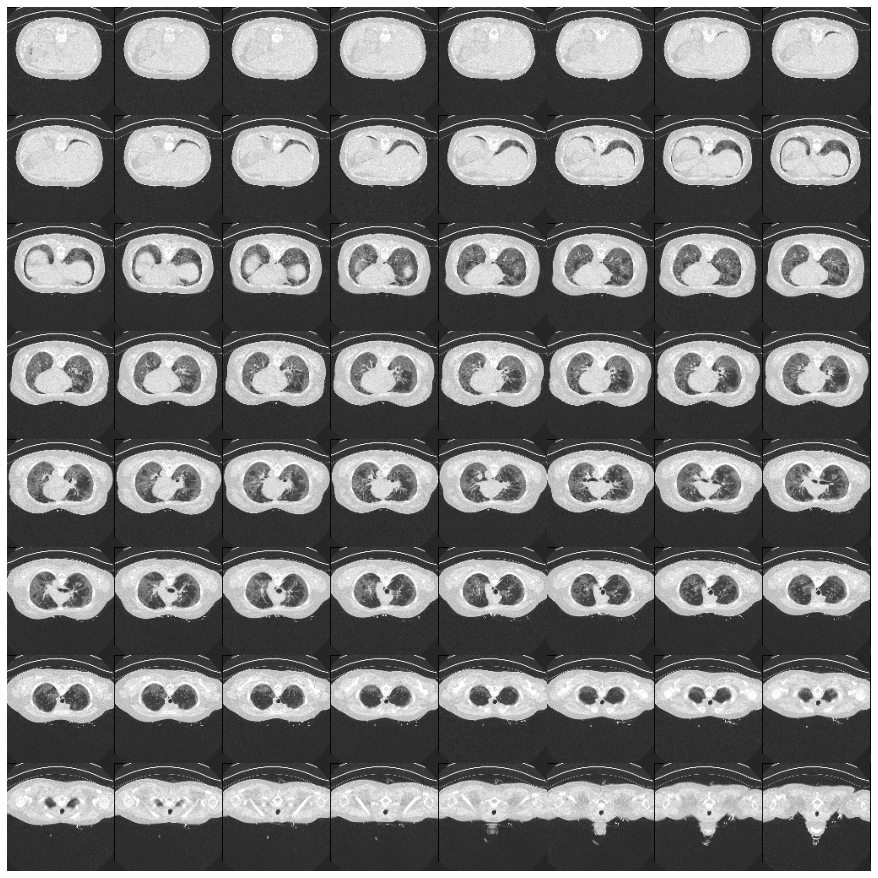

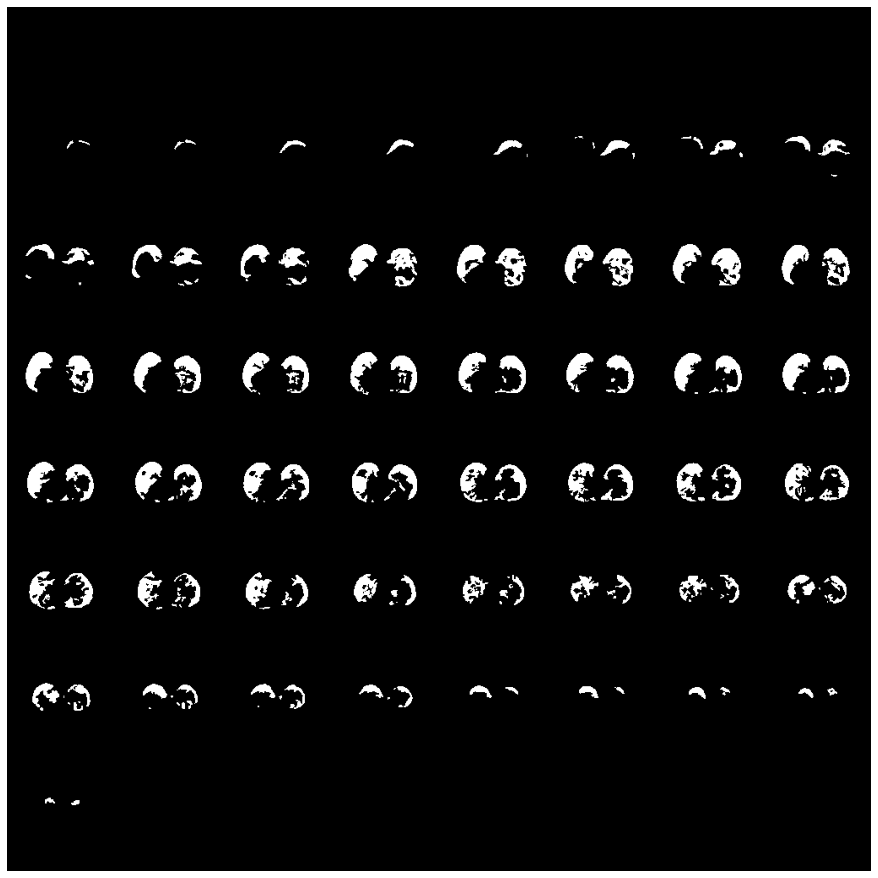

****************************************************************************************************


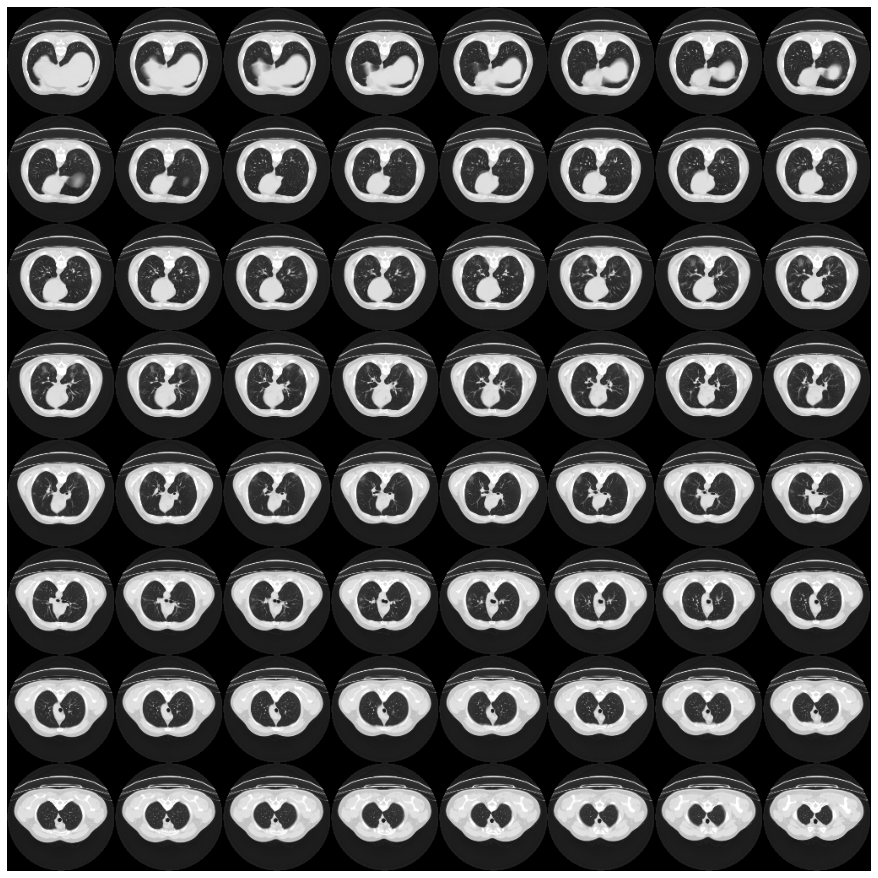

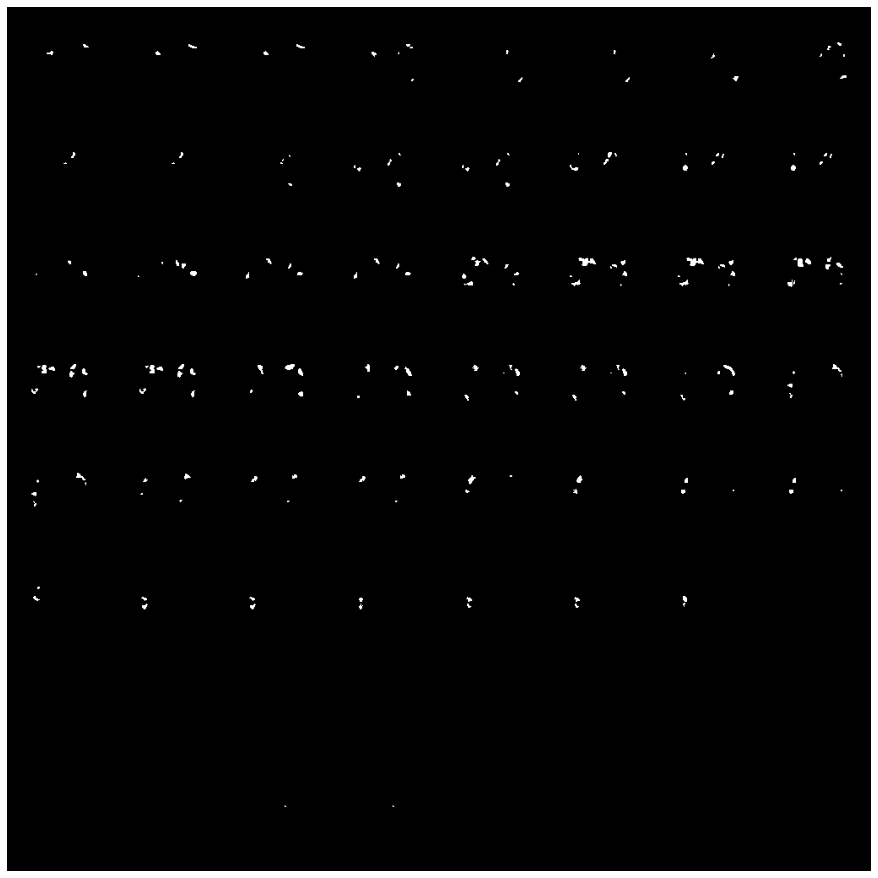

****************************************************************************************************


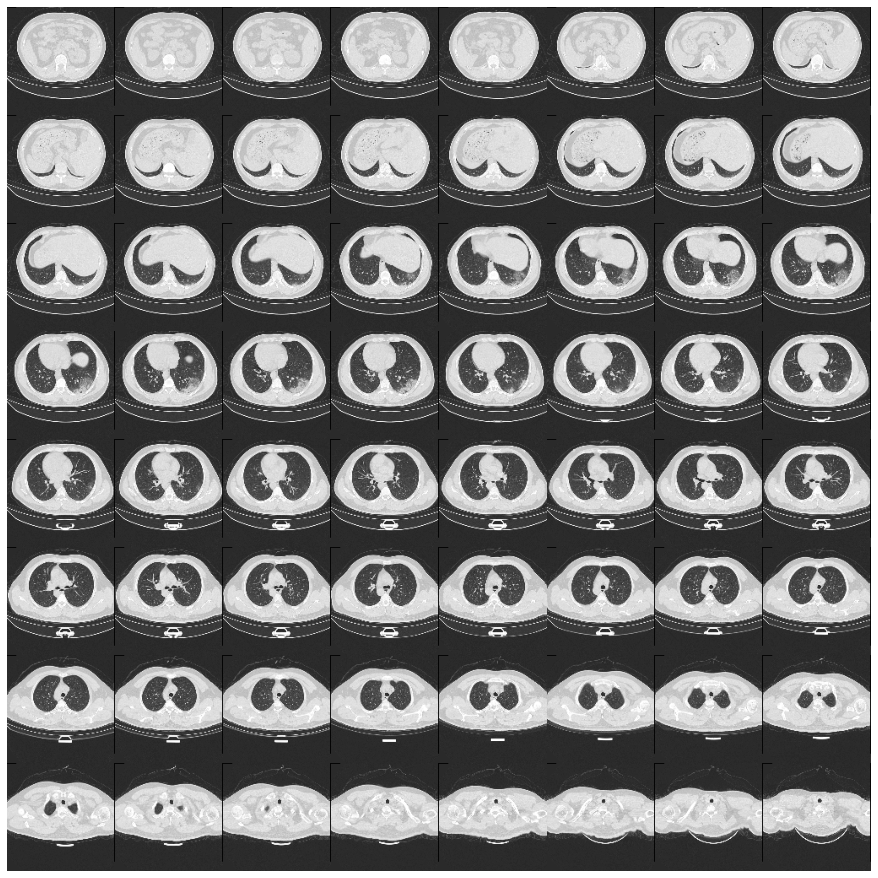

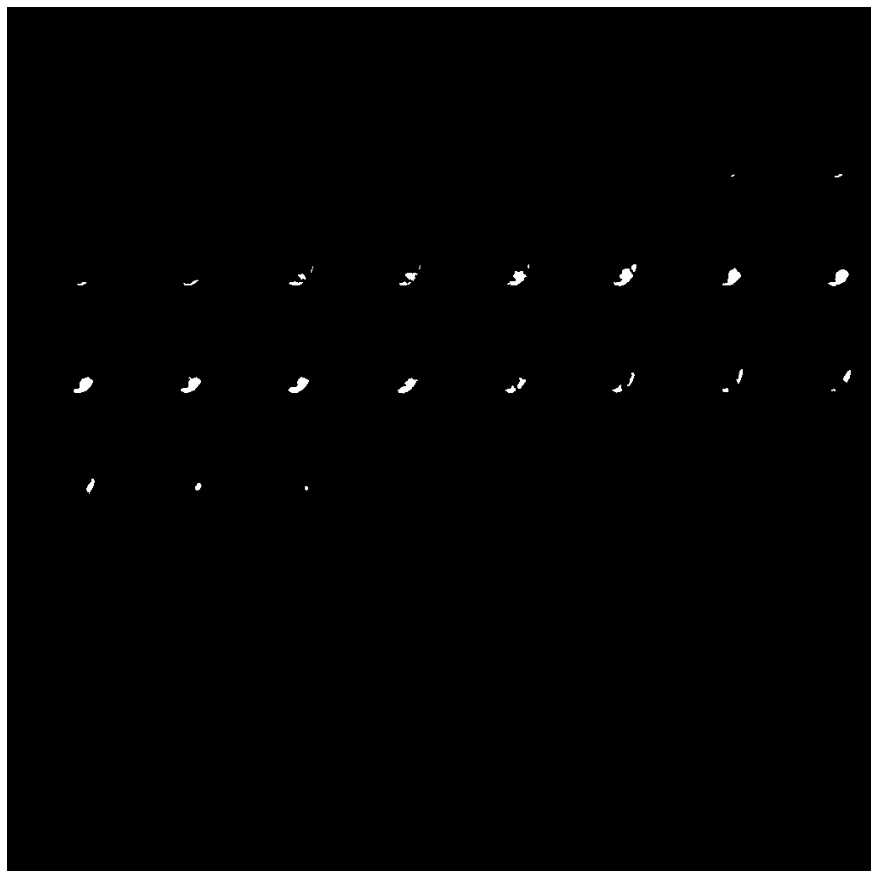

****************************************************************************************************


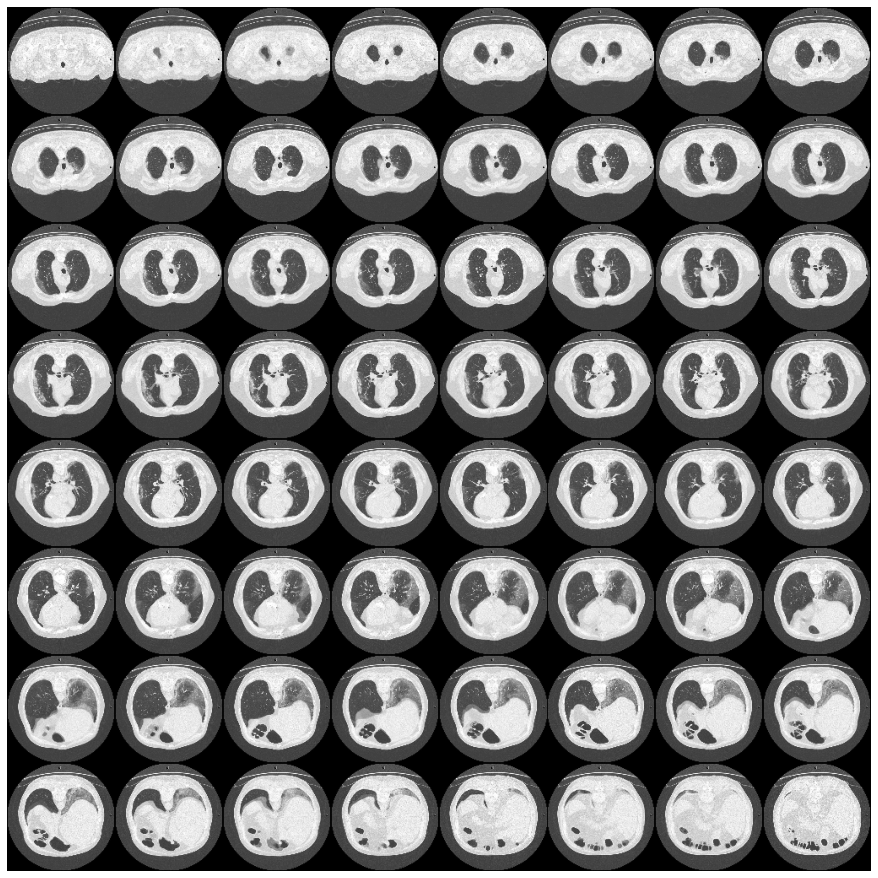

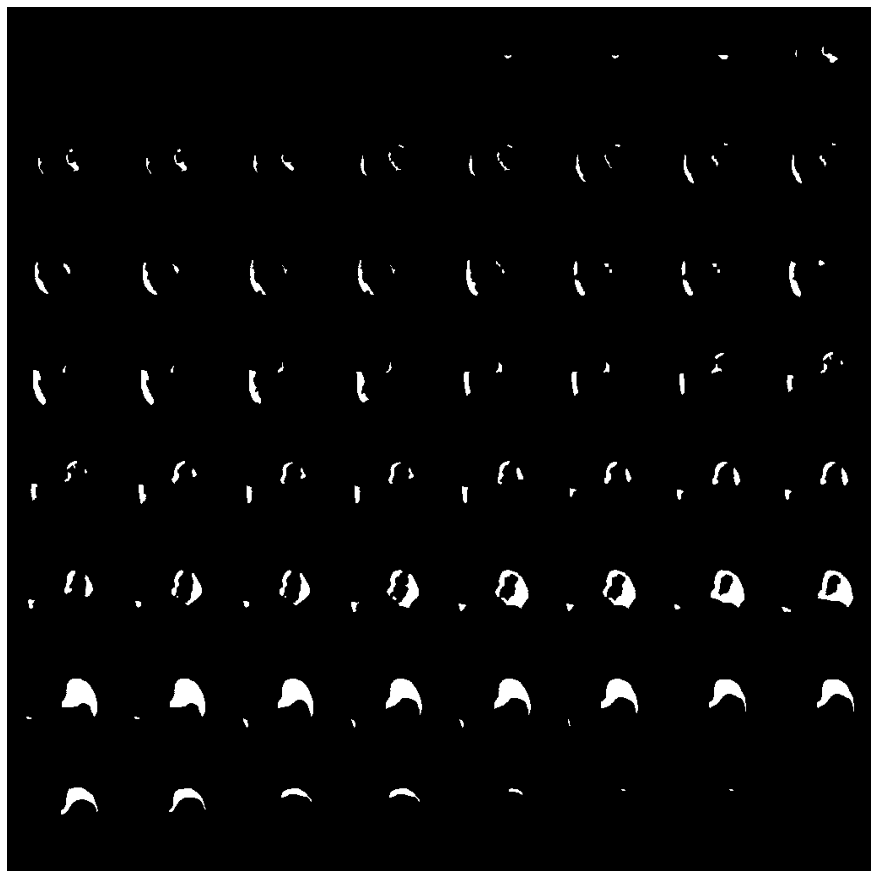

****************************************************************************************************


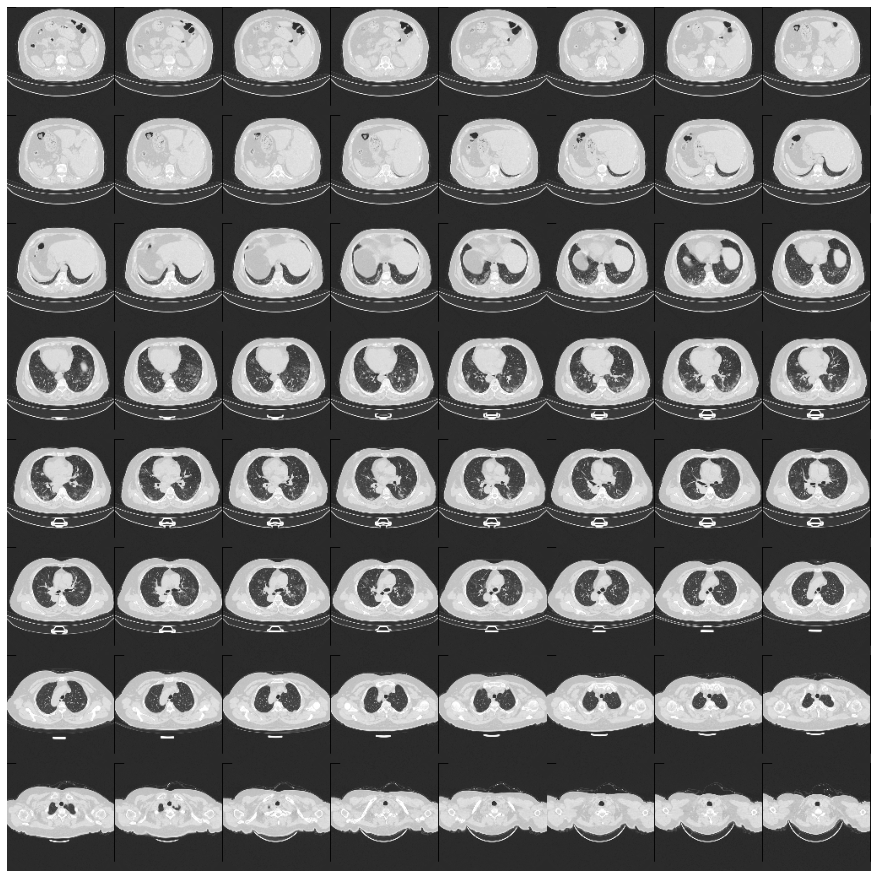

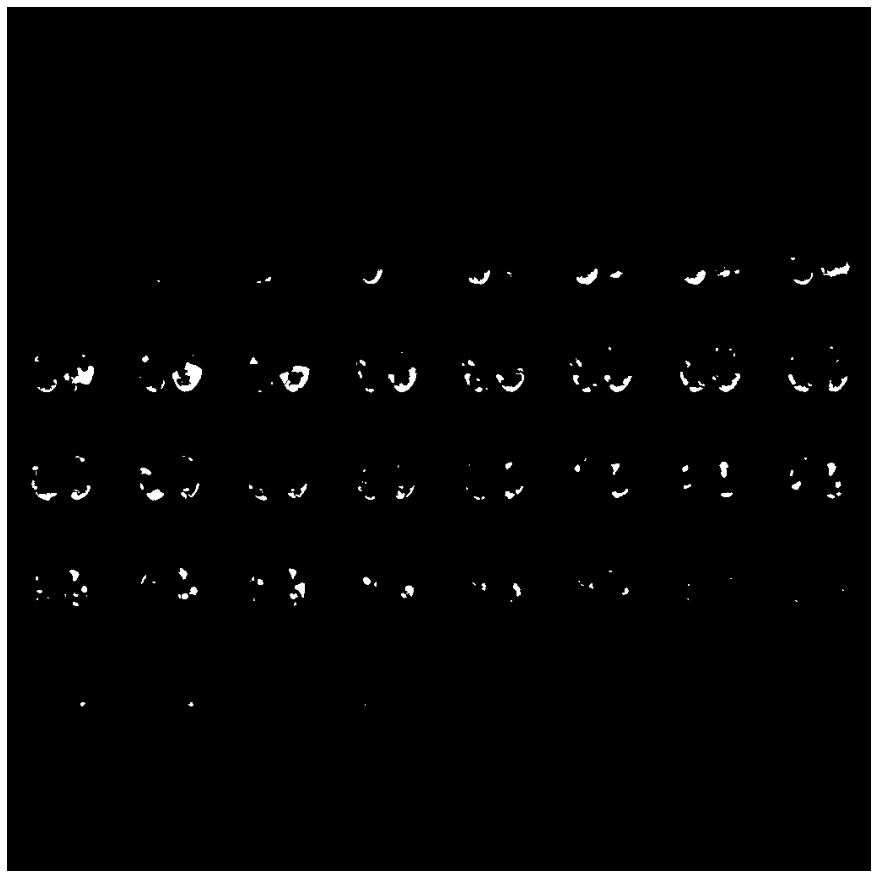

****************************************************************************************************


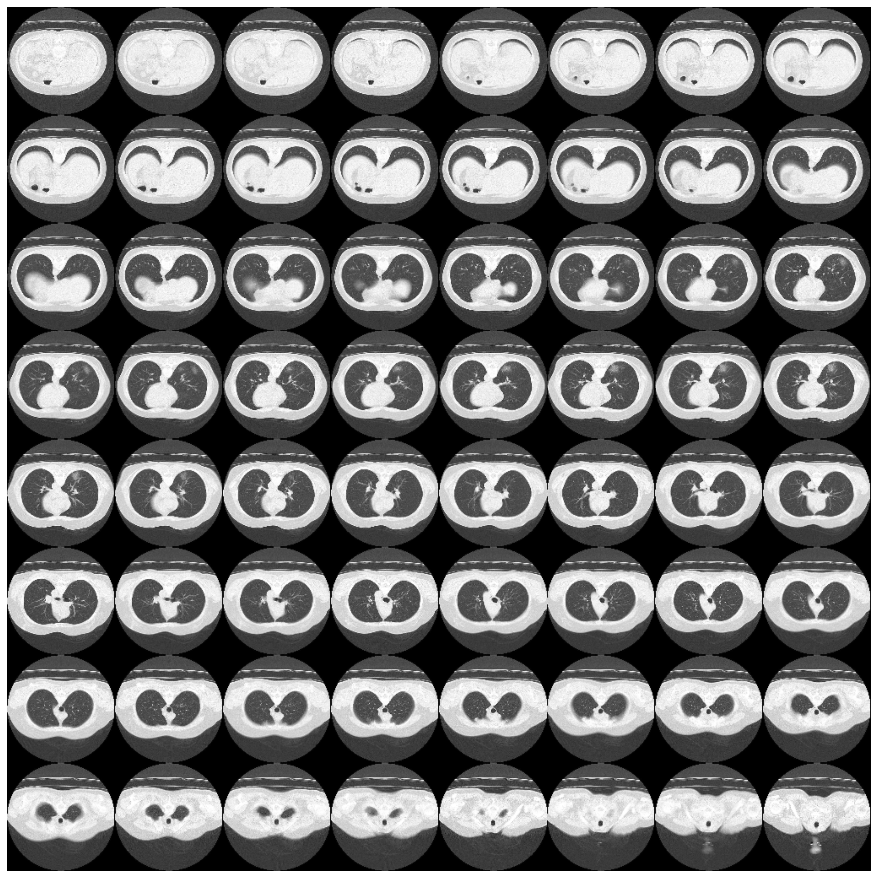

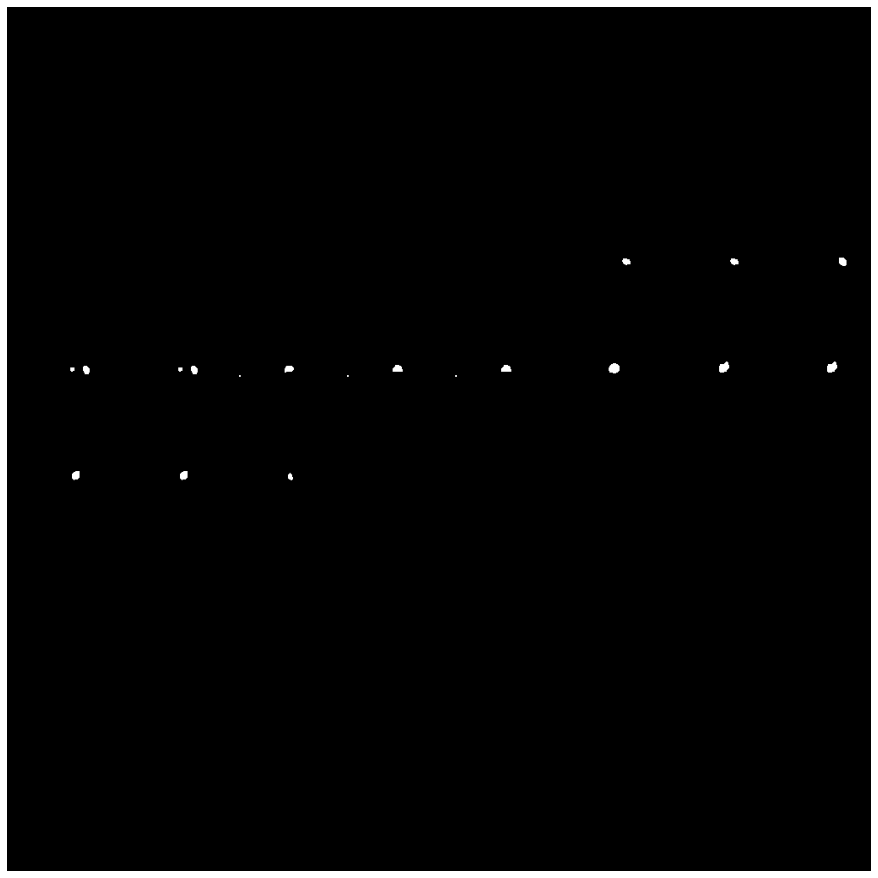

****************************************************************************************************


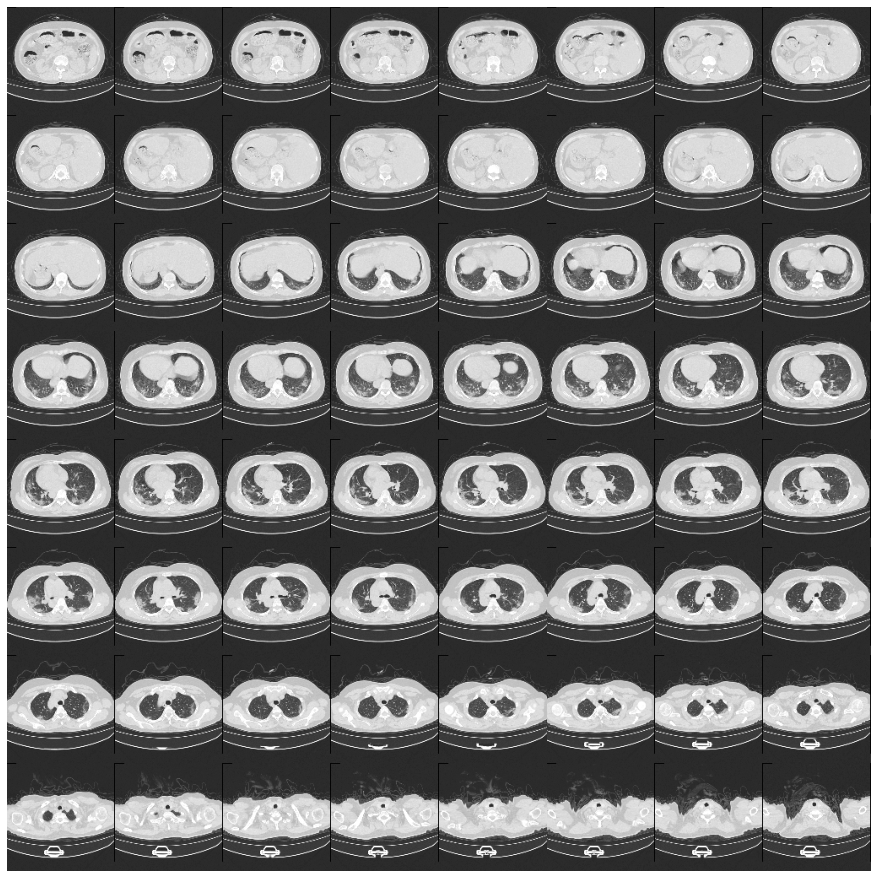

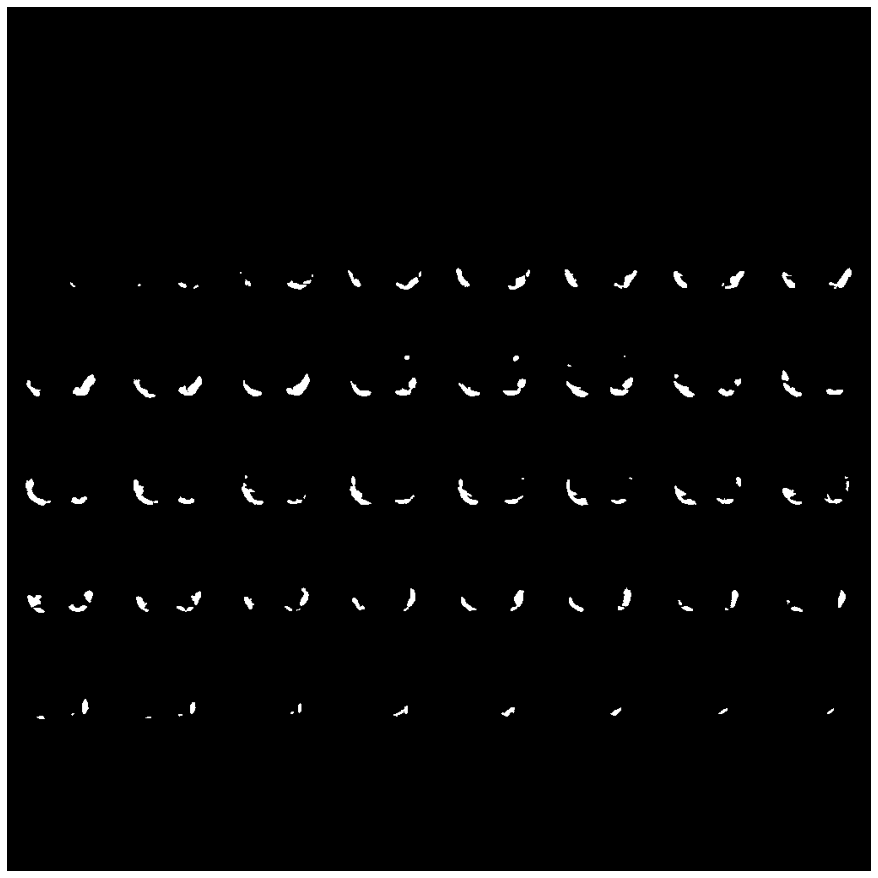

****************************************************************************************************


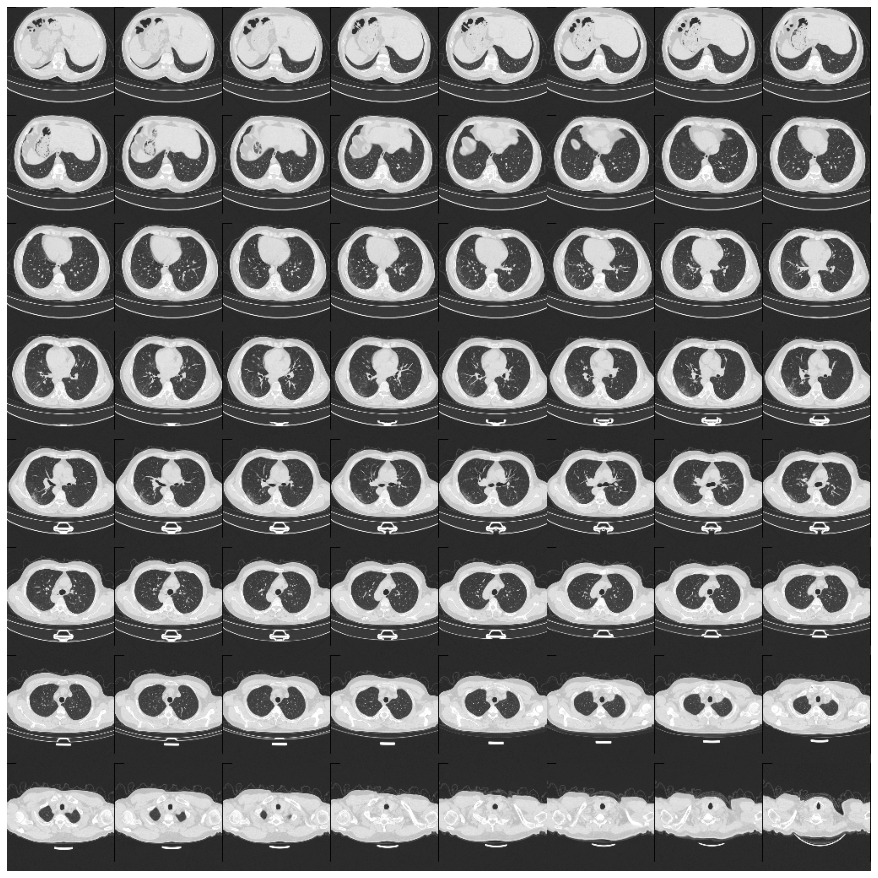

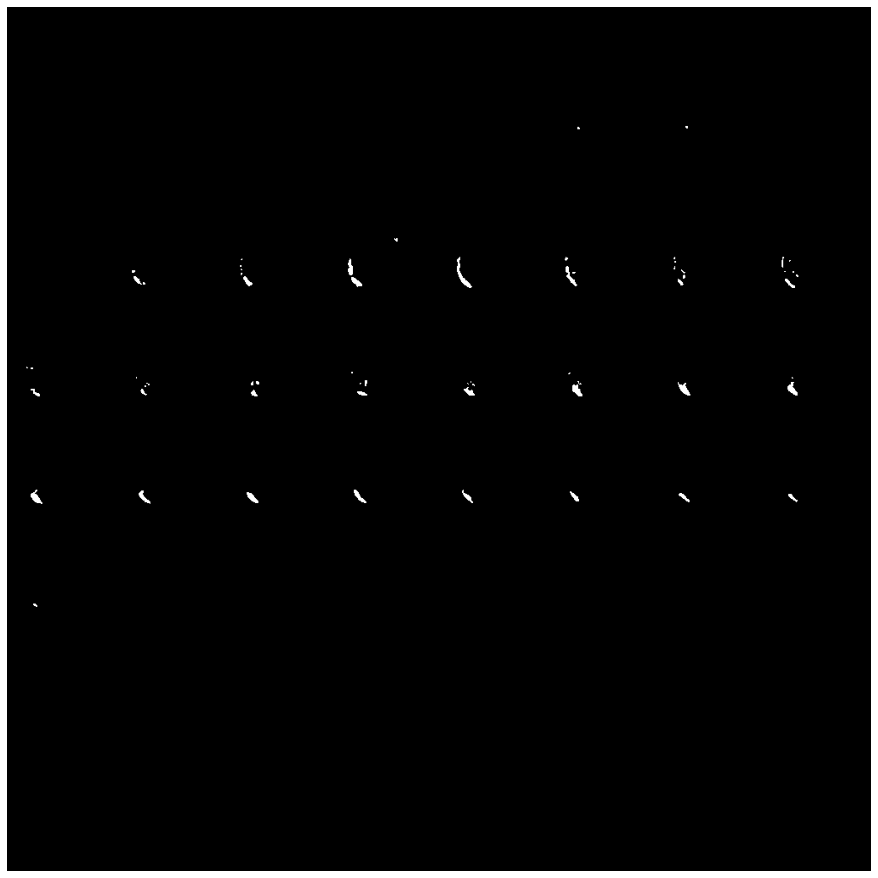

****************************************************************************************************


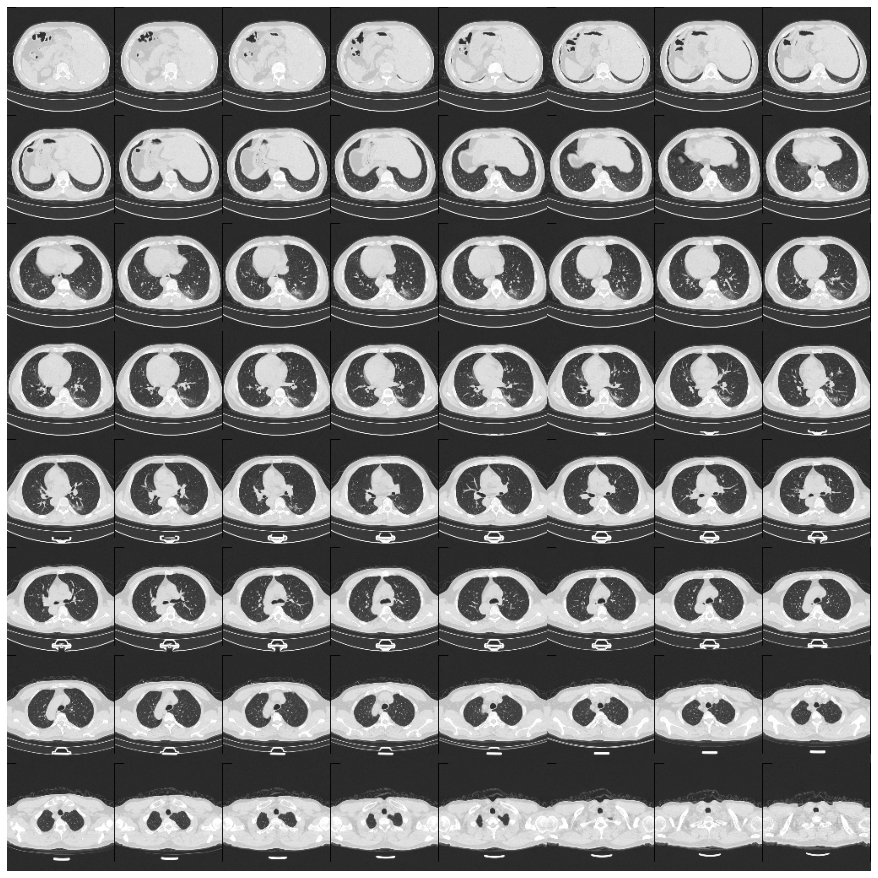

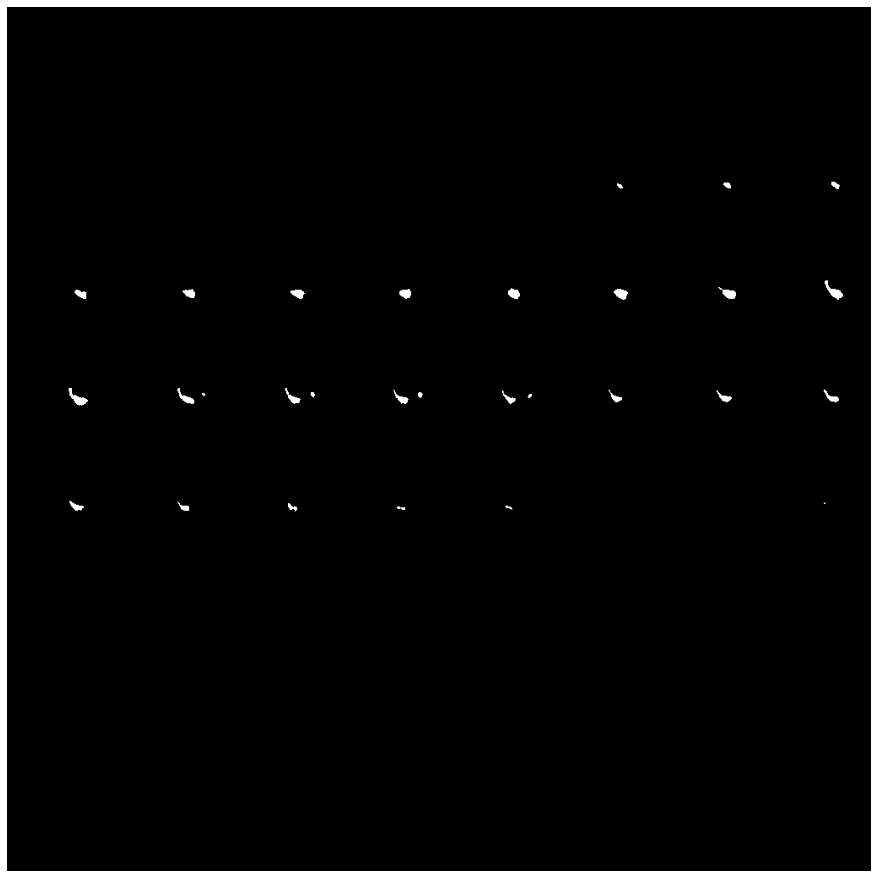

****************************************************************************************************


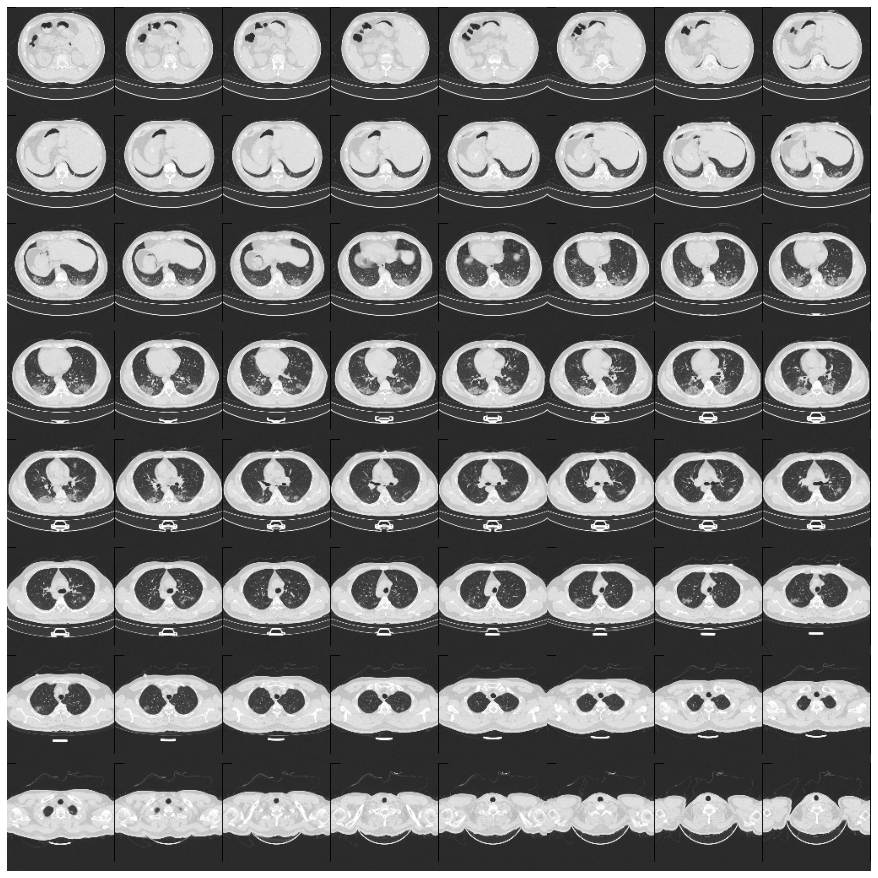

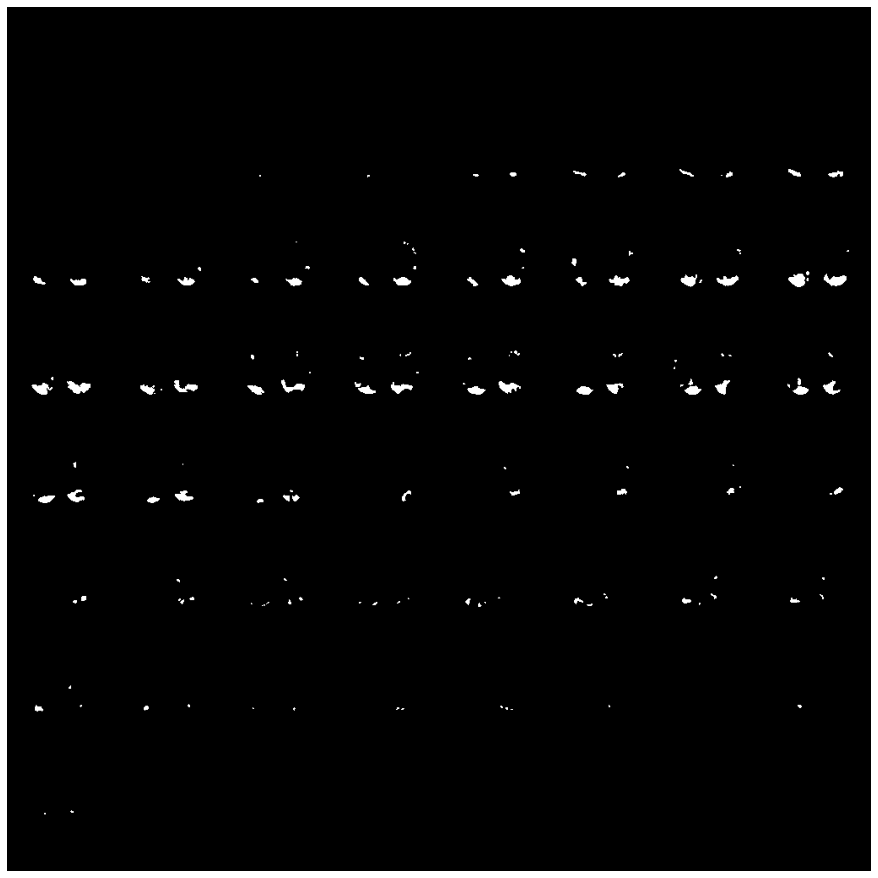

****************************************************************************************************


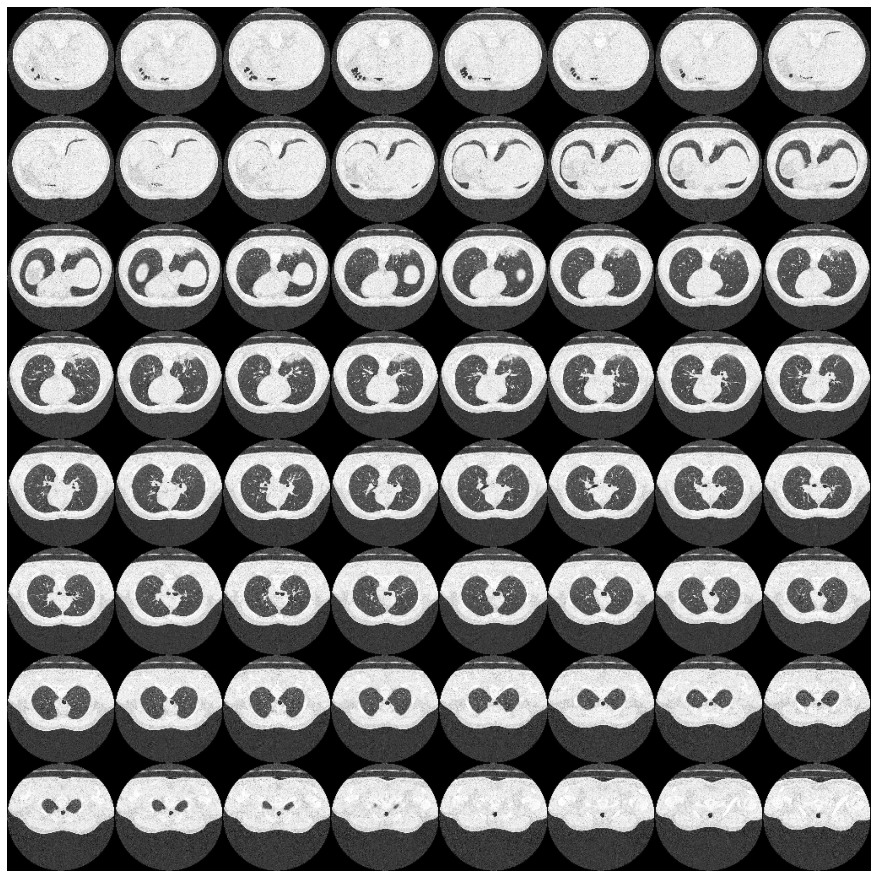

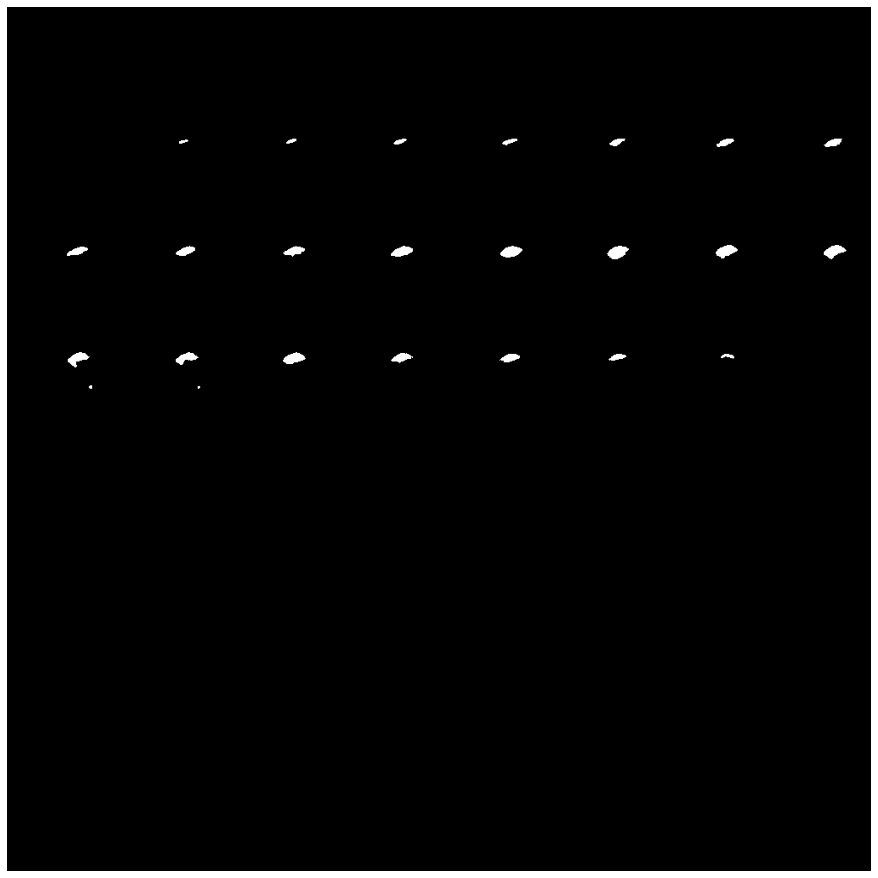

****************************************************************************************************


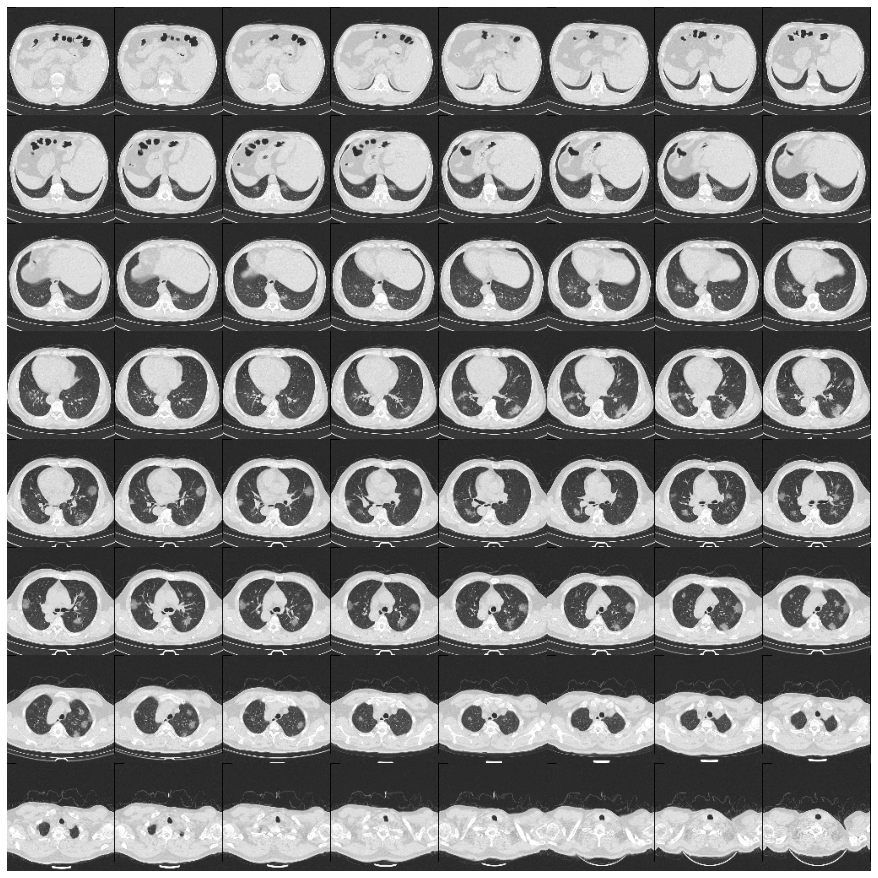

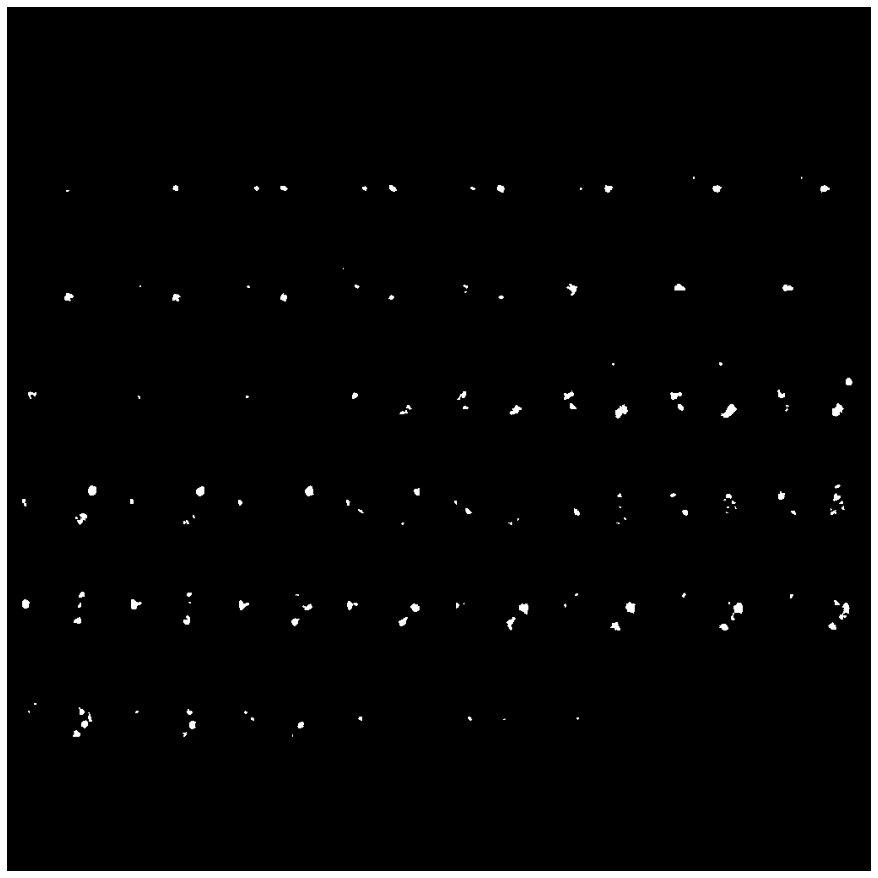

****************************************************************************************************


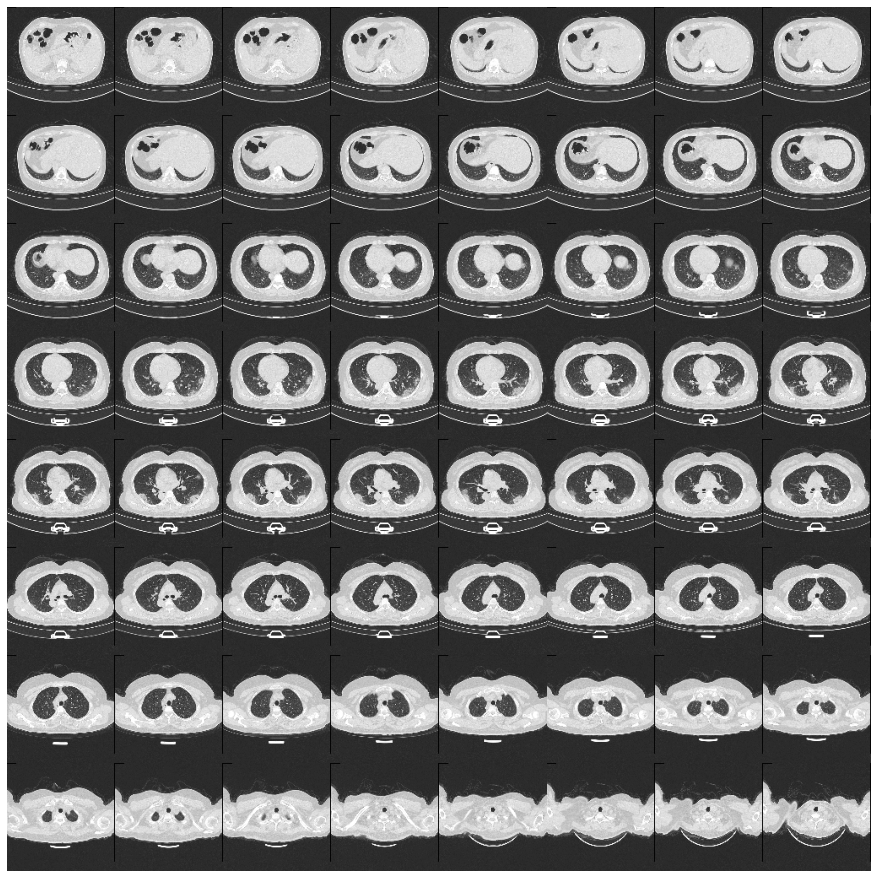

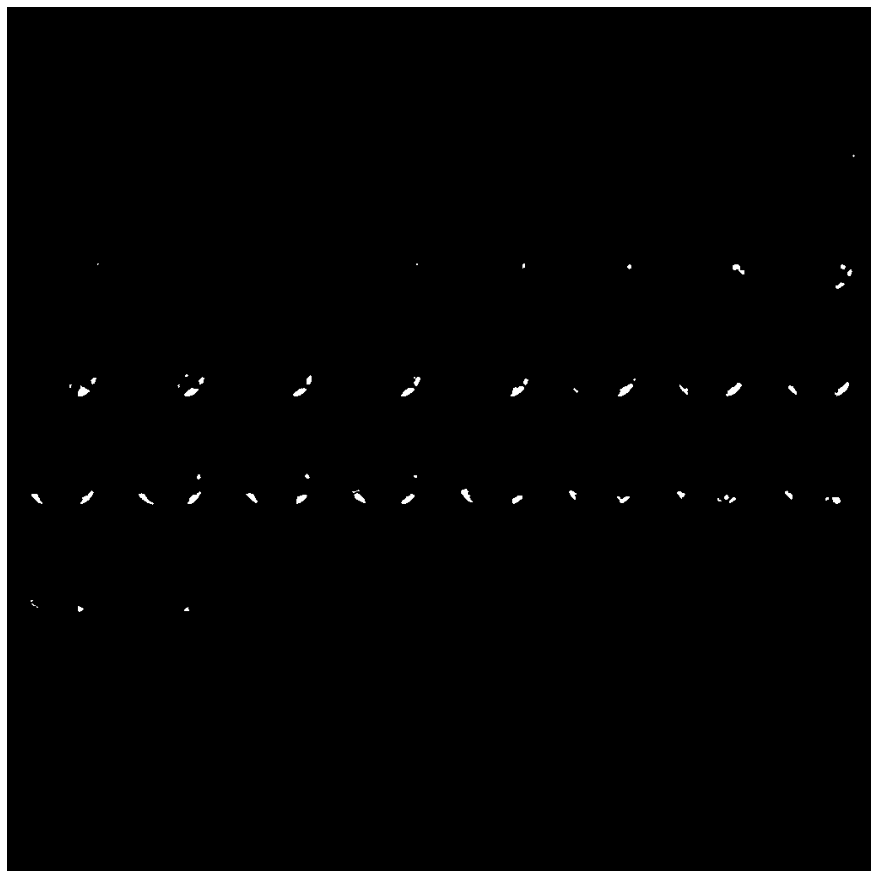

****************************************************************************************************


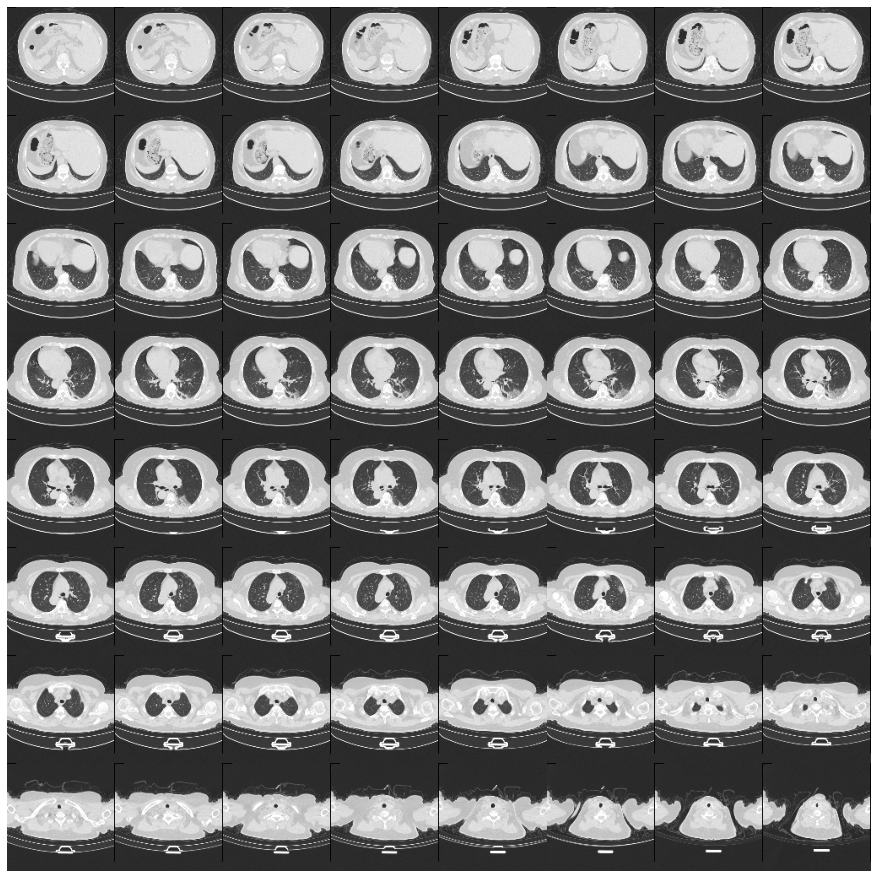

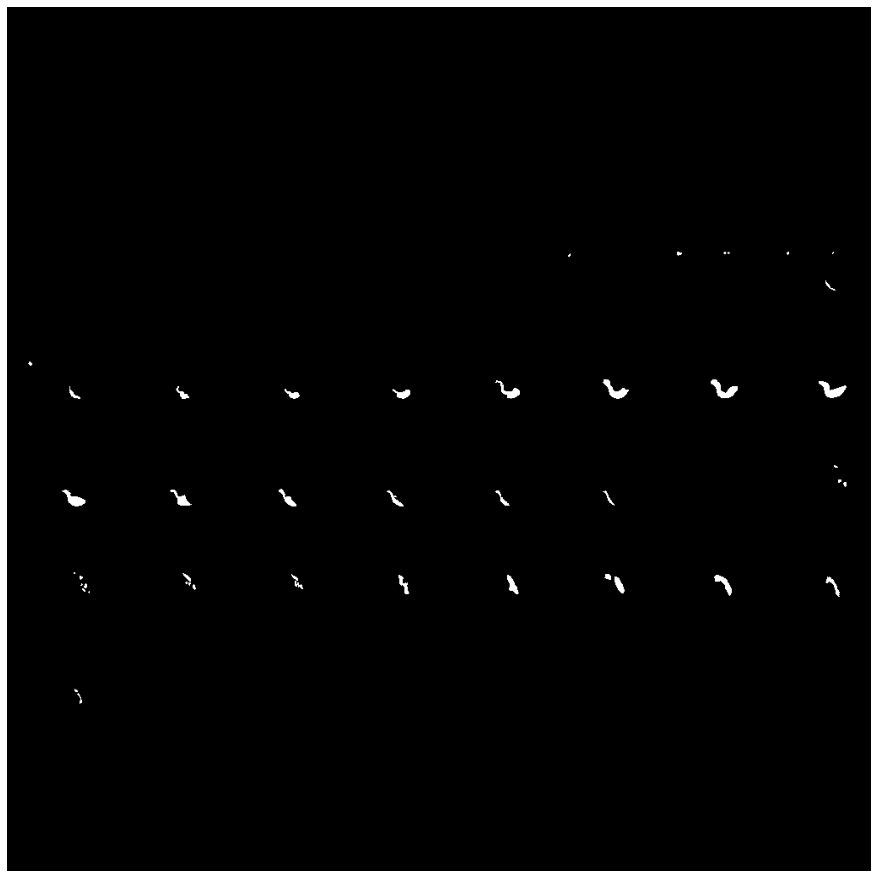

****************************************************************************************************


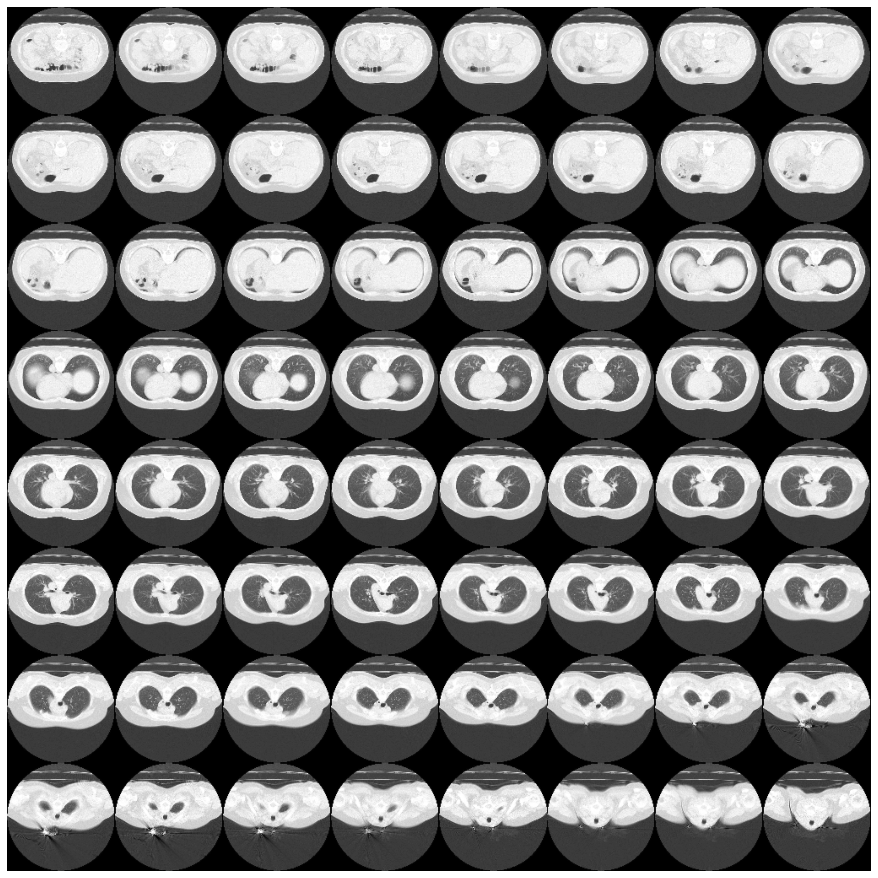

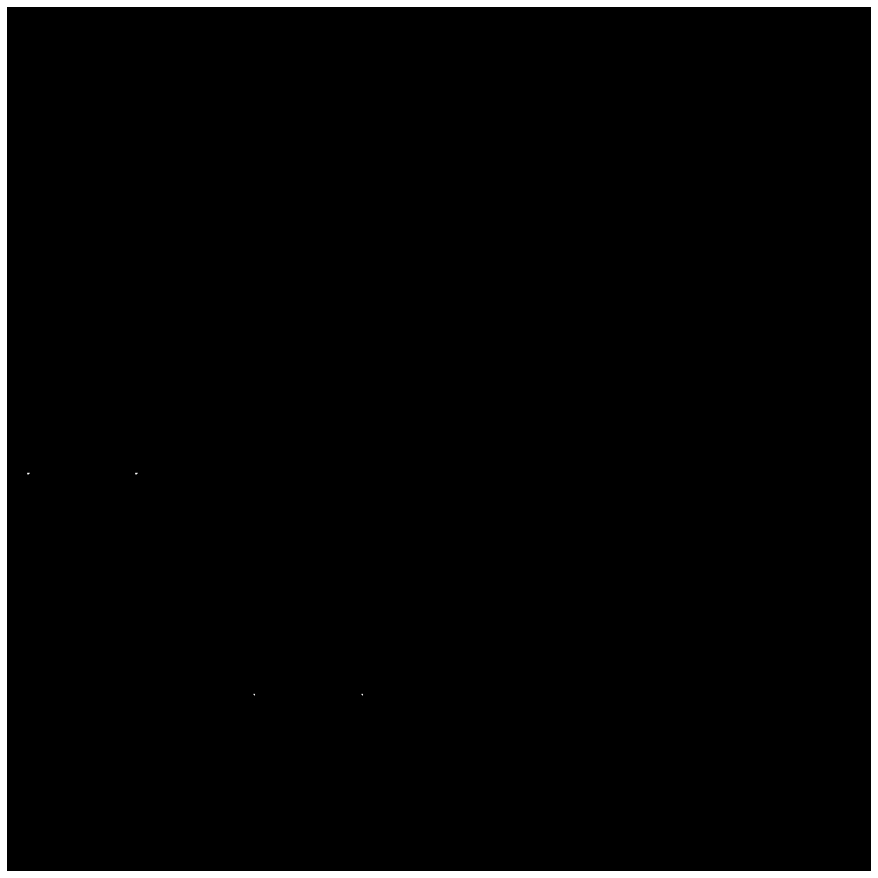

****************************************************************************************************


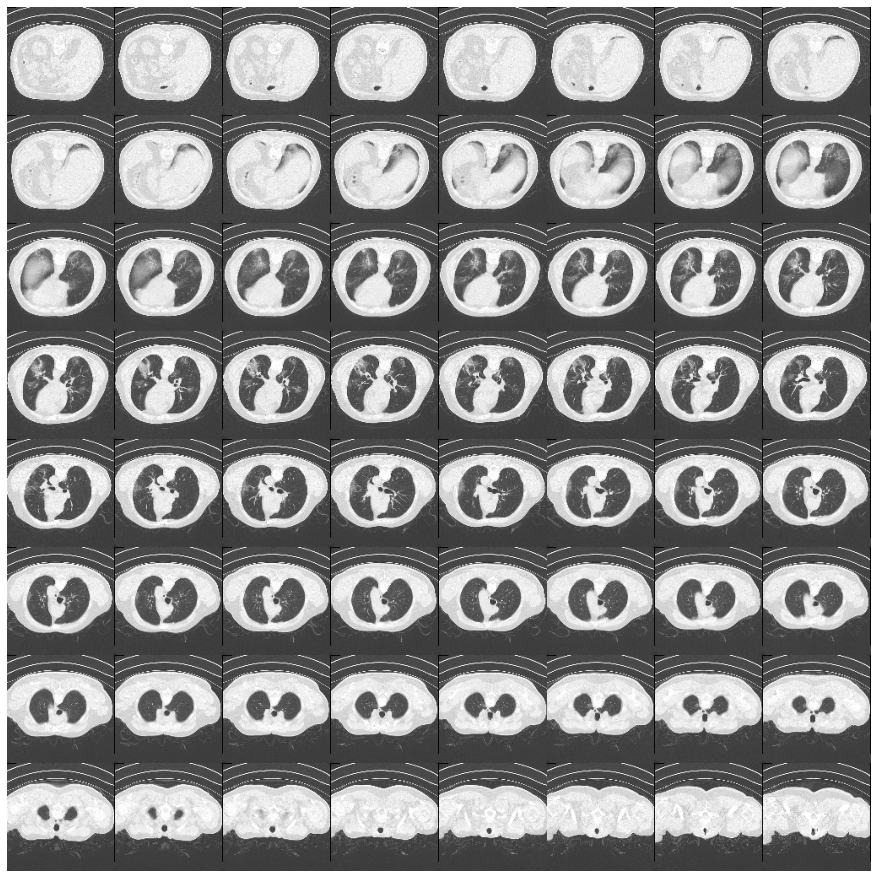

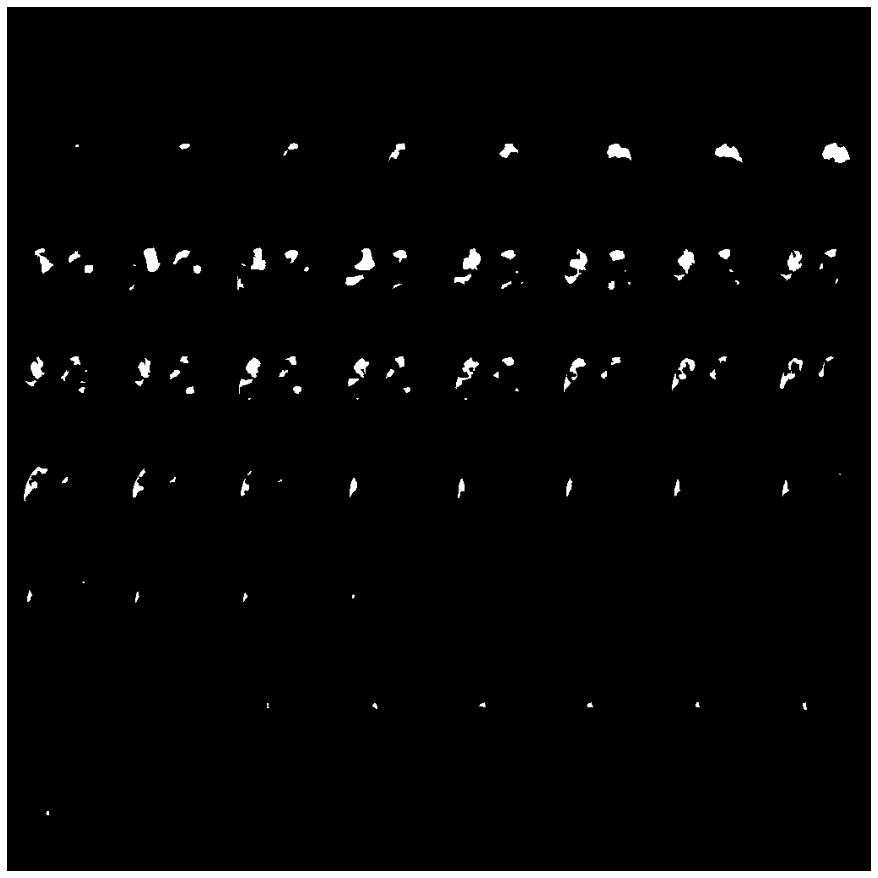

****************************************************************************************************


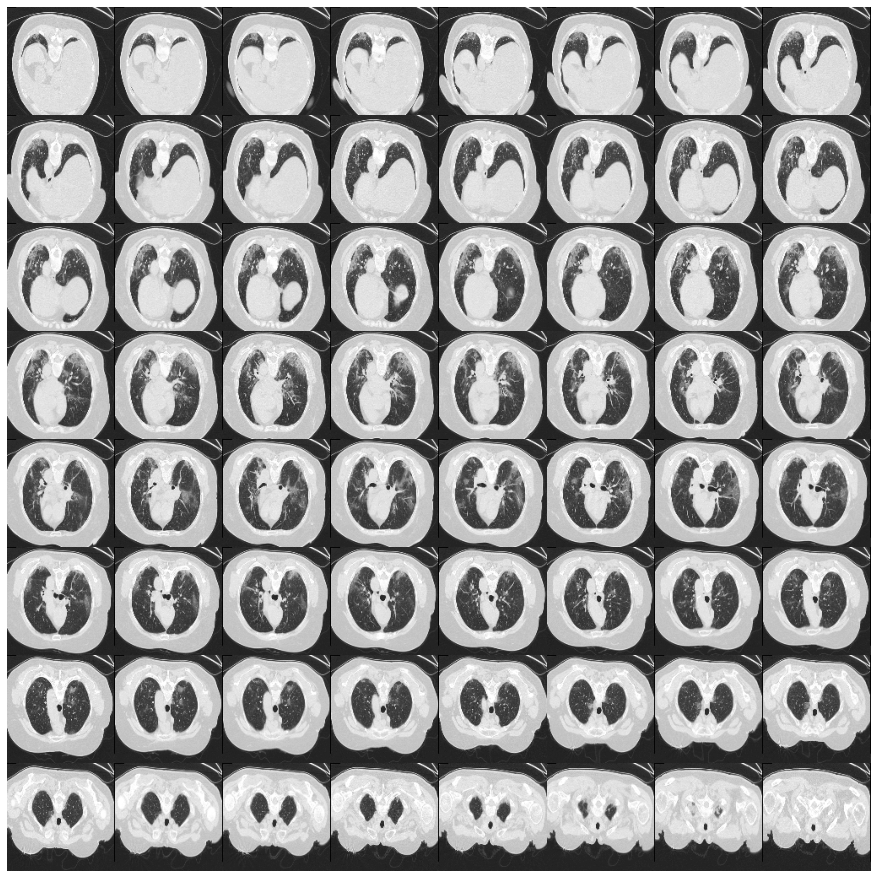

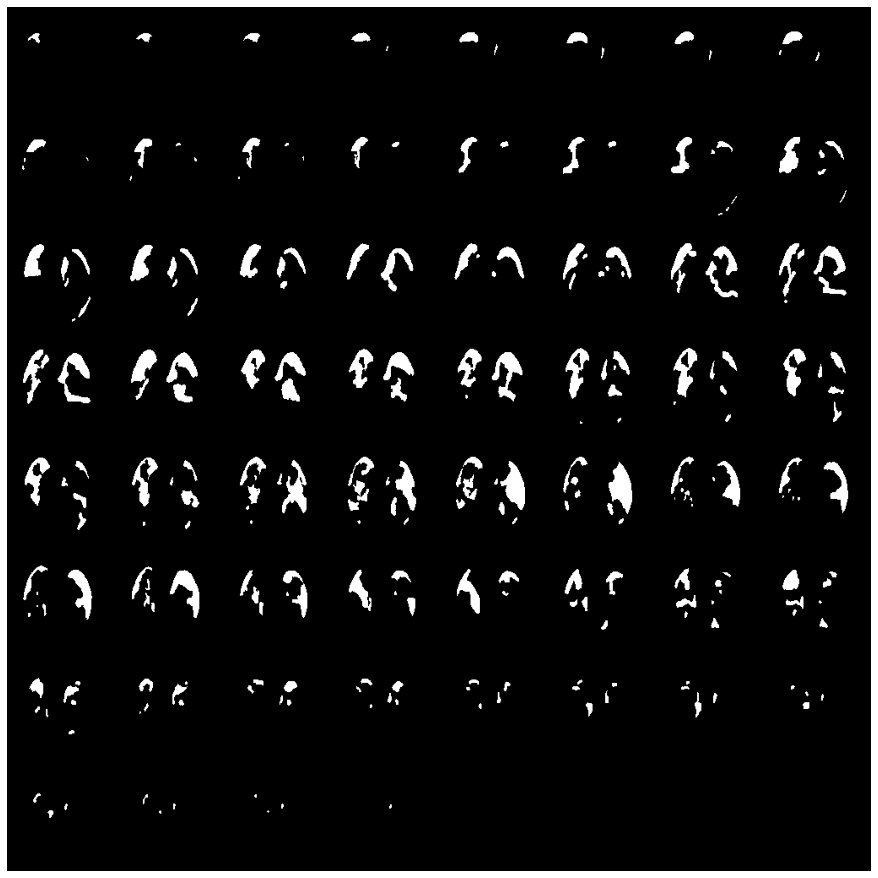

****************************************************************************************************


In [9]:
for i in range(20):
    plot_slices(8, 8, 128, 128, covid19s[i][:, :, :64])
    plot_slices(8, 8, 128, 128, covid19masks[i][:, :, :64])
    print("*"*100)

In [3]:
ct_metadata

,height,width,depth,path
0,630,630,39,radiopaedia_10_85902_1.nii.gz
1,630,630,39,radiopaedia_4_85506_1.nii.gz
2,512,512,200,coronacases_003.nii.gz
3,630,630,93,radiopaedia_40_86625_0.nii.gz
4,630,630,45,radiopaedia_36_86526_0.nii.gz
5,512,512,213,coronacases_006.nii.gz
6,630,630,45,radiopaedia_7_85703_0.nii.gz
7,512,512,301,coronacases_001.nii.gz
8,630,630,42,radiopaedia_29_86491_1.nii.gz
9,512,512,301,coronacases_010.nii.gz


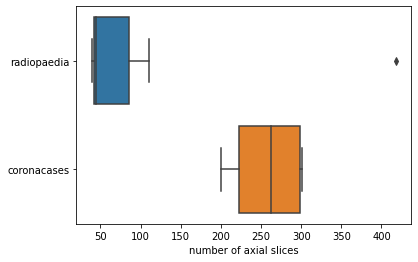

In [4]:
ax = sns.boxplot(data=ct_metadata, x=ct_metadata.depth, y=ct_metadata.path.str[0:11])
ax.set_ylabel("")
ax.set_xlabel("number of axial slices")
plt.show()

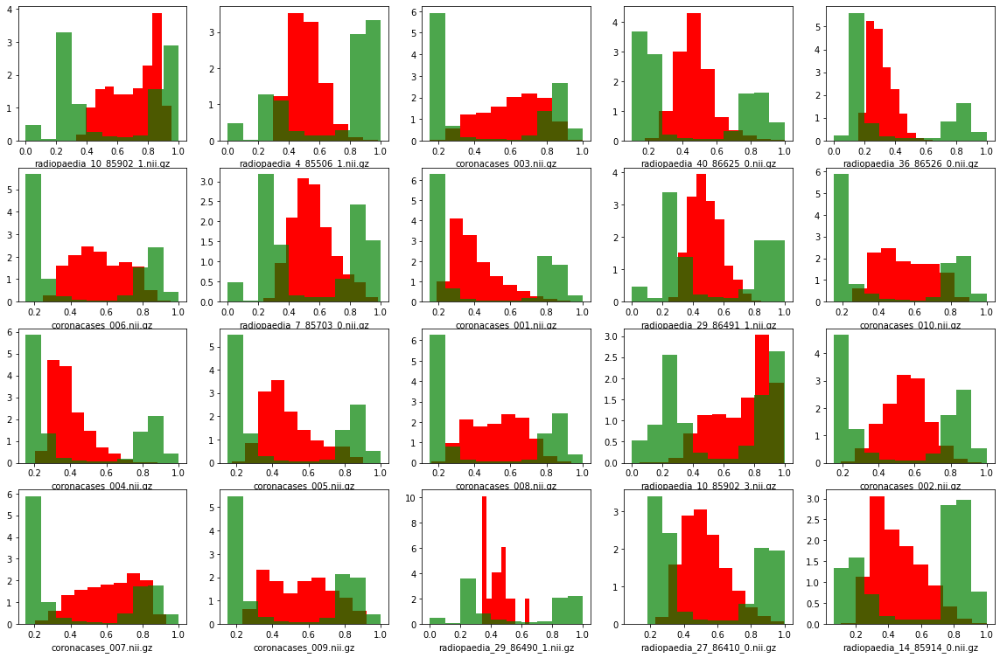

In [5]:
fig, axes = plt.subplots(ncols=5, nrows=4, constrained_layout=False, figsize=[20, 13])
j = 0
infectious_voxels = []
infectious_voxels_count = []
healthy_voxels = []
healthy_voxels_count = []
for i in range(20): 
    d1 = np.reshape(covid19s[i], -1)[np.flatnonzero(covid19s[i]*covid19masks[i])]
    d2 = np.reshape(covid19s[i], -1)[np.flatnonzero(covid19s[i] - covid19s[i]*covid19masks[i])]
    infectious_voxels.extend(d1)
    infectious_voxels_count.append(len(d1))
    healthy_voxels.extend(d2)
    healthy_voxels_count.append(len(d2))
    axes[i//5][j%5].hist(d1, color="red", density=True, alpha=1)
    axes[i//5][j%5].hist(d2, color="green", density=True, alpha=0.7)
    axes[i//5][j%5].set(xlabel=ct_metadata.path.values[i])
    j += 1
plt.show()

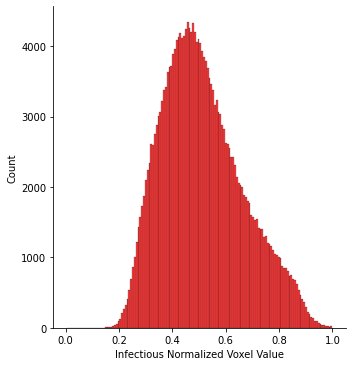

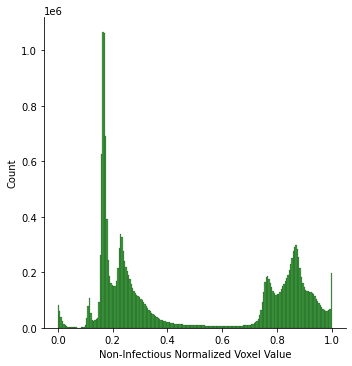

In [6]:
ax1 = sns.displot(infectious_voxels, color="red")
ax1.set(xlabel="Infectious Normalized Voxel Value", ylabel="Count")
ax2 = sns.displot(healthy_voxels, color="green")
ax2.set(xlabel="Non-Infectious Normalized Voxel Value", ylabel="Count")
plt.show()

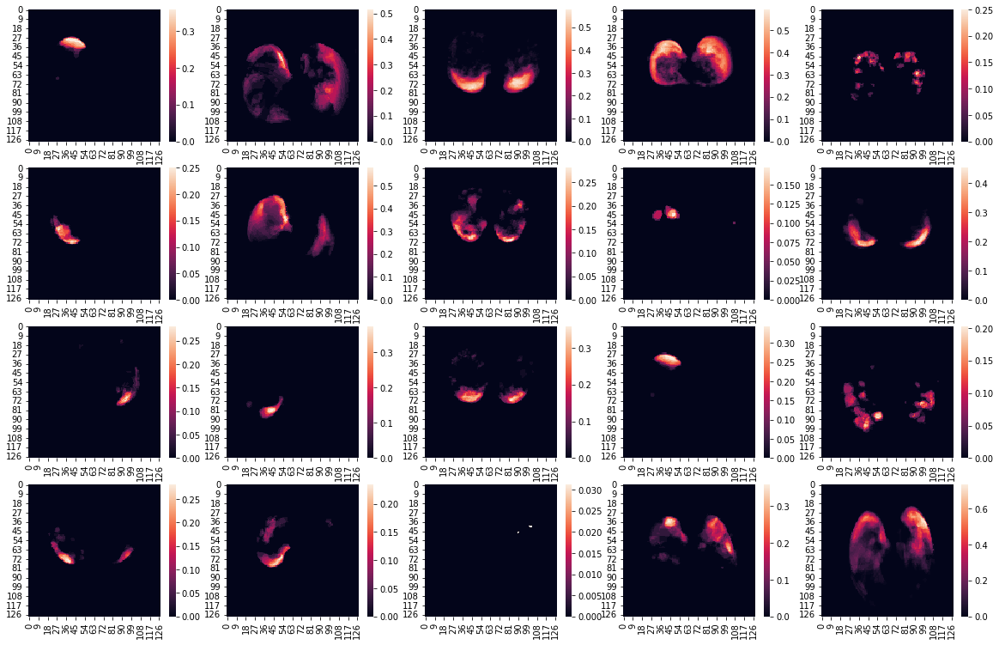

In [7]:
fig, axes = plt.subplots(ncols=5, nrows=4, constrained_layout=False, figsize=[20, 13])
data = []
for i in range(20): 
    d = np.sum(covid19masks[i][:, :, :64], axis=(2)) / 64
    data.append(d)
    sns.heatmap(d, ax=axes[i//5][i%5])
plt.show()

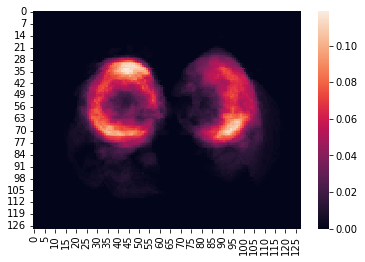

In [8]:
heat_map_compressed_statistics = np.sum(np.array(data), axis=0) / 20
sns.heatmap(heat_map_compressed_statistics)
plt.show()

In [3]:
covid19s = np.array(covid19s, dtype=np.float32)
covid19masks = np.array(covid19masks, dtype=np.int8)

Experiments

In [4]:
def DSC(mask_gt, mask_pred):
    return 1 - DSCL(mask_gt, mask_pred) 

def DSCL(mask_gt, mask_pred):
    mask_gt = tf.cast(mask_gt, dtype=tf.float32)
    nominator = 2 * tf.reduce_sum(mask_gt * mask_pred)
    denominator = tf.reduce_sum(tf.pow(mask_gt, 2)) + tf.reduce_sum(tf.pow(mask_pred, 2))
    return 1 - nominator / denominator

def SGD():
    optimizer = keras.optimizers.SGD(learning_rate=0.01, momentum=0.99, nesterov=True)
    return optimizer

def get_dataset(train_data, valid_data):
    tf.random.set_seed(2021)
    def preprocessing(index):
        """adding a channel."""
        volume = covid19s[index]
        mask = covid19masks[index]
        volume = tf.expand_dims(volume, axis=3)
        mask = tf.expand_dims(mask, axis=3)
        return volume, mask
    train_dataset = tf.data.Dataset.from_tensor_slices(train_data)
    validation_dataset = tf.data.Dataset.from_tensor_slices(valid_data)
    batch_size = 2
    train_dataset = (
        train_dataset.shuffle(16)
        .map(lambda x: tf.py_function(func=preprocessing, inp=[x], Tout=[tf.float32, tf.int8]))
        .batch(batch_size, num_parallel_calls=tf.data.AUTOTUNE, deterministic=True)
        .prefetch(batch_size)
    )
    validation_dataset = (
        validation_dataset.shuffle(16)
        .map(lambda x: tf.py_function(func=preprocessing, inp=[x], Tout=[tf.float32, tf.int8]))
        .batch(batch_size, num_parallel_calls=tf.data.AUTOTUNE, deterministic=False)
        .prefetch(batch_size)
    )
    return train_dataset, validation_dataset

def get_model_checkpoint_cb(filepath, monitor="val_DSC", mode="max"):
    checkpoint_cb = tf.keras.callbacks.ModelCheckpoint(
        filepath, monitor=monitor, verbose=0, save_best_only=True,
        save_weights_only=True, mode=mode, save_freq="epoch"
    )
    return checkpoint_cb

def save_history_to_disk(histories, path, n=5):
    flag = False
    for i in range(n):
        hist = histories[i].history
        hist["group_number"] = [i]*len(hist["loss"])
        if not flag:
            df = pd.DataFrame(hist)
            flag = True
        else:
            df = df.append(pd.DataFrame(hist))
    df.reset_index(inplace=True)
    df.to_csv(path, index=False)
    return df

In [5]:
def BCL(x, n_filter, max_pool=False, dilation_rate=1):
    if max_pool:
        x = layers.MaxPool3D(padding="same")(x)
    x = layers.Conv3D(
        n_filter, (3, 3, 3),
        kernel_initializer='he_normal',
        padding="same",
        strides=(1, 1, 1)
    )(x)
    x = layers.BatchNormalization()(x)
    x = keras.layers.LeakyReLU(alpha=0.1)(x)
    return x

def BRL(corresponding_encoder, x, n_filter, addition_link=True, strides=(2, 2, 2), is_last=False):
    x = layers.Conv3DTranspose(
        n_filter, (3, 3, 3),
        kernel_initializer='he_normal',
        padding="same",
        strides=strides
    )(x)
    if not is_last:
        x = layers.BatchNormalization()(x)
    x = keras.layers.LeakyReLU(alpha=0.1)(x)
    if addition_link:
        x = layers.add([x, corresponding_encoder])
    return x

def U_Net1(addition_link=True):
    tf.random.set_seed(2021)
    ct = keras.Input((None, None, None, 1))
    # encoder
    encoder0 = BCL(ct, 64)
    encoder1 = BCL(encoder0, 128, max_pool=True)
    # decoder
    decoder1 = BRL(encoder0, encoder1, 64, addition_link=addition_link)
    decoder0 = BRL(ct, decoder1, 1, addition_link=addition_link, strides=(1, 1, 1), is_last=True)
    output = layers.Conv3D(1, 3, activation="sigmoid", padding="same")(decoder0)
    model = keras.Model(ct, output)
    return model

def U_Net2(addition_link=True):
    tf.random.set_seed(2021)
    ct = keras.Input((None, None, None, 1))
    # encoder
    encoder0 = BCL(ct, 64)
    encoder1 = BCL(encoder0, 128, max_pool=True)
    encoder2 = BCL(encoder1, 256, max_pool=True)
    # decoder
    decoder2 = BRL(encoder1, encoder2, 128, addition_link=addition_link)
    decoder1 = BRL(encoder0, decoder2, 64, addition_link=addition_link)
    decoder0 = BRL(ct, decoder1, 1, addition_link=addition_link, strides=(1, 1, 1), is_last=True)
    output = layers.Conv3D(1, 3, activation="sigmoid", padding="same")(decoder0)
    model = keras.Model(ct, output)
    return model

def U_Net3(addition_link=True):
    tf.random.set_seed(2021)
    ct = keras.Input((None, None, None, 1))
    # encoder
    encoder0 = BCL(ct, 64)
    encoder1 = BCL(encoder0, 128, max_pool=True)
    encoder2 = BCL(encoder1, 256, max_pool=True)
    encoder3 = BCL(encoder2, 512, max_pool=True)
    # decoder
    decoder3 = BRL(encoder2, encoder3, 256, addition_link=addition_link)
    decoder2 = BRL(encoder1, decoder3, 128, addition_link=addition_link)
    decoder1 = BRL(encoder0, decoder2, 64, addition_link=addition_link)
    decoder0 = BRL(ct, decoder1, 1, addition_link=addition_link, strides=(1, 1, 1), is_last=True)
    output = layers.Conv3D(1, 3, activation="sigmoid", padding="same")(decoder0)
    model = keras.Model(ct, output)
    return model

def U_Net4(addition_link=True):
    tf.random.set_seed(2021)
    ct = keras.Input((None, None, None, 1))
    # encoder
    encoder0 = BCL(ct, 64)
    encoder1 = BCL(encoder0, 128, max_pool=True)
    encoder2 = BCL(encoder1, 256, max_pool=True)
    encoder3 = BCL(encoder2, 512, max_pool=True)
    encoder4 = BCL(encoder3, 1024, max_pool=True)
    # decoder
    decoder4 = BRL(encoder3, encoder4, 512, addition_link=addition_link)
    decoder3 = BRL(encoder2, decoder4, 256, addition_link=addition_link)
    decoder2 = BRL(encoder1, decoder3, 128, addition_link=addition_link)
    decoder1 = BRL(encoder0, decoder2, 64, addition_link=addition_link)
    decoder0 = BRL(ct, decoder1, 1, addition_link=addition_link, strides=(1, 1, 1), is_last=True)
    output = layers.Conv3D(1, 3, activation="sigmoid", padding="same")(decoder0)
    model = keras.Model(ct, output)
    return model

def U_Net5(addition_link=True):
    tf.random.set_seed(2021)
    ct = keras.Input((None, None, None, 1))
    # encoder
    encoder0 = BCL(ct, 64)
    encoder1 = BCL(encoder0, 64, max_pool=True)
    encoder2 = BCL(encoder1, 128, max_pool=True)
    encoder3 = BCL(encoder2, 256, max_pool=True)
    encoder4 = BCL(encoder3, 512, max_pool=True)
    encoder5 = BCL(encoder4, 1024, max_pool=True)
    # decoder
    decoder5 = BRL(encoder4, encoder5, 512, addition_link=addition_link)
    decoder4 = BRL(encoder3, decoder5, 256, addition_link=addition_link)
    decoder3 = BRL(encoder2, decoder4, 128, addition_link=addition_link)
    decoder2 = BRL(encoder1, decoder3, 64, addition_link=addition_link)
    decoder1 = BRL(encoder0, decoder2, 64, addition_link=addition_link)
    decoder0 = BRL(ct, decoder1, 1, addition_link=addition_link, strides=(1, 1, 1), is_last=True)
    output = layers.Conv3D(1, 3, activation="sigmoid", padding="same")(decoder0)
    model = keras.Model(ct, output)
    return model

##### Show experiment results

In [4]:
def show_dice_coefficient_result(
    ax, history, group, n_epoch=100, 
    metric="compute_dice_coefficient", val_metric='val_compute_dice_coefficient',
    ylabel='DSC', y_limit=False, title="", show_group=True):
    epochs = range(len(history[metric]))
    ax.plot(epochs, history[metric])
    ax.plot(epochs, history[val_metric])
    if show_group:
        ax.set_title(f'{title} fold{group+1}')
    else:
        ax.set_title(f'{title}')
    ax.set_ylabel(ylabel)
    ax.set_xlabel('epoch')
    ax.legend(['training', 'validation'], loc='upper left')
    if y_limit:
      ax.set_ylim(0, 5) 

def show_all_folds_dice_coefficient_result(
    histories_csv, n_epoch=100, n=5, metric="compute_dice_coefficient", val_metric='val_compute_dice_coefficient',
    ylabel='DSC', y_limit=False, titles=[], show_group=True):
    fig, axes = plt.subplots(ncols=5, nrows=1, constrained_layout=True, figsize=[20, 5])
    for i in range(n):
        history = histories_csv[histories_csv.group_number == i]
        if titles:
            show_dice_coefficient_result(axes[i], history, i, n_epoch=n_epoch, metric=metric, 
                                         val_metric=val_metric, y_limit=y_limit,title=titles[i], show_group=show_group,
                                         ylabel=ylabel)
        else:
            show_dice_coefficient_result(axes[i], history, i, n_epoch=n_epoch, metric=metric, 
                                         val_metric=val_metric, y_limit=y_limit,title="", show_group=show_group,
                                         ylabel=ylabel)
    plt.show()

def calculate_average_DSC(histories_csv, n=5, metric="compute_dice_coefficient",
                                              val_metric="val_compute_dice_coefficient"):
    flag = False
    for i in range(n):
        if not flag:
            DSC = histories_csv[histories_csv.group_number == i][metric].values
            val_DSC = histories_csv[histories_csv.group_number == i][val_metric].values
            flag = True
        else:
            DSC += histories_csv[histories_csv.group_number == i][metric].values
            val_DSC += histories_csv[histories_csv.group_number == i][val_metric].values
    DSC /= n
    val_DSC /= n
    return DSC, val_DSC

def plot_average_DSC(ax, dice_coefficients, title, n_epoch=100, ylabel='DSC', y_limit=False, 
                     legend=['Unet1', 'Unet2', 'Unet3', 'Unet4', 'Unet5']):
    for dice_coefficient in dice_coefficients:
        ax.plot(range(len(dice_coefficient)), dice_coefficient)
    ax.set_title(title)
    ax.set_ylabel(ylabel)
    ax.set_xlabel('epoch')
    ax.legend(legend, loc='upper left')
    if y_limit:
        ax.set_ylim(0, 5) 

def compare_average_DSC_in_different_number_encoders(
    histories_csvs, n_epoch=100, metric="compute_dice_coefficient", val_metric="val_compute_dice_coefficient", y_limit=False, title="", ylabel='DSC', legend=['Unet1', 'Unet2', 'Unet3', 'Unet4', 'Unet5'], n=5):
    history_DSCs = []
    history_val_DSCs = []
    if metric != "compute_dice_coefficient":
        histories_csv = histories_csvs[0]
        for i in range(5):
            history_DSC = histories_csv[histories_csv.group_number == i][metric].values
            history_val_DSC = histories_csv[histories_csv.group_number == i][val_metric].values
            history_DSCs.append(history_DSC)
            history_val_DSCs.append(history_val_DSC)
    else:
        for histories_csv in histories_csvs:
            result = calculate_average_DSC(histories_csv, metric=metric, val_metric=val_metric, n=n)
            history_DSCs.append(result[0])
            history_val_DSCs.append(result[1])
    fig, axes = plt.subplots(ncols=2, nrows=1, constrained_layout=True, figsize=[20, 10])
    plot_average_DSC(axes[0], history_DSCs, "(training average)"+title, n_epoch=len(history_DSCs), y_limit=y_limit, ylabel=ylabel, legend=legend)
    plot_average_DSC(axes[1], history_val_DSCs, "(validation average)"+title, n_epoch=len(history_val_DSCs), y_limit=y_limit, ylabel=ylabel, legend=legend)
    plt.show()


Experiment 1

In [11]:
models = [U_Net1, U_Net2, U_Net3, U_Net4, U_Net5]
models_name = ["U_Net1", "U_Net2", "U_Net3", "U_Net4", "U_Net5"]
kfold = KFold(n_splits=5, shuffle=False)
for model_index, model_func in enumerate(models):
    print("start"*100)
    print(models_name[model_index])
    folds = kfold.split(covid19s, covid19masks)
    histories = []
    fold_num = 1
    for train_data, valid_data in folds:
        train_dataset, validation_dataset = get_dataset(train_data, valid_data)
        model = model_func(addition_link=True)
        model_checkpoint_cb = get_model_checkpoint_cb(base_path + "experiment_weights/Unet/" + models_name[model_index] + "_fold_num_" + str(fold_num) + "/model")
        reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1,
                              patience=5, min_lr=0.0001, min_delta=0.05)
        optimizer = SGD()
        model.compile(loss=DSCL, optimizer=optimizer, metrics=[DSC])
        epochs = 100
        history = model.fit(
            train_dataset,
            validation_data=validation_dataset,
            epochs=epochs,
            shuffle=False,
            verbose=2,
            callbacks=[model_checkpoint_cb, reduce_lr]
        )
        histories.append(history)
        print("end"*100)
        fold_num += 1
    save_history_to_disk(histories, base_path + "experiment_results/" + models_name[model_index] + ".csv")

In [39]:
def predict(model, lungs):
    predictions = []
    for lung in lungs:
        prediction = model(lung)
        predictions.append(prediction)
    return np.array(predictions)

In [18]:


answer1s = []
answer2s = []
answer3s = []
answer4s = []
answer5s = []


for i in range(1, 6):
        
    model1 = U_Net1()
    model1.load_weights(base_path + f"experiment_weights/Unet/Unet1_fold_num_{i}/model") 
    model2 = U_Net2()
    model2.load_weights(base_path + f"experiment_weights/Unet/Unet2_fold_num_{i}/model") 
    model3 = U_Net3()
    model3.load_weights(base_path + f"experiment_weights/Unet/Unet3_fold_num_{i}/model") 
    model4 = U_Net4()
    model4.load_weights(base_path + f"experiment_weights/Unet/Unet4_fold_num_{i}/model")  
    model5 = U_Net5()
    model5.load_weights(base_path + f"experiment_weights/Unet/Unet5_fold_num_{i}/model") 
    j = i - 1
    t = []
    lungs = []
    for k in range(j*4, j*4+4):
        lungs.append(np.reshape(covid19s[k], (1, 128, 128, 64, 1)))
        t.append(np.reshape(covid19masks[k], (1, 128, 128, 64, 1)))
    t = np.array(t)
    lungs = np.array(lungs)

    predictions_1 = predict(model1, lungs)
    predictions_2 = predict(model2, lungs)
    predictions_3 = predict(model3, lungs)
    predictions_4 = predict(model4, lungs)
    predictions_5 = predict(model5, lungs)
    answer1 = DSC(t, predictions_1)
    answer2 = DSC(t, predictions_2)
    answer3 = DSC(t, predictions_3)
    answer4 = DSC(t, predictions_4)
    answer5 = DSC(t, predictions_5)
    print(answer1)
    print(answer2)
    print(answer3)
    print(answer4)
    print(answer5)
    answer1s.append(answer1)
    answer2s.append(answer2)
    answer3s.append(answer3)
    answer4s.append(answer4)
    answer5s.append(answer5)
    print("X"*100)
print(np.mean(answer1s))
print(np.std(answer1s))
print("Q"*100)
print(np.mean(answer2s))
print(np.std(answer2s))
print("Q"*100)
print(np.mean(answer3s))
print(np.std(answer3s))
print("Q"*100)
print(np.mean(answer4s))
print(np.std(answer4s))
print("Q"*100)
print(np.mean(answer5s))
print(np.std(answer5s))

tf.Tensor(0.17138422, shape=(), dtype=float32)
tf.Tensor(0.094056666, shape=(), dtype=float32)
tf.Tensor(0.059114754, shape=(), dtype=float32)
tf.Tensor(0.7299464, shape=(), dtype=float32)
tf.Tensor(0.23623967, shape=(), dtype=float32)
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
tf.Tensor(0.103594184, shape=(), dtype=float32)
tf.Tensor(0.03902787, shape=(), dtype=float32)
tf.Tensor(0.023748398, shape=(), dtype=float32)
tf.Tensor(0.67180246, shape=(), dtype=float32)
tf.Tensor(0.5361378, shape=(), dtype=float32)
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
tf.Tensor(0.52550775, shape=(), dtype=float32)
tf.Tensor(0.018380165, shape=(), dtype=float32)
tf.Tensor(0.011108518, shape=(), dtype=float32)
tf.Tensor(0.67961705, shape=(), dtype=float32)
tf.Tensor(0.68494284, shape=(), dtype=float32)
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

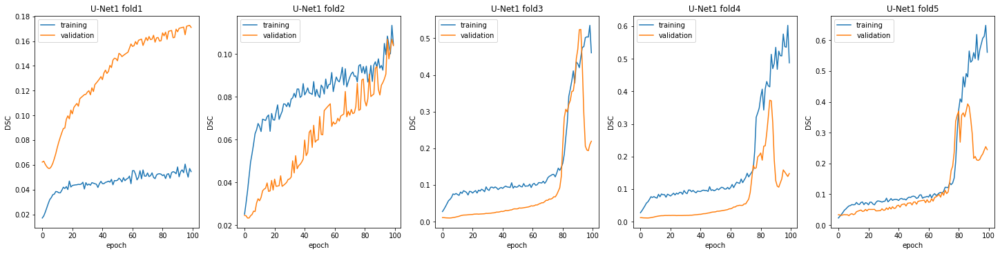

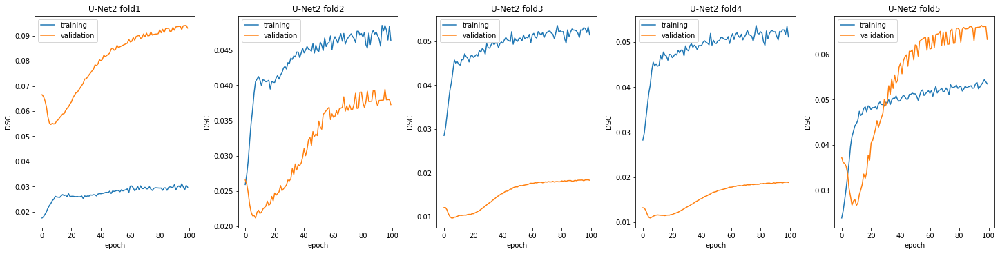

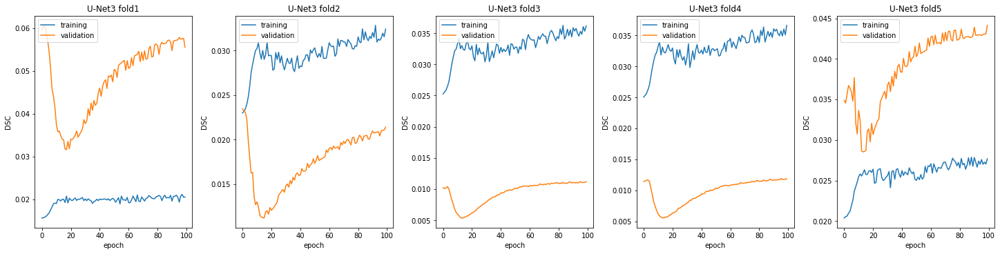

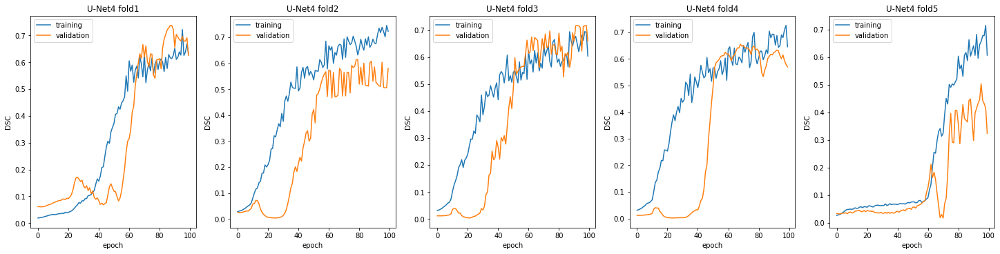

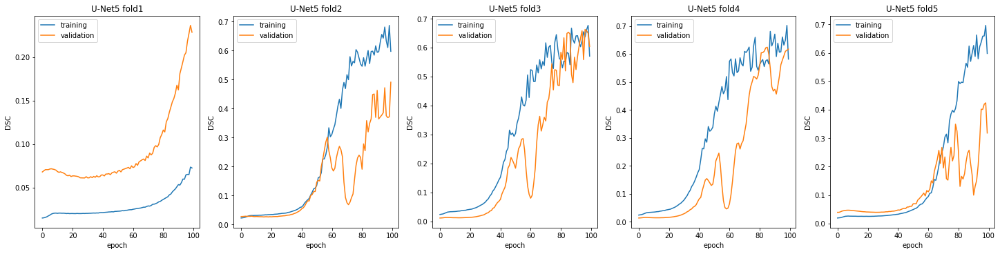

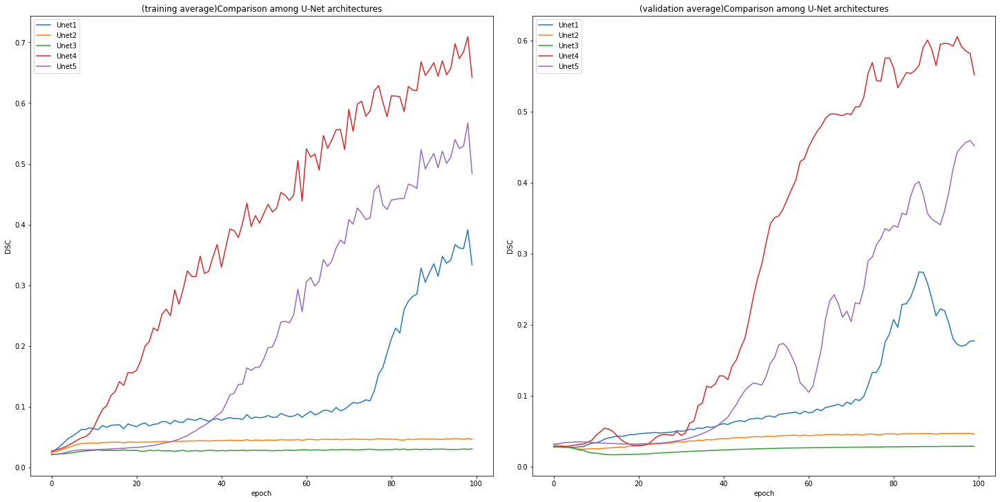

In [19]:
Unets = ["Unet1.csv", "Unet2.csv", "Unet3.csv", "Unet4.csv", "Unet5.csv"]
histories_csvs = []
titles = ["U-Net1", "U-Net2", "U-Net3", "U-Net4", "U-Net5"]
i = 0
for Unet in Unets:
    csv = pd.read_csv(base_path + "experiment_results/" + Unet)
    histories_csvs.append(csv)
    show_all_folds_dice_coefficient_result(csv, titles=[titles[i]]*5)
    i += 1
compare_average_DSC_in_different_number_encoders(histories_csvs, title="Comparison among U-Net architectures")

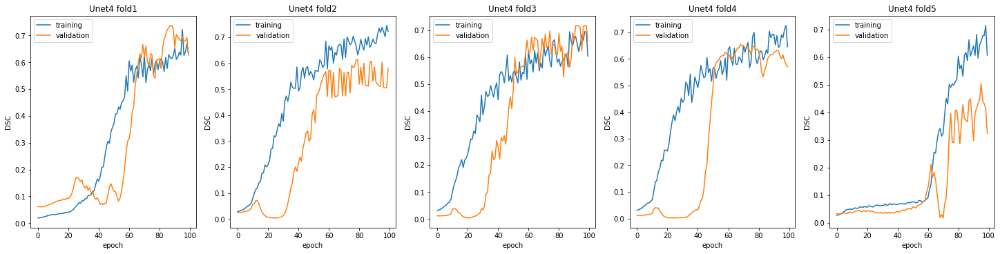

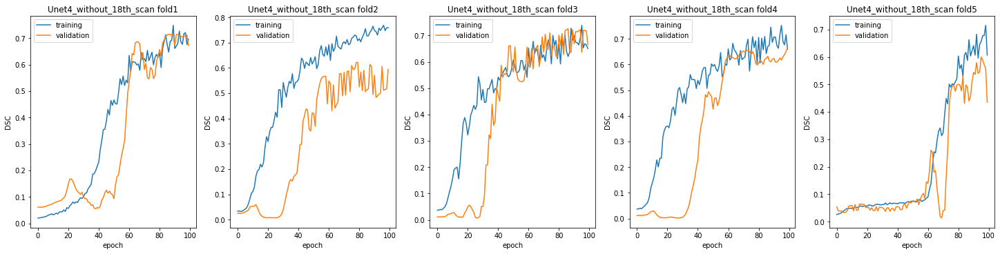

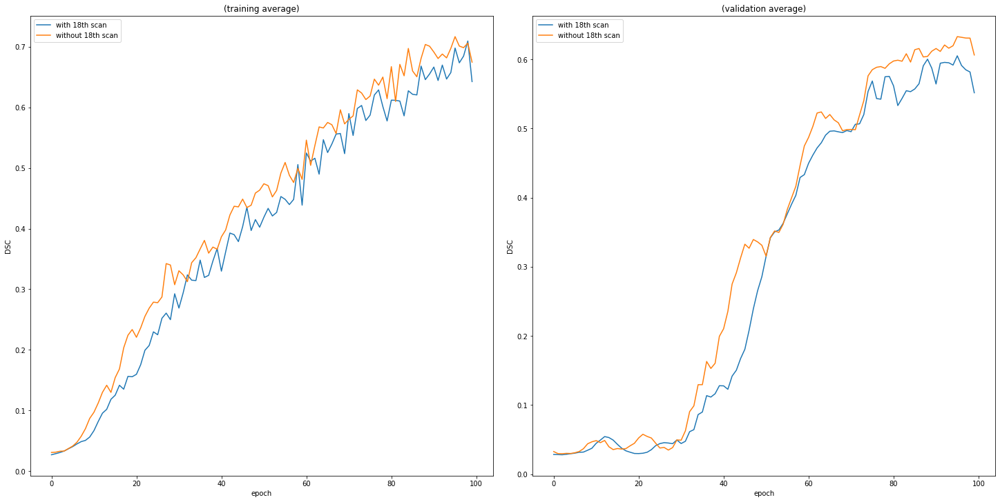

In [22]:
models_name = ["no", "fliplr", "flipud", "intensify", "translate", "rotate", "scale", "noise"]
histories_csvs = []
for j, csv_name in enumerate(models_name):
    indexes = []
    losses = []
    compute_dice_coefficients = []
    val_losses = []
    val_compute_dice_coefficients = []
    lrs = []
    group_numbers = []
    for i in range(5):
        csv = pd.read_csv(base_path + "experiment_results/augmentation_delete_almost_healthy_lung_train_valid"+str(i)+".csv")
        csv = csv[csv.group_number == j]
        index = csv.index.values
        loss = csv.loss.values
        compute_dice_coefficient = csv.compute_dice_coefficient.values
        val_loss = csv.val_loss.values
        val_compute_dice_coefficient = csv.val_compute_dice_coefficient.values
        lr = csv.lr.values
        indexes.extend(index)
        losses.extend(loss)
        compute_dice_coefficients.extend(compute_dice_coefficient)
        val_losses.extend(val_loss)
        lrs.extend(lr)
        val_compute_dice_coefficients.extend(val_compute_dice_coefficient)
        group_numbers.extend([i]*len(val_loss))
    temp_csv = pd.DataFrame({"index": indexes, "loss":losses, "compute_dice_coefficient":compute_dice_coefficients, "val_loss":val_losses, 
                             "val_compute_dice_coefficient": val_compute_dice_coefficients, "lr": lrs, "group_number":group_numbers })
    histories_csvs.append(temp_csv)

Unet4_without_18th_scan = histories_csvs[0]
Unet4 = pd.read_csv(base_path + "experiment_results/Unet4.csv")
Unets = [Unet4, Unet4_without_18th_scan]
titles = ["Unet4", "Unet4_without_18th_scan"]
i = 0
new_histories_csvs = []
for Unet in Unets:
    new_histories_csvs.append(Unet)
    show_all_folds_dice_coefficient_result(Unet, titles=[titles[i]]*5, n=5)
    i += 1
compare_average_DSC_in_different_number_encoders(new_histories_csvs, legend=["with 18th scan", "without 18th scan"], n=5)

EXperiment 2

In [31]:
def fliplr(volume, mask):
    volume = np.flip(volume, 1)
    mask = np.flip(mask, 1)
    return volume, mask
def flipud(volume, mask):
    volume = np.flip(volume, 0)
    mask = np.flip(mask, 0)
    return volume, mask
def intensify(volume, mask):
    factor = np.random.uniform(low=0.8, high=1.2)
    volume = volume * factor
    return volume, mask
def translate(volume, mask):
    x_offset = np.random.uniform(low=-5, high=5)
    y_offset = np.random.uniform(low=-5, high=5)
    volume = ndimage.interpolation.shift(volume, (x_offset, y_offset, 0), order=0)
    mask = ndimage.interpolation.shift(mask, (x_offset, y_offset, 0), order=0)
    return volume, mask
def rotate(volume, mask):
    factor = np.random.uniform(low=-7, high=7)
    volume = ndimage.interpolation.rotate(volume, float(factor), reshape=False, order=0)
    mask = ndimage.interpolation.rotate(mask, float(factor), reshape=False, order=0)
    return volume, mask
def __scale__(image, factor):
    height, width, depth= image.shape
    zheight             = int(np.round(factor * height))
    zwidth              = int(np.round(factor * width))
    zdepth              = depth
    if factor < 1.0:
        newimg  = np.zeros_like(image)
        row     = (height - zheight) // 2
        col     = (width - zwidth) // 2
        layer   = (depth - zdepth) // 2
        newimg[row:row+zheight, col:col+zwidth, layer:layer+zdepth] = ndimage.interpolation.zoom(image, (float(factor), float(factor), 1.0), order=0, mode='nearest')[0:zheight, 0:zwidth, 0:zdepth]
        return newimg
    elif factor > 1.0:
        row     = (zheight - height) // 2
        col     = (zwidth - width) // 2
        layer   = (zdepth - depth) // 2
        newimg = ndimage.interpolation.zoom(image[row:row+zheight, col:col+zwidth, layer:layer+zdepth], (float(factor), float(factor), 1.0), order=0, mode='nearest')  
        extrah = (newimg.shape[0] - height) // 2
        extraw = (newimg.shape[1] - width) // 2
        extrad = (newimg.shape[2] - depth) // 2
        newimg = newimg[extrah:extrah+height, extraw:extraw+width, extrad:extrad+depth]
        return newimg
    else:
        return image
def scale(volume, mask):
    factor = np.random.uniform(low=0.9, high=1.1)
    volume = __scale__(volume, factor)
    mask = __scale__(mask, factor)
    return volume, mask
def __noise__(image, sigma):
    noise = np.random.normal(0, sigma, image.shape)
    image_copy = image + noise
    image_copy = image_copy.clip(min=0, max=1)
    return tf.cast(image_copy, tf.float32)
def noise(volume, mask):
    sigma = np.random.uniform(low=0.01, high=0.05)
    volume = __noise__(volume, sigma)
    return volume, mask 
def augment_wrapper(names, n=None, p=None):
    def augment(volume, mask, p=1/4, names=names):
        if np.random.rand() <= p:
            if "fliplr" in names:
                volume, mask = fliplr(volume, mask)
        if np.random.rand() <= p:
            if "flipud" in names:
                volume, mask = flipud(volume, mask)
        if np.random.rand() <= p:
            if "intensify" in names:
                volume, mask = intensify(volume, mask)
        if np.random.rand() <= p:
            if "translate" in names:
                volume, mask = translate(volume, mask)
        if np.random.rand() <= p:
            if "rotate" in names:
                volume, mask = rotate(volume, mask)
        if np.random.rand() <= p:
            if "scale" in names:
                volume, mask = scale(volume, mask)
        if np.random.rand() <= p:
            if "noise" in names:
                volume, mask = noise(volume, mask)
        if np.random.rand() <= p:
            if "combined_voxels" in names:
                zone = []
                for i in range(20):
                    if i not in range(n*4, n*4+4):
                        zone.append(i)
                index = zone[np.random.randint(0, 16)]
                other_volume = covid19s[index]
                other_mask = covid19masks[index]
                separate_number = np.random.randint(28, 100)
                if np.random.randint(0, 2) == 0:
                    if np.random.randint(0, 2) == 0:
                        # vertical concatenation
                        volume = volume[0:separate_number, :, :]
                        other_volume = other_volume[separate_number:, :, :]
                        volume = keras.layers.concatenate([volume, other_volume], axis=0)
                        mask = mask[0:separate_number, :, :]
                        other_mask = other_mask[separate_number:, :, :]
                        mask = keras.layers.concatenate([mask, other_mask], axis=0)
                    else:
                        #  horizontal concatenation
                        volume = volume[:, 0:separate_number, :]
                        other_volume = other_volume[:, separate_number:, :]
                        volume = keras.layers.concatenate([volume, other_volume], axis=1)
                        mask = mask[:, 0:separate_number, :]
                        other_mask = other_mask[:, separate_number:, :]
                        mask = keras.layers.concatenate([mask, other_mask], axis=1)
        return volume, mask
    return augment

In [7]:
def get_dataset(train_data, valid_data, augment):
    tf.random.set_seed(2021)
    def preprocessing_validation(index):
        """adding a channel."""
        volume, mask = covid19s[index], covid19masks[index]
        volume = tf.expand_dims(volume, axis=3)
        mask = tf.expand_dims(mask, axis=3)
        return volume, mask
    def preprocessing_training(index):
        """adding a channel."""
        volume, mask = augment(covid19s[index], covid19masks[index])
        volume = tf.expand_dims(volume, axis=3)
        mask = tf.expand_dims(mask, axis=3)
        return volume, mask
    train_dataset = tf.data.Dataset.from_tensor_slices(train_data)
    validation_dataset = tf.data.Dataset.from_tensor_slices(valid_data)
    batch_size = 2
    train_dataset = (
        train_dataset.shuffle(16)
        .map(lambda x: tf.py_function(func=preprocessing_training, inp=[x], Tout=[tf.float32, tf.int8]))
        .batch(batch_size, num_parallel_calls=tf.data.AUTOTUNE, deterministic=True)
        .prefetch(batch_size)
    )
    validation_dataset = (
        validation_dataset.shuffle(16)
        .map(lambda x: tf.py_function(func=preprocessing_validation, inp=[x], Tout=[tf.float32, tf.int8]))
        .batch(batch_size, num_parallel_calls=tf.data.AUTOTUNE, deterministic=False)
        .prefetch(batch_size)
    )
    return train_dataset, validation_dataset

In [ ]:
models = [Unet4, Unet4, Unet4]
models_name = ["without augmentation", "augmentation", "augmentation plus CombinedVoxels"]
kfold = KFold(n_splits=5, shuffle=False)
for model_index, model_func in enumerate(models):
    print("start"*100)
    print(models_name[model_index])
    folds = kfold.split(covid19s, covid19masks)
    histories = []
    fold_num = 1
    for train_data, valid_data in folds:
        if models_name[model_index] == "augmentation plus CombinedVoxels":
            train_dataset, validation_dataset = get_dataset(train_data, valid_data, augment_wrapper(["combined_voxels", "fliplr", "flipud", "intensify", "translate", "rotate", "scale", "noise"],n=fold_num-1))
        elif models_name[model_index] == "augmentation":
            train_dataset, validation_dataset = get_dataset(train_data, valid_data, augment_wrapper(["fliplr", "flipud", "intensify", "translate", "rotate", "scale", "noise"],n=fold_num-1))
        else:
            train_dataset, validation_dataset = get_dataset(train_data, valid_data, augment_wrapper([]))
        model = model_func(addition_link=True)
        model_checkpoint_cb = get_model_checkpoint_cb(base_path + "experiment_weights/Unet/" + models_name[model_index] + "_fold_num_" + str(fold_num) + "/model")
        reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1,
                              patience=5, min_lr=0.0001, min_delta=0.05)
        optimizer = SGD()
        model.compile(loss=DSCL, optimizer=optimizer, metrics=[DSC])
        epochs = 100000
        early_stop_cb = keras.callbacks.EarlyStopping(patience=100)
        history = model.fit(
            train_dataset,
            validation_data=validation_dataset,
            epochs=epochs,
            shuffle=False,
            verbose=2,
            callbacks=[model_checkpoint_cb, reduce_lr, early_stop_cb]
        )
        histories.append(history)
        print("end"*100)
        fold_num += 1
    save_history_to_disk(histories, base_path + "experiment_results/" + models_name[model_index] + ".csv")

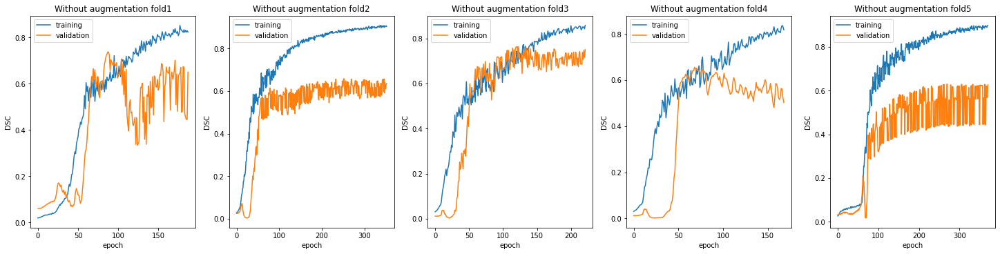

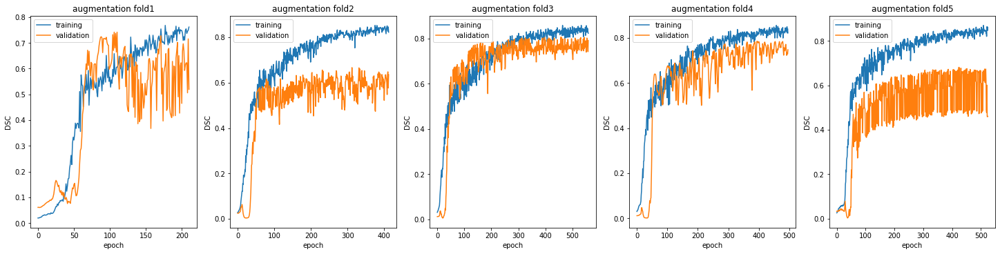

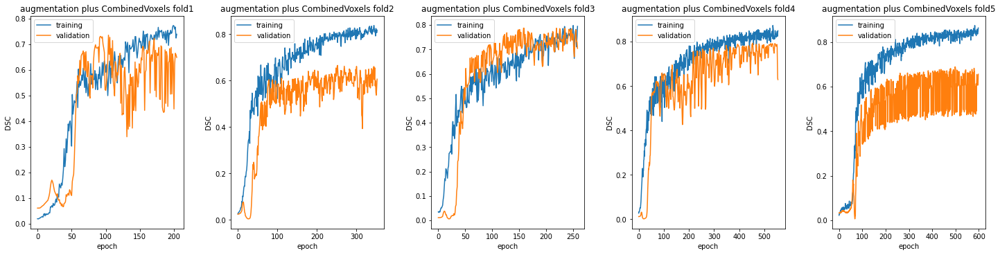

In [23]:
Unets = ["without_augmentation.csv", "augmentation.csv", "augmentation_plus_CombinedVoxels.csv"]
histories_csvs = []
titles = ["Without augmentation", "augmentation", "augmentation plus CombinedVoxels"]
i = 0
for Unet in Unets:
    csv = pd.read_csv(base_path + "experiment_results/" + Unet)
    histories_csvs.append(csv)
    show_all_folds_dice_coefficient_result(csv, titles=[titles[i]]*5)
    i += 1

In [26]:
def predict(model, lungs):
    predictions = []
    for lung in lungs:
        prediction = model(lung)
        predictions.append(prediction)
    return np.array(predictions)

answer1s = []
answer2s = []
answer3s = []

for i in range(1, 6):

    without_augmentation = U_Net4()
    without_augmentation.load_weights(base_path + f"experiment_weights/Unet/without_augmentation_fold_num_{i}/model") 
    augmentation = U_Net4()
    augmentation.load_weights(base_path + f"experiment_weights/Unet/augmentation_fold_num_{i}/model") 
    augmentation_plus_combinedvoxels = U_Net4()
    augmentation_plus_combinedvoxels.load_weights(base_path + f"experiment_weights/Unet/augmentation_plus_CombinedVoxels_fold_num_{i}/model") 
    
    j = i - 1
    t = []
    lungs = []
    for k in range(j*4, j*4+4):
        lungs.append(np.reshape(covid19s[k], (1, 128, 128, 64, 1)))
        t.append(np.reshape(covid19masks[k], (1, 128, 128, 64, 1)))
    t = np.array(t)
    lungs = np.array(lungs)

    predictions_1 = predict(without_augmentation, lungs)
    predictions_2 = predict(augmentation, lungs)
    predictions_3 = predict(augmentation_plus_combinedvoxels, lungs)
    answer1 = DSC(t, predictions_1)
    answer2 = DSC(t, predictions_2)
    answer3 = DSC(t, predictions_3)
    print(answer1)
    print(answer2)
    print(answer3)
    answer1s.append(answer1)
    answer2s.append(answer2)
    answer3s.append(answer3)
    print("X"*100)
print(np.mean(answer1s))
print(np.std(answer1s))
print("Q"*100)
print(np.mean(answer2s))
print(np.std(answer2s))
print("Q"*100)
print(np.mean(answer3s))
print(np.std(answer3s))

tf.Tensor(0.7298771, shape=(), dtype=float32)
tf.Tensor(0.7285629, shape=(), dtype=float32)
tf.Tensor(0.7358932, shape=(), dtype=float32)
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
tf.Tensor(0.67856413, shape=(), dtype=float32)
tf.Tensor(0.6734013, shape=(), dtype=float32)
tf.Tensor(0.68084866, shape=(), dtype=float32)
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
tf.Tensor(0.74337316, shape=(), dtype=float32)
tf.Tensor(0.7958061, shape=(), dtype=float32)
tf.Tensor(0.7728625, shape=(), dtype=float32)
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
tf.Tensor(0.65529555, shape=(), dtype=float32)
tf.Tensor(0.7860023, shape=(), dtype=float32)
tf.Tensor(0.78801185, shape=(), dtype=float32)
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
tf.Tensor(0.5981436, shape=(), dtype=fl

experiment 3

In [22]:
model1 = U_Net1()
model1.load_weights(base_path + "experiment_weights/Unet/Unet1_fold_num_3/model") 
model1.trainable = False
model4 = U_Net4()
model4.load_weights(base_path + "experiment_weights/Unet/Unet4_fold_num_3/model")  
model4.trainable = False
model5 = U_Net5()
model5.load_weights(base_path + "experiment_weights/Unet/Unet5_fold_num_3/model")  
model5.trainable = False

s = 0.5255078 + 0.6796171 + 0.68494296
u1_c = 0.5255078 / s
u4_c = 0.6796171 / s
u5_c = 0.68494296 / s

In [30]:
class Attention_in_3D_1_1d(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1],
            initializer=keras.initializers.constant(u1_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_4_1d(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1],
            initializer=keras.initializers.constant(u4_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_5_1d(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1],
            initializer=keras.initializers.constant(u5_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
def Attention_Mechanism_Model_1d():
    tf.random.set_seed(2021)
    ct = keras.Input((128, 128, 64, 1))
    model1_output = model1(ct)
    model4_output = model4(ct)
    model5_output = model5(ct)
    attention1 = Attention_in_3D_1_1d(name="attention1")(model1_output)
    attention4 = Attention_in_3D_4_1d(name="attention2")(model4_output)
    attention5 = Attention_in_3D_5_1d(name="attention3")(model5_output) 
    model = keras.Model(ct, (attention1+attention4+attention5))
    return model

In [31]:
class Attention_in_3D_1_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u1_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_4_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u4_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_5_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u5_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
def Attention_Mechanism_Model_1d_depth():
    tf.random.set_seed(2021)
    ct = keras.Input((128, 128, 64, 1))
    model1_output = model1(ct)
    model4_output = model4(ct)
    model5_output = model5(ct)
    attention1 = Attention_in_3D_1_1d_depth(name="attention1")(model1_output)
    attention4 = Attention_in_3D_4_1d_depth(name="attention2")(model4_output)
    attention5 = Attention_in_3D_5_1d_depth(name="attention3")(model5_output) 
    model = keras.Model(ct, (attention1+attention4+attention5))
    return model

In [32]:
class Attention_in_3D_1_2d(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,128,128,1,1],
            initializer=keras.initializers.constant(u1_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_4_2d(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,128,128,1,1],
            initializer=keras.initializers.constant(u4_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_5_2d(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,128,128,1,1],
            initializer=keras.initializers.constant(u5_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
def Attention_Mechanism_Model_2d():
    tf.random.set_seed(2021)
    ct = keras.Input((128, 128, 64, 1))
    model1_output = model1(ct)
    model4_output = model4(ct)
    model5_output = model5(ct)
    attention1 = Attention_in_3D_1_2d(name="attention1")(model1_output)
    attention4 = Attention_in_3D_4_2d(name="attention2")(model4_output)
    attention5 = Attention_in_3D_5_2d(name="attention3")(model5_output) 
    model = keras.Model(ct, (attention1+attention4+attention5))
    return model

In [33]:
class Attention_in_3D_1_3d(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,128,128,64,1],
            initializer=keras.initializers.constant(u1_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_4_3d(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,128,128,64,1],
            initializer=keras.initializers.constant(u4_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_5_3d(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,128,128,64,1],
            initializer=keras.initializers.constant(u5_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
def Attention_Mechanism_Model_3d():
    tf.random.set_seed(2021)
    ct = keras.Input((128, 128, 64, 1))
    model1_output = model1(ct)
    model4_output = model4(ct)
    model5_output = model5(ct)
    attention1 = Attention_in_3D_1_3d(name="attention1")(model1_output)
    attention4 = Attention_in_3D_4_3d(name="attention2")(model4_output)
    attention5 = Attention_in_3D_5_3d(name="attention3")(model5_output) 
    model = keras.Model(ct, (attention1+attention4+attention5))
    return model

In [27]:
models = [Attention_Mechanism_Model_1d, Attention_Mechanism_Model_1d_depth, Attention_Mechanism_Model_2d, Attention_Mechanism_Model_3d]
models_name = ["Attention_Mechanism_Model_1d", "Attention_Mechanism_Model_1d_depth", "Attention_Mechanism_Model_2d", "Attention_Mechanism_Model_3d"]
kfold = KFold(n_splits=5, shuffle=False)
for model_index, model_func in enumerate(models):
    print("start"*100)
    print(models_name[model_index])
    folds = kfold.split(covid19s, covid19masks)
    histories = []
    fold_num = 1
    for train_data, valid_data in folds:
        if valid_data[0] != 2*4: continue
        train_dataset, validation_dataset = get_dataset(train_data, valid_data)
        model = model_func()
        model_checkpoint_cb = get_model_checkpoint_cb(base_path + "experiment_weights/" + models_name[model_index] + "/model")
        optimizer = get_optimizer()
        model.compile(loss=DSCL, optimizer=keras.optimizers.SGD(learning_rate=0.001, momentum=0.99, nesterov=True), metrics=[DSC])
        epochs = 600
        early_stop_cb = keras.callbacks.EarlyStopping(patience=100)
        history = model.fit(
            train_dataset,
            validation_data=validation_dataset,
            epochs=epochs,
            shuffle=False,
            verbose=2,
            callbacks=[model_checkpoint_cb, early_stop_cb]
        )
        histories.append(history)
        print("end"*100)
        fold_num += 1
        save_history_to_disk(histories, base_path + "experiment_results/" + models_name[model_index] + ".csv", n=1)

In [26]:
def get_true_prediction_vector(model, lung, true_mask):
    prediction = model(lung)
    prediction = tf.cast((prediction >= 0.50), tf.int64)
    vector = tf.cast((prediction == true_mask), tf.int64)
    return np.reshape(vector,-1)

def get_angle(vector1, vector2):
    dot = vector1.dot(vector2)
    abs_v1 = np.sqrt(vector1.dot(vector1))
    abs_v2 = np.sqrt(vector2.dot(vector2))
    angle = dot / (abs_v1*abs_v2)
    return np.arccos(angle)

lung = np.array([covid19s[9][:,:,:,np.newaxis]])
true_mask = np.reshape(covid19masks[9], (1, 128, 128, 64, 1))

In [24]:
model1_vector = get_true_prediction_vector(model1, lung, true_mask)
model4_vector = get_true_prediction_vector(model4, lung, true_mask)
model5_vector = get_true_prediction_vector(model5, lung, true_mask)

print(get_angle(model1_vector, model4_vector))
print(get_angle(model1_vector, model5_vector))
print(get_angle(model4_vector, model5_vector))

In [37]:
lungs = []
t = []
for k in range(2*4, 2*4+4):
    lungs.append(np.reshape(covid19s[k], (1, 128, 128, 64, 1)))
    t.append(np.reshape(covid19masks[k], (1, 128, 128, 64, 1)))

In [38]:
# 1
predictions_i1 = predict(model1, lungs)
predictions_i4 = predict(model4, lungs)
predictions_i5 = predict(model5, lungs)
predictions_i = (predictions_i1 + predictions_i4 + predictions_i5) / 3
print(DSC(t, predictions_i))

tf.Tensor(0.6949745, shape=(), dtype=float32)


In [42]:
predictions_i1 = predict(model1, lungs)
predictions_i4 = predict(model4, lungs)
predictions_i5 = predict(model5, lungs)
predictions_ii = (predictions_i1*u1_c + predictions_i4*u4_c + predictions_i5*u5_c) / (u1_c + u4_c + u5_c)
print(DSC(t, predictions_ii))

tf.Tensor(0.7019458, shape=(), dtype=float32)


In [43]:
iiimodel = Attention_Mechanism_Model_1d()
iiimodel.load_weights(base_path + "experiment_weights/Attention_Mechanism_Model_1d/model")
predictions_iii = predict(iiimodel, lungs)
print(DSC(t, predictions_iii))


tf.Tensor(0.70580596, shape=(), dtype=float32)


In [45]:
ivmodel = Attention_Mechanism_Model_1d_depth()
ivmodel.load_weights(base_path + "experiment_weights/Attention_Mechanism_Model_1d_depth/model")
predictions_iv = predict(ivmodel, lungs)
print(DSC(t, predictions_iv))

tf.Tensor(0.70993006, shape=(), dtype=float32)


In [46]:
vmodel = Attention_Mechanism_Model_2d()
vmodel.load_weights(base_path + "experiment_weights/Attention_Mechanism_Model_2d/model")
predictions_v = predict(vmodel, lungs)
print(DSC(t, predictions_v))

tf.Tensor(0.705776, shape=(), dtype=float32)


In [47]:
vimodel = Attention_Mechanism_Model_3d()
vimodel.load_weights(base_path + "experiment_weights/Attention_Mechanism_Model_3d/model")
predictions_vi = predict(vimodel, lungs)
print(DSC(t, predictions_vi))

tf.Tensor(0.70326275, shape=(), dtype=float32)


Ground Truth


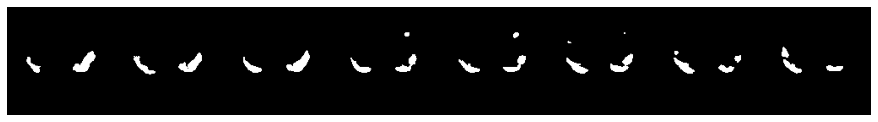

U-Net1


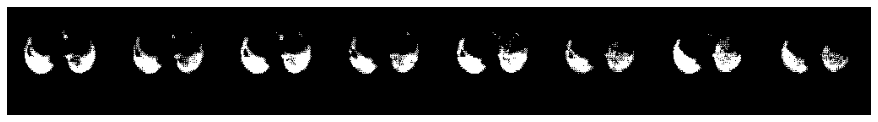

U-Net4


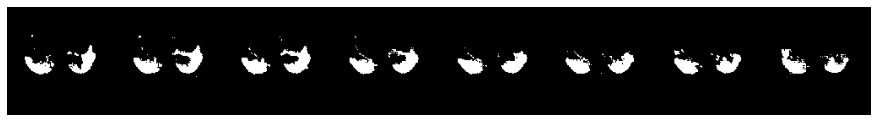

U-Net5


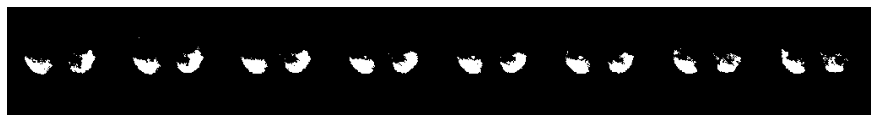

1


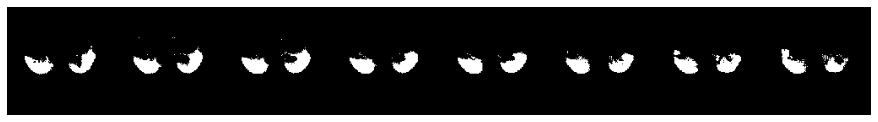

2


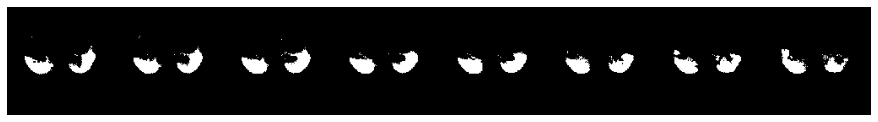

3


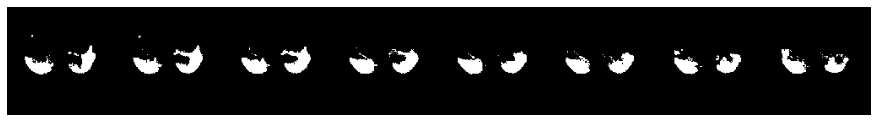

4


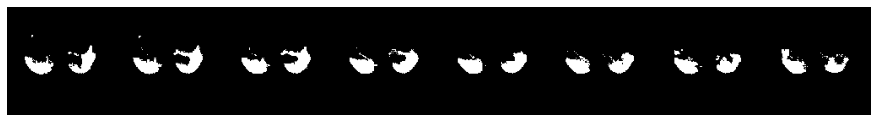

5


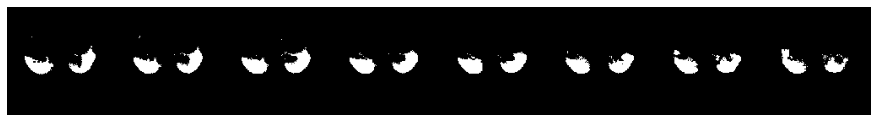

6


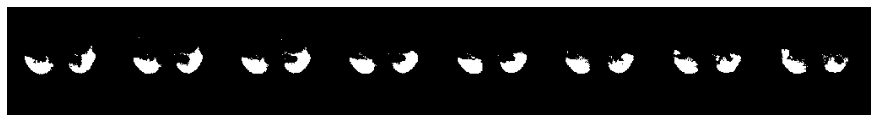

In [49]:
def plot_slices_1d(num_rows, num_columns, width, height, data):
    data = np.rot90(np.array(data))
    data = np.transpose(data)
    data = np.reshape(data, (num_rows, num_columns, width, height))
    rows_data, columns_data = data.shape[0], data.shape[1]
    heights = [slc[0].shape[0] for slc in data]
    widths = [slc.shape[1] for slc in data[0]]
    fig_width = 12.0
    fig_height = fig_width * sum(heights) / sum(widths)
    f, axarr = plt.subplots(
        rows_data,
        columns_data,
        figsize=(fig_width, fig_height),
        gridspec_kw={"height_ratios": heights},
    )
    for j in range(columns_data):
        axarr[j].imshow(data[0][j], cmap="gray")
        axarr[j].axis("off")
    plt.subplots_adjust(wspace=0, hspace=0, left=0, right=1, bottom=0, top=1)
    plt.show()

print("Ground Truth")
plot_slices_1d(1, 8, 128, 128, np.squeeze(t[1])[:,:,3*8:4*8]  >= 0.5)
print("U-Net1")
plot_slices_1d(1, 8, 128, 128, np.squeeze(predictions_i1[1])[:,:,3*8:4*8]  >= 0.5)
print("U-Net4")
plot_slices_1d(1, 8, 128, 128, np.squeeze(predictions_i4[1])[:,:,3*8:4*8]  >= 0.5)
print("U-Net5")
plot_slices_1d(1, 8, 128, 128, np.squeeze(predictions_i5[1])[:,:,3*8:4*8]  >= 0.5)
print("1")
plot_slices_1d(1, 8, 128, 128, np.squeeze(predictions_i[1])[:,:,3*8:4*8] >= 0.5)
print("2")
plot_slices_1d(1, 8, 128, 128, np.squeeze(predictions_ii[1])[:,:,3*8:4*8] >= 0.5)
print("3")
plot_slices_1d(1, 8, 128, 128, np.squeeze(predictions_iii[1])[:,:,3*8:4*8] >= 0.5)
print("4")
plot_slices_1d(1, 8, 128, 128, np.squeeze(predictions_iv[1])[:,:,3*8:4*8] >= 0.5)
print("5")
plot_slices_1d(1, 8, 128, 128, np.squeeze(predictions_v[1])[:,:,3*8:4*8] >= 0.5)
print("6")
plot_slices_1d(1, 8, 128, 128, np.squeeze(predictions_vi[1])[:,:,3*8:4*8] >= 0.5)

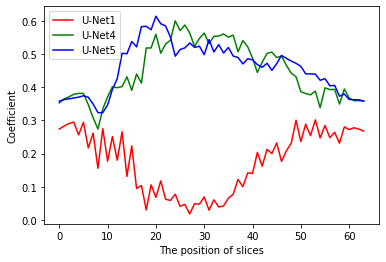

In [50]:
attention1 = ivmodel.get_layer("attention1").weights
attention4 = ivmodel.get_layer("attention2").weights
attention5 = ivmodel.get_layer("attention3").weights

plt.plot(np.reshape(attention1[0].numpy(), -1), color="red", label="U-Net1")
plt.plot(np.reshape(attention4[0].numpy(), -1), color="green", label="U-Net4")
plt.plot(np.reshape(attention5[0].numpy(), -1), color="blue", label="U-Net5")
plt.xlabel("The position of slices")
plt.ylabel("Coefficient")
plt.legend(loc='upper left')
plt.show()

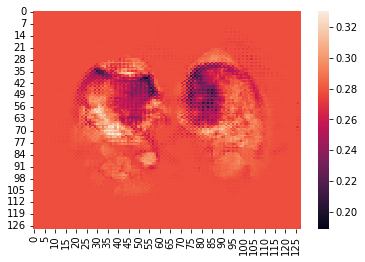

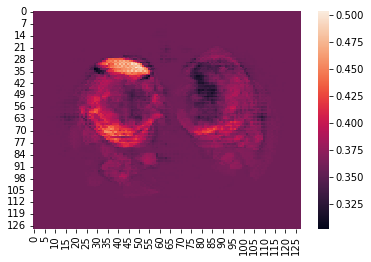

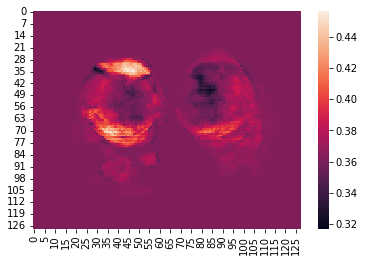

In [52]:
attention1 = vmodel.get_layer("attention1").weights
attention4 = vmodel.get_layer("attention2").weights
attention5 = vmodel.get_layer("attention3").weights

sns.heatmap(np.squeeze(attention1[0].numpy()))
plt.show()
sns.heatmap(np.squeeze(attention4[0].numpy()))
plt.show()
sns.heatmap(np.squeeze(attention5[0].numpy()))
plt.show()

##### Experiment4

In [55]:
def coder_skip(x, n_filter):
    x = layers.MaxPool3D(padding="same")(x)
    x = layers.Conv3D(
        n_filter, (1, 1, 1),
        kernel_initializer='he_normal',
        padding="same",
        strides=(1, 1, 1)
    )(x)
    x = layers.BatchNormalization()(x)
    x = keras.layers.LeakyReLU(alpha=0.1)(x)
    return x

In [56]:
def Unet4_resnet(addition_link=True):
    tf.random.set_seed(2021)
    ct = keras.Input((None, None, None, 1))
    # encoder
    encoder0 = BCL(ct, 64)
    encoder0_skip = coder_skip(encoder0, 128)
    encoder1 = BCL(encoder0, 128, max_pool=True)
    encoder1 = encoder1 + encoder0_skip
    encoder1_skip = coder_skip(encoder1, 256)
    encoder2 = BCL(encoder1, 256, max_pool=True)
    encoder2 = encoder2 + encoder1_skip
    encoder2_skip = coder_skip(encoder2, 512)
    encoder3 = BCL(encoder2, 512, max_pool=True)
    encoder3 = encoder3 + encoder2_skip
    encoder3_skip = coder_skip(encoder3, 1024)
    encoder4 = BCL(encoder3, 1024, max_pool=True)
    encoder4 = encoder4 + encoder3_skip
    encoder4_skip = coder_skip(encoder4, 512)
    # decoder
    decoder4 = BRL(encoder3, encoder4, 512, addition_link=addition_link)
    decoder3 = BRL(encoder2, decoder4, 256, addition_link=addition_link)
    decoder2 = BRL(encoder1, decoder3, 128, addition_link=addition_link)
    decoder1 = BRL(encoder0, decoder2, 64, addition_link=addition_link)
    decoder0 = BRL(ct, decoder1, 1, addition_link=addition_link, strides=(1, 1, 1), is_last=True)
    output = layers.Conv3D(1, 3, activation="sigmoid", padding="same")(decoder0)
    model = keras.Model(ct, output)
    return model

In [58]:
def Unet4_densenet(addition_link=True):
    tf.random.set_seed(2021)
    ct = keras.Input((128, 128, 64, 1))
    # encoder
    encoder0 = BCL(ct, 64)
    encoder0 = keras.layers.concatenate([ct, encoder0])
    encoder1 = BCL(encoder0, 128, max_pool=True)
    encoder1 = keras.layers.concatenate([layers.MaxPool3D(padding="same")(encoder0), encoder1])
    encoder2 = BCL(encoder1, 256, max_pool=True)
    encoder2 = keras.layers.concatenate([layers.MaxPool3D(padding="same")(encoder1), encoder2])
    encoder3 = BCL(encoder2, 512, max_pool=True)
    encoder3 = keras.layers.concatenate([layers.MaxPool3D(padding="same")(encoder2), encoder3])
    encoder4 = BCL(encoder3, 1024, max_pool=True)
    # decoder
    decoder4 = BRL(encoder3, encoder4, 961, addition_link=addition_link)
    decoder3 = BRL(encoder2, decoder4, 449, addition_link=addition_link)
    decoder2 = BRL(encoder1, decoder3, 193, addition_link=addition_link)
    decoder1 = BRL(encoder0, decoder2, 65, addition_link=addition_link)
    decoder0 = BRL(ct, decoder1, 1, addition_link=addition_link, strides=(1, 1, 1), is_last=True)
    output = layers.Conv3D(1, 3, activation="sigmoid", padding="same")(decoder0)
    model = keras.Model(ct, output)
    return model

In [59]:
def basic_conv(input_tensor, filters, kernal_size, strides, kernel_regularizer="l2"):
    conv = keras.layers.Conv3D(filters, kernal_size, strides, padding="same", kernel_initializer="he_normal", kernel_regularizer=kernel_regularizer)(input_tensor)
    BN = keras.layers.BatchNormalization()(conv)
    activation = keras.layers.ReLU()(BN)
    return activation
def basic_decoder_conv(corresponding_encoder, input_tensor, filters, kernal_size, kernel_regularizer="l2"):
    conv = keras.layers.Conv3DTranspose(filters, kernal_size, strides=2, padding="same", kernel_initializer="he_normal", kernel_regularizer=kernel_regularizer)(input_tensor)
    BN = keras.layers.BatchNormalization()(conv)
    activation = keras.layers.ReLU()(BN)
    decoder = keras.layers.Add()([corresponding_encoder, activation])
    return decoder
def residule_unit(input_tensor, filters, num_repeat, pool=False, is_conv2=False):
    for i in range(0, num_repeat):
        identity = input_tensor
        if pool:
            input_tensor = basic_conv(input_tensor, filters[0], 1, 2)
        else:
            input_tensor = basic_conv(input_tensor, filters[0], 1, 1)
        input_tensor = basic_conv(input_tensor, filters[1], 3, 1)
        input_tensor = basic_conv(input_tensor, filters[2], 1, 1)
        if pool:
            identity = basic_conv(identity, filters[2], 1, 2)
            pool = False
        elif is_conv2:
            identity = basic_conv(identity, filters[2], 1, 1)
            is_conv2 = False
        input_tensor = keras.layers.Add()([identity, input_tensor])
    return  input_tensor
def Resnet50_Unet():
    tf.random.set_seed(2021)
    ct = keras.Input((128, 128, 64, 1))
    conv1 = basic_conv(ct, 64, 7, 2)
    conv2_1 = keras.layers.MaxPool3D()(conv1)
    conv2 = residule_unit(conv2_1, (64, 64, 256), 3, pool=False, is_conv2=True)
    conv3 = residule_unit(conv2, (128, 128, 512), 4, pool=True)
    conv4 = residule_unit(conv3, (256, 256, 1024), 6, pool=True)
    conv5 = residule_unit(conv4, (512, 512, 2048), 3, pool=True)
    decoder4 = basic_decoder_conv(conv4, conv5, 1024, 3)
    decoder3 = basic_decoder_conv(conv3, decoder4, 512, 3)
    decoder2 = basic_decoder_conv(conv2, decoder3, 256, 3)
    decoder1 = basic_decoder_conv(conv1, decoder2, 64, 2)
    decoder0 = basic_decoder_conv(ct, decoder1, 1, 7)
    output = layers.Conv3D(1, 3, activation="sigmoid", padding="same")(decoder0)
    model = keras.Model(ct, output)
    return model

In [60]:
def Inception(input_tensor, filters):
    conv1 = keras.layers.Conv3D(filters[0], 1, padding="same", activation="relu", kernel_initializer="he_normal")(input_tensor)
    conv_reduce_3 = keras.layers.Conv3D(filters[1], 1, padding="same", activation="relu", kernel_initializer="he_normal")(input_tensor)
    conv3 = keras.layers.Conv3D(filters[2], 3, padding="same", activation="relu", kernel_initializer="he_normal")(conv_reduce_3)
    conv_reduce_5 = keras.layers.Conv3D(filters[3], 1, padding="same", activation="relu", kernel_initializer="he_normal")(input_tensor)
    conv5 = keras.layers.Conv3D(filters[4], 5, padding="same", activation="relu", kernel_initializer="he_normal")(conv_reduce_5)
    max_pool = keras.layers.MaxPool3D(pool_size=3, strides=1, padding="same")(input_tensor)
    pool_proj = keras.layers.Conv3D(filters[5], 1, padding="same", activation="relu", kernel_initializer="he_normal")(max_pool)
    depthconcate = keras.layers.concatenate([
        conv1, conv3, conv5, pool_proj                                         
    ])
    return depthconcate
def Googlenet_Unet():
    tf.random.set_seed(2021)
    ct = keras.Input((128, 128, 64, 1))
    conv1 = basic_conv(ct, 64, 7, 2)
    pool1 = keras.layers.MaxPool3D()(conv1)
    pool1 = keras.layers.BatchNormalization()(pool1)
    conv2 = basic_conv(pool1, 192, 3, 1)
    pool2 = keras.layers.MaxPool3D()(conv2)
    pool2 = keras.layers.BatchNormalization()(pool2)
    inception3a = Inception(pool2, (64, 96, 128, 16, 32, 32))
    inception3b = Inception(inception3a, (128, 128, 192, 32, 96, 64))
    pool3 = keras.layers.MaxPool3D()(inception3b)
    pool3 = keras.layers.BatchNormalization()(pool3)
    inception4a = Inception(pool3, (192, 96, 208, 16, 48, 64))
    inception4b = Inception(inception4a, (160, 112, 224, 24, 64, 64))
    inception4c = Inception(inception4b, (128, 128, 256, 24, 64, 64))
    inception4d = Inception(inception4c, (112, 144, 288, 32, 64, 64))
    inception4e = Inception(inception4d, (256, 160, 320, 32, 128, 128))
    pool4 = keras.layers.MaxPool3D()(inception4e)
    pool4 = keras.layers.BatchNormalization()(pool4)
    decoder4 = basic_decoder_conv(inception4e, pool4, 832, 3)
    decoder3 = basic_decoder_conv(inception3b, decoder4, 480, 3)
    decoder2 = basic_decoder_conv(conv2, decoder3, 192, 3)
    decoder1 = basic_decoder_conv(conv1, decoder2, 64, 2)
    decoder0 = basic_decoder_conv(ct, decoder1, 1, 7)
    output = layers.Conv3D(1, 3, activation="sigmoid", padding="same")(decoder0)
    model = keras.Model(ct, output)
    return model

In [61]:
def bn_relu_conv(input_tensor, k, kernal_size, stride=1, name=None):
    bn_name = name+"_batch" if name else None
    relu_name = name+"_relu" if name else None
    conv_name = name+"_conv3d" if name else None
    bn = keras.layers.BatchNormalization(name=bn_name)(input_tensor)
    relu = keras.layers.ReLU(name=relu_name)(bn)
    conv = keras.layers.Conv3D(k, kernal_size, stride, padding="same", activation="relu", kernel_initializer="he_normal", name=conv_name, kernel_regularizer="l2")(relu)
    return conv
def dense_block(input_tensor, n_repeat, k, name):
    x1 = bn_relu_conv(input_tensor, k, 1, name=name+"_1")
    x2 = bn_relu_conv(x1, k, 3, name=name+"__1")
    start = 2
    for i in range(start, n_repeat+start-1):
        if i > start:
            conc = keras.layers.Concatenate()([conc, previous])
        else:
            conc = keras.layers.Concatenate()([input_tensor, x2])
        x1 = bn_relu_conv(conc, k, 1, name=name+"_"+str(i))
        x2 = bn_relu_conv(x1, k, 3, name=name+"__"+str(i))
        previous = x2
    return x2
def transition_layer(input_tensor, k, name):
    x = bn_relu_conv(input_tensor, k, 1, name=name+"_0")
    pool = keras.layers.AveragePooling3D(name=name+"_0_pool")(x)
    return pool
def Densenet_Unet():
    tf.random.set_seed(2021)
    k = 32
    ct = keras.Input((128, 128, 64, 1))
    conv1 = basic_conv(ct, 64, 7, 2)
    pool1 = keras.layers.MaxPool3D()(conv1)
    dense_block1 = dense_block(pool1, 6, k, "conv2")
    transition_layer1 = transition_layer(dense_block1, k, "pool2")
    dense_block2 = dense_block(transition_layer1, 12, k, "conv3")
    transition_layer2 = transition_layer(dense_block2, k, "pool3")
    dense_block3 = dense_block(transition_layer2, 24, k, "conv4")
    transition_layer3 = transition_layer(dense_block3, k, "pool4")
    dense_block4 = dense_block(transition_layer3, 16, k, "conv5")
    decoder4 = basic_decoder_conv(dense_block3, dense_block4, k, 3)
    decoder3 = basic_decoder_conv(dense_block2, decoder4, k, 3)
    decoder2 = basic_decoder_conv(dense_block1, decoder3, k, 3)
    decoder1 = basic_decoder_conv(conv1, decoder2, 64, 2)
    decoder0 = basic_decoder_conv(ct, decoder1, 1, 7)
    output = layers.Conv3D(1, 3, activation="sigmoid", padding="same")(decoder0)
    model = keras.Model(ct, output)
    return model

In [ ]:
models = [U_Net4, Unet4_resnet, Unet4_densenet, Resnet50_Unet, Googlenet_Unet, Densenet_Unet]
models_name = ["U_Net4", "Unet4_resnet", "Unet4_densenet", "Resnet50_Unet", "Googlenet_Unet", "Densenet_Unet"]
kfold = KFold(n_splits=5, shuffle=False)
folds = kfold.split(covid19s, covid19masks)
histories1 = []
def SGD():
    optimizer = keras.optimizers.SGD(learning_rate=0.01, momentum=0.99, nesterov=True)
    return optimizer
for train_data, valid_data in folds:
    for model_index, model_func in enumerate(models):
        print(models_name[model_index])
        train_dataset, validation_dataset = get_dataset(train_data, valid_data)
        model = model_func()
        model_checkpoint_cb = get_model_checkpoint_cb(base_path + "experiment_weights/"+models_name[model_index]+"/model001")
        optimizer = SGD()
        model.compile(loss=DSCL, optimizer=optimizer, metrics=[DSC])
        epochs = 100
        history = model.fit(
            train_dataset,
            validation_data=validation_dataset,
            epochs=epochs,
            shuffle=False,
            verbose=2,
            callbacks=[model_checkpoint_cb]
        )
        histories1.append(history)
    save_history_to_disk(histories1, base_path + "experiment_results/architecture001.csv", n=5)
    print("*"*100)
    break

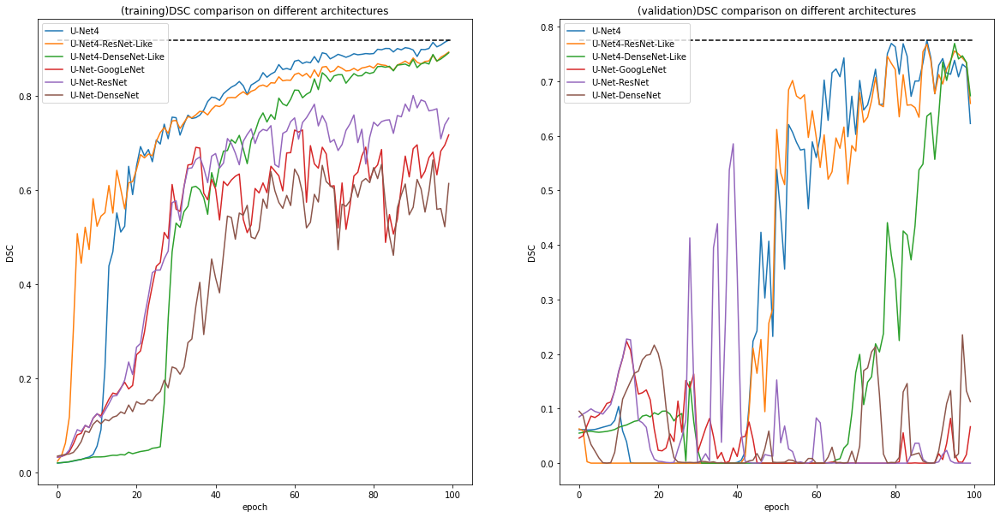

In [63]:
def show_dice_coefficient_result(
    ax, data, title, legend, n_epoch=100, 
    metric="compute_dice_coefficient",
    ylabel='DSC'):
    epochs = range(n_epoch)
    for i in range(len(data)):
        ax.plot(epochs, data[i])
    ax.set_title(f'{title}')
    ax.set_ylabel(ylabel)
    ax.set_xlabel('epoch')
    ax.legend(legend, loc='upper left')
    ax.plot([0, 100], [max(data[0]), max(data[0])], linestyle="dashed", color="black")

def show_all_dice_coefficient_result(datas, titles, legends, metrics=[], ylabel='DSC', ncols=5):
    fig, axes = plt.subplots(ncols=ncols, nrows=1, constrained_layout=False, figsize=[20, 10])
    for i in range(ncols):
        show_dice_coefficient_result(axes[i], datas[i], titles[i], legends, metric=metrics[i], ylabel=ylabel)
    plt.show()

models_name = ["Unet4", "U-Net4-ResNet-Like", "U-Net4-DenseNet-Like", "U-Net-GoogLeNet", "U-Net-ResNet", "U-Net-DenseNet"]
Unet4_architecture = pd.read_csv(base_path + "experiment_results/architecture001.csv")
Unet4_architectures = []
for i in range(len(models_name)):
    Unet4_architectures.append(Unet4_architecture[Unet4_architecture.group_number == i])
total = Unet4_architectures
datas = []
for metric in ["compute_dice_coefficient", "val_compute_dice_coefficient"]:
    data = []
    for T in total:
        data.append(T[metric].values)
    datas.append(data)
show_all_dice_coefficient_result(
    datas, ["(training)DSC comparison on different architectures", "(validation)DSC comparison on different architectures"], 
    ["U-Net4", "U-Net4-ResNet-Like", "U-Net4-DenseNet-Like", "U-Net-GoogLeNet", "U-Net-ResNet", "U-Net-DenseNet"], 
    metrics=["compute_dice_coefficient", "val_compute_dice_coefficient"], ylabel='DSC', ncols=2)

In [66]:
def predict(model, lungs):
    predictions = []
    for lung in lungs:
        prediction = model(lung)
        predictions.append(prediction)
    return np.array(predictions)

answer1s = []
answer2s = []
answer3s = []
answer4s = []
answer5s = []


for i in range(1, 2):
    U4 = U_Net4()
    U4.load_weights(base_path + f"experiment_weights/Unet4/model0001")     
    U4ResLike = Unet4_resnet()
    U4ResLike.load_weights(base_path + f"experiment_weights/Unet4_resnet_like/model0001") 
    U4DenseLike = Unet4_densenet()
    U4DenseLike.load_weights(base_path + f"experiment_weights/Unet4_densenet_like/model0001") 
    GoogleNet = Googlenet_Unet()
    GoogleNet.load_weights(base_path + f"experiment_weights/Googlenet_Unet/model0001") 
    Res = Resnet50_Unet()
    Res.load_weights(base_path + f"experiment_weights/Resnet50_Unet/model0001") 
    Dense = Densenet_Unet()
    Dense.load_weights(base_path + f"experiment_weights/Densenet_Unet/model0001") 
   
    j = i - 1
    t = []
    lungs = []
    for k in range(j*4, j*4+4):
        lungs.append(np.reshape(covid19s[k], (1, 128, 128, 64, 1)))
        t.append(np.reshape(covid19masks[k], (1, 128, 128, 64, 1)))
    t = np.array(t)
    lungs = np.array(lungs)
    predictions_0 = predict(U4, lungs)
    predictions_1 = predict(U4ResLike, lungs)
    predictions_2 = predict(U4DenseLike, lungs)
    predictions_3 = predict(GoogleNet, lungs)
    predictions_4 = predict(Res, lungs)
    predictions_5 = predict(Dense, lungs)
    answer0 = DSC(t, predictions_0)
    answer1 = DSC(t, predictions_1)
    answer2 = DSC(t, predictions_2)
    answer3 = DSC(t, predictions_3)
    answer4 = DSC(t, predictions_4)
    answer5 = DSC(t, predictions_5)
    print(answer0)
    print(answer1)
    print(answer2)
    print(answer3)
    print(answer4)
    print(answer5)
    print("X"*100)

tf.Tensor(0.66099185, shape=(), dtype=float32)
tf.Tensor(0.6983828, shape=(), dtype=float32)
tf.Tensor(0.13793772, shape=(), dtype=float32)
tf.Tensor(0.24297667, shape=(), dtype=float32)
tf.Tensor(0.3396517, shape=(), dtype=float32)
tf.Tensor(0.2613054, shape=(), dtype=float32)
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX


Final Model

In [46]:
def SGD():
    optimizer = keras.optimizers.SGD(learning_rate=0.01, momentum=0.99, nesterov=True)
    return optimizer
def get_dataset(train_data, valid_data, augment):
    tf.random.set_seed(2021)
    def preprocessing_validation(index):
        """adding a channel."""
        volume, mask = covid19s[index], covid19masks[index]
        volume = tf.expand_dims(volume, axis=3)
        mask = tf.expand_dims(mask, axis=3)
        return volume, mask
    def preprocessing_training(index):
        """adding a channel."""
        volume, mask = augment(covid19s[index], covid19masks[index])
        volume = tf.expand_dims(volume, axis=3)
        mask = tf.expand_dims(mask, axis=3)
        return volume, mask
    train_dataset = tf.data.Dataset.from_tensor_slices(train_data)
    validation_dataset = tf.data.Dataset.from_tensor_slices(valid_data)
    batch_size = 2
    train_dataset = (
        train_dataset.shuffle(16)
        .map(lambda x: tf.py_function(func=preprocessing_training, inp=[x], Tout=[tf.float32, tf.int8]))
        .batch(batch_size, num_parallel_calls=tf.data.AUTOTUNE, deterministic=True)
        .prefetch(batch_size)
    )
    validation_dataset = (
        validation_dataset.shuffle(16)
        .map(lambda x: tf.py_function(func=preprocessing_validation, inp=[x], Tout=[tf.float32, tf.int8]))
        .batch(batch_size, num_parallel_calls=tf.data.AUTOTUNE, deterministic=False)
        .prefetch(batch_size)
    )
    return train_dataset, validation_dataset

In [18]:
models = [U_Net1]
models_name = ["final_unet1"]
kfold = KFold(n_splits=5, shuffle=False)
for model_index, model_func in enumerate(models):
    print("start"*100)
    print(models_name[model_index])
    folds = kfold.split(covid19s, covid19masks)
    histories = []
    fold_num = 1
    for train_data, valid_data in folds:
        train_dataset, validation_dataset = get_dataset(train_data, valid_data, augment_wrapper(["combined_voxels", "fliplr", "flipud", "intensify", "translate", "rotate", "scale", "noise"],n=fold_num-1))
        model = model_func(addition_link=True)
        model_checkpoint_cb = get_model_checkpoint_cb(base_path + "experiment_weights/Unet/" + models_name[model_index] + "_fold_num_" + str(fold_num) + "/model")
        optimizer = SGD()
        model.compile(loss=DSCL, optimizer=optimizer, metrics=[DSC])
        epochs = 100000
        early_stop_cb = keras.callbacks.EarlyStopping(patience=100)
        history = model.fit(
            train_dataset,
            validation_data=validation_dataset,
            epochs=epochs,
            shuffle=False,
            verbose=2,
            callbacks=[model_checkpoint_cb, early_stop_cb]
        )
        histories.append(history)
        print("end"*100)
        fold_num += 1
    save_history_to_disk(histories, base_path + "experiment_results/" + models_name[model_index] + ".csv")

startstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstart
final_unet1
Epoch 1/100000
8/8 - 5s - loss: 0.9832 - DSC: 0.0168 - val_loss: 0.9377 - val_DSC: 0.0623
Epoch 2/100000
8/8 - 3s - loss: 0.9769 - DSC: 0.0231 - val_loss: 0.9372 - val_DSC: 0.0628
Epoch 3/100000
8/8 - 3s - loss: 0.9776 - DSC: 0.0224 - val_loss: 0.9409 - val_DSC: 0.0591
Epoch 4/100000
8/8 - 3s - loss: 0.9744 - DSC: 0.0256 - val_loss: 0.9421 - val_DSC: 0.0579
Epoch 5/100000
8/8 - 3s - loss: 0.9721 - DSC: 0.0279 - val_loss: 0.9432 - val_DSC: 0.0568
Epoch 6/100000
8/8 - 3s - loss: 0.967

In [19]:
models = [U_Net4]
models_name = ["final_unet4"]
kfold = KFold(n_splits=5, shuffle=False)
for model_index, model_func in enumerate(models):
    print("start"*100)
    print(models_name[model_index])
    folds = kfold.split(covid19s, covid19masks)
    histories = []
    fold_num = 1
    for train_data, valid_data in folds:
        train_dataset, validation_dataset = get_dataset(train_data, valid_data, augment_wrapper(["combined_voxels", "fliplr", "flipud", "intensify", "translate", "rotate", "scale", "noise"],n=fold_num-1))
        model = model_func(addition_link=True)
        model_checkpoint_cb = get_model_checkpoint_cb(base_path + "experiment_weights/Unet/" + models_name[model_index] + "_fold_num_" + str(fold_num) + "/model")
        optimizer = SGD()
        model.compile(loss=DSCL, optimizer=optimizer, metrics=[DSC])
        epochs = 100000
        early_stop_cb = keras.callbacks.EarlyStopping(patience=100)
        history = model.fit(
            train_dataset,
            validation_data=validation_dataset,
            epochs=epochs,
            shuffle=False,
            verbose=2,
            callbacks=[model_checkpoint_cb, early_stop_cb]
        )
        histories.append(history)
        print("end"*100)
        fold_num += 1
    save_history_to_disk(histories, base_path + "experiment_results/" + models_name[model_index] + ".csv")

startstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstart
final_unet4
Epoch 1/100000
8/8 - 7s - loss: 0.9815 - DSC: 0.0185 - val_loss: 0.9388 - val_DSC: 0.0612
Epoch 2/100000
8/8 - 4s - loss: 0.9747 - DSC: 0.0253 - val_loss: 0.9383 - val_DSC: 0.0617
Epoch 3/100000
8/8 - 4s - loss: 0.9791 - DSC: 0.0209 - val_loss: 0.9391 - val_DSC: 0.0609
Epoch 4/100000
8/8 - 4s - loss: 0.9784 - DSC: 0.0216 - val_loss: 0.9385 - val_DSC: 0.0615
Epoch 5/100000
8/8 - 4s - loss: 0.9768 - DSC: 0.0232 - val_loss: 0.9375 - val_DSC: 0.0625
Epoch 6/100000
8/8 - 4s - loss: 0.973

In [20]:
models = [U_Net5]
models_name = ["final_unet5"]
kfold = KFold(n_splits=5, shuffle=False)
for model_index, model_func in enumerate(models):
    print("start"*100)
    print(models_name[model_index])
    folds = kfold.split(covid19s, covid19masks)
    histories = []
    fold_num = 1
    for train_data, valid_data in folds:
        train_dataset, validation_dataset = get_dataset(train_data, valid_data, augment_wrapper(["combined_voxels", "fliplr", "flipud", "intensify", "translate", "rotate", "scale", "noise"],n=fold_num-1))
        model = model_func(addition_link=True)
        model_checkpoint_cb = get_model_checkpoint_cb(base_path + "experiment_weights/Unet/" + models_name[model_index] + "_fold_num_" + str(fold_num) + "/model")
        optimizer = SGD()
        model.compile(loss=DSCL, optimizer=optimizer, metrics=[DSC])
        epochs = 100000
        early_stop_cb = keras.callbacks.EarlyStopping(patience=100)
        history = model.fit(
            train_dataset,
            validation_data=validation_dataset,
            epochs=epochs,
            shuffle=False,
            verbose=2,
            callbacks=[model_checkpoint_cb, early_stop_cb]
        )
        histories.append(history)
        print("end"*100)
        fold_num += 1
    save_history_to_disk(histories, base_path + "experiment_results/" + models_name[model_index] + ".csv")

startstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstart
final_unet5
Epoch 1/100000
8/8 - 6s - loss: 0.9869 - DSC: 0.0131 - val_loss: 0.9320 - val_DSC: 0.0680
Epoch 2/100000
8/8 - 4s - loss: 0.9835 - DSC: 0.0165 - val_loss: 0.9307 - val_DSC: 0.0693
Epoch 3/100000
8/8 - 3s - loss: 0.9822 - DSC: 0.0178 - val_loss: 0.9294 - val_DSC: 0.0706
Epoch 4/100000
8/8 - 3s - loss: 0.9835 - DSC: 0.0165 - val_loss: 0.9291 - val_DSC: 0.0709
Epoch 5/100000
8/8 - 3s - loss: 0.9825 - DSC: 0.0175 - val_loss: 0.9289 - val_DSC: 0.0711
Epoch 6/100000
8/8 - 3s - loss: 0.980

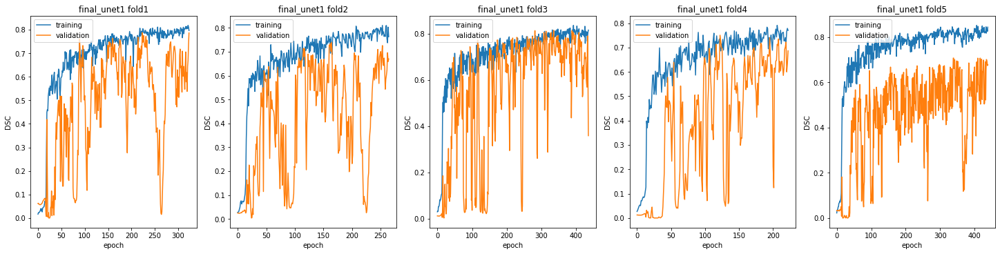

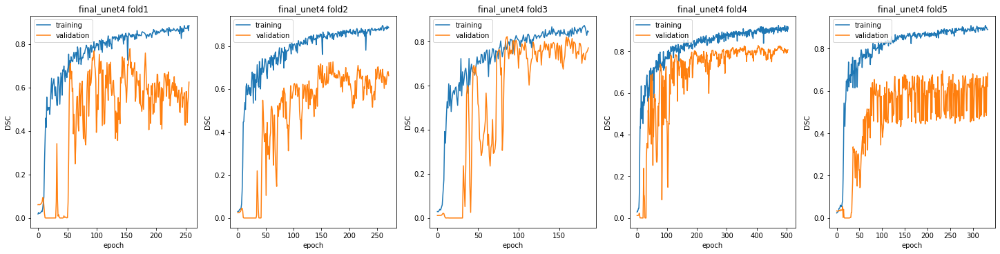

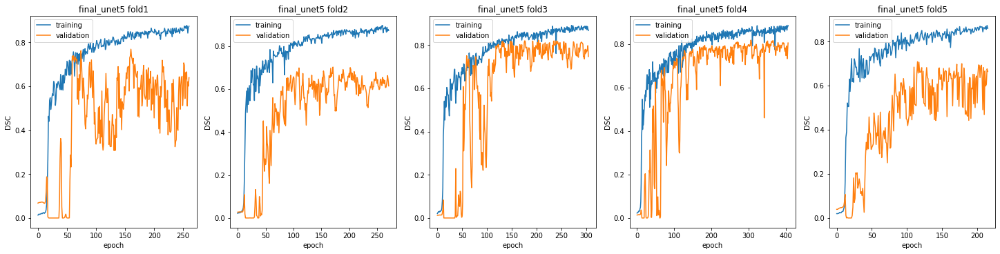

In [5]:
Unets = ["final_unet1.csv", "final_unet4.csv", "final_unet5.csv"]
histories_csvs = []
titles = ["final_unet1", "final_unet4", "final_unet5"]
i = 0
for Unet in Unets:
    csv = pd.read_csv(base_path + "experiment_results/" + Unet)
    histories_csvs.append(csv)
    show_all_folds_dice_coefficient_result(csv, titles=[titles[i]]*5, metric="DSC", val_metric="val_DSC")
    i += 1

In [23]:
def predict(model, lungs):
    predictions = []
    for lung in lungs:
        prediction = model(lung)
        predictions.append(prediction)
    return np.array(predictions)

answer1s = []
answer2s = []
answer3s = []

for i in range(1, 6):

    model1 = U_Net1()
    model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_{i}/model") 
    model2 = U_Net4()
    model2.load_weights(base_path + f"experiment_weights/Unet/final_unet4_fold_num_{i}/model") 
    model3 = U_Net5()
    model3.load_weights(base_path + f"experiment_weights/Unet/final_unet5_fold_num_{i}/model") 
    
    j = i - 1
    t = []
    lungs = []
    for k in range(j*4, j*4+4):
        lungs.append(np.reshape(covid19s[k], (1, 128, 128, 64, 1)))
        t.append(np.reshape(covid19masks[k], (1, 128, 128, 64, 1)))
    t = np.array(t)
    lungs = np.array(lungs)

    predictions_1 = predict(model1, lungs)
    predictions_2 = predict(model2, lungs)
    predictions_3 = predict(model3, lungs)
    answer1 = DSC(t, predictions_1)
    answer2 = DSC(t, predictions_2)
    answer3 = DSC(t, predictions_3)
    print(answer1)
    print(answer2)
    print(answer3)
    answer1s.append(answer1)
    answer2s.append(answer2)
    answer3s.append(answer3)
    print("X"*100)
print(np.mean(answer1s))
print(np.std(answer1s))
print("Q"*100)
print(np.mean(answer2s))
print(np.std(answer2s))
print("Q"*100)
print(np.mean(answer3s))
print(np.std(answer3s))

tf.Tensor(0.7736589, shape=(), dtype=float32)
tf.Tensor(0.7545556, shape=(), dtype=float32)
tf.Tensor(0.74032146, shape=(), dtype=float32)
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
tf.Tensor(0.76345634, shape=(), dtype=float32)
tf.Tensor(0.73312706, shape=(), dtype=float32)
tf.Tensor(0.7094348, shape=(), dtype=float32)
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
tf.Tensor(0.8046978, shape=(), dtype=float32)
tf.Tensor(0.80865085, shape=(), dtype=float32)
tf.Tensor(0.81337285, shape=(), dtype=float32)
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
tf.Tensor(0.7500317, shape=(), dtype=float32)
tf.Tensor(0.8252676, shape=(), dtype=float32)
tf.Tensor(0.81545085, shape=(), dtype=float32)
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
tf.Tensor(0.6873193, shape=(), dtype=f

In [27]:
model1 = U_Net1()
model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_3/model") 
model2 = U_Net4()
model2.load_weights(base_path + f"experiment_weights/Unet/final_unet4_fold_num_3/model") 
model3 = U_Net5()
model3.load_weights(base_path + f"experiment_weights/Unet/final_unet5_fold_num_3/model") 

s = 0.8046978 + 0.80865085 + 0.81337285
u1_c = 0.8046978 / s
u4_c = 0.80865085 / s
u5_c = 0.81337285 / s

model1_vector = get_true_prediction_vector(model1, lung, true_mask)
model4_vector = get_true_prediction_vector(model4, lung, true_mask)
model5_vector = get_true_prediction_vector(model5, lung, true_mask)

print(get_angle(model1_vector, model4_vector))
print(get_angle(model1_vector, model5_vector))
print(get_angle(model4_vector, model5_vector))

0.09374124877024824
0.07937077829746349
0.08481659175461694


In [47]:
def SGD():
    optimizer = keras.optimizers.SGD(learning_rate=0.001, momentum=0.99, nesterov=True)
    return optimizer
model1 = U_Net1()
model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_1/model") 
model2 = U_Net4()
model2.load_weights(base_path + f"experiment_weights/Unet/final_unet4_fold_num_1/model") 
model3 = U_Net5()
model3.load_weights(base_path + f"experiment_weights/Unet/final_unet5_fold_num_1/model") 
model1.trainable = False
model2.trainable = False
model3.trainable = False

s = 0.7736589 + 0.7545556 + 0.74032146
u1_c = 0.7736589 / s
u4_c = 0.7545556 / s
u5_c = 0.74032146 / s

class Attention_in_3D_1_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u1_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_4_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u4_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_5_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u5_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
def Attention_Mechanism_Model_1d_depth():
    tf.random.set_seed(2021)
    ct = keras.Input((128, 128, 64, 1))
    model1_output = model1(ct)
    model4_output = model4(ct)
    model5_output = model5(ct)
    attention1 = Attention_in_3D_1_1d_depth(name="attention1")(model1_output)
    attention4 = Attention_in_3D_4_1d_depth(name="attention2")(model4_output)
    attention5 = Attention_in_3D_5_1d_depth(name="attention3")(model5_output) 
    model = keras.Model(ct, (attention1+attention4+attention5))
    return model

models = [Attention_Mechanism_Model_1d_depth]
models_name = ["final_model_1"]
kfold = KFold(n_splits=5, shuffle=False)
for model_index, model_func in enumerate(models):
    print("start"*100)
    print(models_name[model_index])
    folds = kfold.split(covid19s, covid19masks)
    histories = []
    for train_data, valid_data in folds:
        if valid_data[0] != 0: 
            continue
        train_dataset, validation_dataset = get_dataset(train_data, valid_data, augment_wrapper(["combined_voxels", "fliplr", "flipud", "intensify", "translate", "rotate", "scale", "noise"],n=0))
        model = model_func()
        model_checkpoint_cb = get_model_checkpoint_cb(base_path + "experiment_weights/Unet/" + models_name[model_index] + "/model")
        optimizer = SGD()
        model.compile(loss=DSCL, optimizer=optimizer, metrics=[DSC])
        epochs = 2000
        early_stop_cb = keras.callbacks.EarlyStopping(patience=100)
        history = model.fit(
            train_dataset,
            validation_data=validation_dataset,
            epochs=epochs,
            shuffle=False,
            verbose=2,
            callbacks=[model_checkpoint_cb, early_stop_cb]
        )
        histories.append(history)
        print("end"*100)

startstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstart
final_model_1
Epoch 1/2000
8/8 - 7s - loss: 0.3157 - DSC: 0.6843 - val_loss: 0.1781 - val_DSC: 0.8219
Epoch 2/2000
8/8 - 4s - loss: 0.3676 - DSC: 0.6324 - val_loss: 0.1977 - val_DSC: 0.8023
Epoch 3/2000
8/8 - 4s - loss: 0.3230 - DSC: 0.6770 - val_loss: 0.1976 - val_DSC: 0.8024
Epoch 4/2000
8/8 - 4s - loss: 0.3332 - DSC: 0.6668 - val_loss: 0.1778 - val_DSC: 0.8222
Epoch 5/2000
8/8 - 4s - loss: 0.3451 - DSC: 0.6549 - val_loss: 0.1692 - val_DSC: 0.8308
Epoch 6/2000
8/8 - 4s - loss: 0.3259 - DSC: 0

In [48]:
model1 = U_Net1()
model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_2/model") 
model2 = U_Net4()
model2.load_weights(base_path + f"experiment_weights/Unet/final_unet4_fold_num_2/model") 
model3 = U_Net5()
model3.load_weights(base_path + f"experiment_weights/Unet/final_unet5_fold_num_2/model") 
model1.trainable = False
model2.trainable = False
model3.trainable = False


s = 0.76345634 + 0.73312706 + 0.7094348
u1_c = 0.76345634 / s
u4_c = 0.73312706 / s
u5_c = 0.7094348 / s

class Attention_in_3D_1_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u1_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_4_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u4_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_5_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u5_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
def Attention_Mechanism_Model_1d_depth():
    tf.random.set_seed(2021)
    ct = keras.Input((128, 128, 64, 1))
    model1_output = model1(ct)
    model4_output = model4(ct)
    model5_output = model5(ct)
    attention1 = Attention_in_3D_1_1d_depth(name="attention1")(model1_output)
    attention4 = Attention_in_3D_4_1d_depth(name="attention2")(model4_output)
    attention5 = Attention_in_3D_5_1d_depth(name="attention3")(model5_output) 
    model = keras.Model(ct, (attention1+attention4+attention5))
    return model

models = [Attention_Mechanism_Model_1d_depth]
models_name = ["final_model_2"]
kfold = KFold(n_splits=5, shuffle=False)
for model_index, model_func in enumerate(models):
    print("start"*100)
    print(models_name[model_index])
    folds = kfold.split(covid19s, covid19masks)
    histories = []
    for train_data, valid_data in folds:
        if valid_data[0] != 4: continue
        train_dataset, validation_dataset = get_dataset(train_data, valid_data, augment_wrapper(["combined_voxels", "fliplr", "flipud", "intensify", "translate", "rotate", "scale", "noise"],n=1))
        model = model_func()
        model_checkpoint_cb = get_model_checkpoint_cb(base_path + "experiment_weights/Unet/" + models_name[model_index] + "/model")
        optimizer = SGD()
        model.compile(loss=DSCL, optimizer=optimizer, metrics=[DSC])
        epochs = 2000
        early_stop_cb = keras.callbacks.EarlyStopping(patience=100)
        history = model.fit(
            train_dataset,
            validation_data=validation_dataset,
            epochs=epochs,
            shuffle=False,
            verbose=2,
            callbacks=[model_checkpoint_cb, early_stop_cb]
        )
        histories.append(history)
        print("end"*100)

startstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstart
final_model_2
Epoch 1/2000
8/8 - 7s - loss: 0.3050 - DSC: 0.6950 - val_loss: 0.3656 - val_DSC: 0.6344
Epoch 2/2000
8/8 - 4s - loss: 0.2851 - DSC: 0.7149 - val_loss: 0.3269 - val_DSC: 0.6731
Epoch 3/2000
8/8 - 4s - loss: 0.2342 - DSC: 0.7658 - val_loss: 0.3266 - val_DSC: 0.6734
Epoch 4/2000
8/8 - 4s - loss: 0.2959 - DSC: 0.7041 - val_loss: 0.3649 - val_DSC: 0.6351
Epoch 5/2000
8/8 - 4s - loss: 0.3315 - DSC: 0.6685 - val_loss: 0.2896 - val_DSC: 0.7104
Epoch 6/2000
8/8 - 4s - loss: 0.3184 - DSC: 0

In [49]:



model1 = U_Net1()
model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_3/model") 
model2 = U_Net4()
model2.load_weights(base_path + f"experiment_weights/Unet/final_unet4_fold_num_3/model") 
model3 = U_Net5()
model3.load_weights(base_path + f"experiment_weights/Unet/final_unet5_fold_num_3/model") 
model1.trainable = False
model2.trainable = False
model3.trainable = False


s = 0.8046978 + 0.80865085 + 0.81337285
u1_c = 0.8046978 / s
u4_c = 0.80865085 / s
u5_c = 0.81337285 / s

class Attention_in_3D_1_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u1_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_4_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u4_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_5_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u5_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
def Attention_Mechanism_Model_1d_depth():
    tf.random.set_seed(2021)
    ct = keras.Input((128, 128, 64, 1))
    model1_output = model1(ct)
    model4_output = model4(ct)
    model5_output = model5(ct)
    attention1 = Attention_in_3D_1_1d_depth(name="attention1")(model1_output)
    attention4 = Attention_in_3D_4_1d_depth(name="attention2")(model4_output)
    attention5 = Attention_in_3D_5_1d_depth(name="attention3")(model5_output) 
    model = keras.Model(ct, (attention1+attention4+attention5))
    return model

models = [Attention_Mechanism_Model_1d_depth]
models_name = ["final_model_3"]
kfold = KFold(n_splits=5, shuffle=False)
for model_index, model_func in enumerate(models):
    print("start"*100)
    print(models_name[model_index])
    folds = kfold.split(covid19s, covid19masks)
    histories = []
    for train_data, valid_data in folds:
        if valid_data[0] != 8: continue
        train_dataset, validation_dataset = get_dataset(train_data, valid_data, augment_wrapper(["combined_voxels", "fliplr", "flipud", "intensify", "translate", "rotate", "scale", "noise"],n=2))
        model = model_func()
        model_checkpoint_cb = get_model_checkpoint_cb(base_path + "experiment_weights/Unet/" + models_name[model_index] + "/model")
        optimizer = SGD()
        model.compile(loss=DSCL, optimizer=optimizer, metrics=[DSC])
        epochs = 2000
        early_stop_cb = keras.callbacks.EarlyStopping(patience=100)
        history = model.fit(
            train_dataset,
            validation_data=validation_dataset,
            epochs=epochs,
            shuffle=False,
            verbose=2,
            callbacks=[model_checkpoint_cb, early_stop_cb]
        )
        histories.append(history)
        print("end"*100)

startstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstart
final_model_3
Epoch 1/2000
8/8 - 7s - loss: 0.2650 - DSC: 0.7350 - val_loss: 0.2199 - val_DSC: 0.7801
Epoch 2/2000
8/8 - 4s - loss: 0.3136 - DSC: 0.6864 - val_loss: 0.2721 - val_DSC: 0.7279
Epoch 3/2000
8/8 - 4s - loss: 0.3290 - DSC: 0.6710 - val_loss: 0.2718 - val_DSC: 0.7282
Epoch 4/2000
8/8 - 4s - loss: 0.3290 - DSC: 0.6710 - val_loss: 0.2189 - val_DSC: 0.7811
Epoch 5/2000
8/8 - 4s - loss: 0.2610 - DSC: 0.7390 - val_loss: 0.2984 - val_DSC: 0.7016
Epoch 6/2000
8/8 - 4s - loss: 0.2772 - DSC: 0

In [50]:
model1 = U_Net1()
model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_4/model") 
model2 = U_Net4()
model2.load_weights(base_path + f"experiment_weights/Unet/final_unet4_fold_num_4/model") 
model3 = U_Net5()
model3.load_weights(base_path + f"experiment_weights/Unet/final_unet5_fold_num_4/model") 
model1.trainable = False
model2.trainable = False
model3.trainable = False


s = 0.7500317 + 0.8252676 + 0.81545085
u1_c = 0.7500317 / s
u4_c = 0.8252676 / s
u5_c = 0.81545085 / s

class Attention_in_3D_1_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u1_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_4_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u4_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_5_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u5_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
def Attention_Mechanism_Model_1d_depth():
    tf.random.set_seed(2021)
    ct = keras.Input((128, 128, 64, 1))
    model1_output = model1(ct)
    model4_output = model4(ct)
    model5_output = model5(ct)
    attention1 = Attention_in_3D_1_1d_depth(name="attention1")(model1_output)
    attention4 = Attention_in_3D_4_1d_depth(name="attention2")(model4_output)
    attention5 = Attention_in_3D_5_1d_depth(name="attention3")(model5_output) 
    model = keras.Model(ct, (attention1+attention4+attention5))
    return model

models = [Attention_Mechanism_Model_1d_depth]
models_name = ["final_model_4"]
kfold = KFold(n_splits=5, shuffle=False)
for model_index, model_func in enumerate(models):
    print("start"*100)
    print(models_name[model_index])
    folds = kfold.split(covid19s, covid19masks)
    histories = []
    for train_data, valid_data in folds:
        if valid_data[0] != 12: continue
        train_dataset, validation_dataset = get_dataset(train_data, valid_data, augment_wrapper(["combined_voxels", "fliplr", "flipud", "intensify", "translate", "rotate", "scale", "noise"],n=3))
        model = model_func()
        model_checkpoint_cb = get_model_checkpoint_cb(base_path + "experiment_weights/Unet/" + models_name[model_index] + "/model")
        optimizer = SGD()
        model.compile(loss=DSCL, optimizer=optimizer, metrics=[DSC])
        epochs = 2000
        early_stop_cb = keras.callbacks.EarlyStopping(patience=100)
        history = model.fit(
            train_dataset,
            validation_data=validation_dataset,
            epochs=epochs,
            shuffle=False,
            verbose=2,
            callbacks=[model_checkpoint_cb, early_stop_cb]
        )
        histories.append(history)
        print("end"*100)

startstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstart
final_model_4
Epoch 1/2000
8/8 - 7s - loss: 0.3247 - DSC: 0.6753 - val_loss: 0.2119 - val_DSC: 0.7881
Epoch 2/2000
8/8 - 4s - loss: 0.3336 - DSC: 0.6664 - val_loss: 0.2099 - val_DSC: 0.7901
Epoch 3/2000
8/8 - 4s - loss: 0.3243 - DSC: 0.6757 - val_loss: 0.2097 - val_DSC: 0.7903
Epoch 4/2000
8/8 - 4s - loss: 0.3620 - DSC: 0.6380 - val_loss: 0.2113 - val_DSC: 0.7887
Epoch 5/2000
8/8 - 4s - loss: 0.3449 - DSC: 0.6551 - val_loss: 0.2171 - val_DSC: 0.7829
Epoch 6/2000
8/8 - 4s - loss: 0.4454 - DSC: 0

In [51]:
s = 0.6873193 + 0.6618998 + 0.6950822
u1_c = 0.6873193 / s
u4_c = 0.6618998 / s
u5_c = 0.6950822 / s

model1 = U_Net1()
model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_5/model") 
model2 = U_Net4()
model2.load_weights(base_path + f"experiment_weights/Unet/final_unet4_fold_num_5/model") 
model3 = U_Net5()
model3.load_weights(base_path + f"experiment_weights/Unet/final_unet5_fold_num_5/model") 
model1.trainable = False
model2.trainable = False
model3.trainable = False

class Attention_in_3D_1_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u1_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_4_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u4_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
class Attention_in_3D_5_1d_depth(keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
    def build(self, batch_input_shape):
        self.kernel = self.add_weight(
            name="kernel", shape=[1,1,1,64,1],
            initializer=keras.initializers.constant(u5_c))
        super().build(batch_input_shape) 
    def call(self, X):
        return X * self.kernel
def Attention_Mechanism_Model_1d_depth():
    tf.random.set_seed(2021)
    ct = keras.Input((128, 128, 64, 1))
    model1_output = model1(ct)
    model4_output = model4(ct)
    model5_output = model5(ct)
    attention1 = Attention_in_3D_1_1d_depth(name="attention1")(model1_output)
    attention4 = Attention_in_3D_4_1d_depth(name="attention2")(model4_output)
    attention5 = Attention_in_3D_5_1d_depth(name="attention3")(model5_output) 
    model = keras.Model(ct, (attention1+attention4+attention5))
    return model

models = [Attention_Mechanism_Model_1d_depth]
models_name = ["final_model_5"]
kfold = KFold(n_splits=5, shuffle=False)
for model_index, model_func in enumerate(models):
    print("start"*100)
    print(models_name[model_index])
    folds = kfold.split(covid19s, covid19masks)
    histories = []
    for train_data, valid_data in folds:
        if valid_data[0] != 16: continue
        train_dataset, validation_dataset = get_dataset(train_data, valid_data, augment_wrapper(["combined_voxels", "fliplr", "flipud", "intensify", "translate", "rotate", "scale", "noise"],n=4))
        model = model_func()
        model_checkpoint_cb = get_model_checkpoint_cb(base_path + "experiment_weights/Unet/" + models_name[model_index] + "/model")
        optimizer = SGD()
        model.compile(loss=DSCL, optimizer=optimizer, metrics=[DSC])
        epochs = 2000
        early_stop_cb = keras.callbacks.EarlyStopping(patience=100)
        history = model.fit(
            train_dataset,
            validation_data=validation_dataset,
            epochs=epochs,
            shuffle=False,
            verbose=2,
            callbacks=[model_checkpoint_cb, early_stop_cb]
        )
        histories.append(history)
        print("end"*100)


startstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstartstart
final_model_5
Epoch 1/2000
8/8 - 7s - loss: 0.2366 - DSC: 0.7634 - val_loss: 0.3456 - val_DSC: 0.6544
Epoch 2/2000
8/8 - 4s - loss: 0.2779 - DSC: 0.7221 - val_loss: 0.4838 - val_DSC: 0.5162
Epoch 3/2000
8/8 - 4s - loss: 0.2254 - DSC: 0.7746 - val_loss: 0.4837 - val_DSC: 0.5163
Epoch 4/2000
8/8 - 4s - loss: 0.3119 - DSC: 0.6881 - val_loss: 0.3452 - val_DSC: 0.6548
Epoch 5/2000
8/8 - 4s - loss: 0.2290 - DSC: 0.7710 - val_loss: 0.2990 - val_DSC: 0.7010
Epoch 6/2000
8/8 - 4s - loss: 0.2616 - DSC: 0

In [64]:
lungs = []
t = []
for k in range(0*4, 0*4+4):
    lungs.append(np.reshape(covid19s[k], (1, 128, 128, 64, 1)))
    t.append(np.reshape(covid19masks[k], (1, 128, 128, 64, 1)))

final_model1 = Attention_Mechanism_Model_1d_depth()
final_model1.load_weights(base_path + "experiment_weights/Unet/final_model_1/model")
predictions_1 = predict(final_model1, lungs)
print(DSC(t, predictions_1))

s = 0.7736589 + 0.7545556 + 0.74032146
u1_c = 0.7736589 / s
u4_c = 0.7545556 / s
u5_c = 0.74032146 / s

model1 = U_Net1()
model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_1/model") 
model2 = U_Net4()
model2.load_weights(base_path + f"experiment_weights/Unet/final_unet4_fold_num_1/model") 
model3 = U_Net5()
model3.load_weights(base_path + f"experiment_weights/Unet/final_unet5_fold_num_1/model") 

predictions_i1 = predict(model1, lungs)
predictions_i4 = predict(model2, lungs)
predictions_i5 = predict(model3, lungs)
predictions_ii = (predictions_i1*u1_c + predictions_i4*u4_c + predictions_i5*u5_c) / (u1_c + u4_c + u5_c)
print(DSC(t, predictions_ii))

model1_vector = get_true_prediction_vector(model1, lungs[0], true_mask)
model4_vector = get_true_prediction_vector(model2, lungs[0], true_mask)
model5_vector = get_true_prediction_vector(model3, lungs[0], true_mask)

print(get_angle(model1_vector, model4_vector))
print(get_angle(model1_vector, model5_vector))
print(get_angle(model4_vector, model5_vector))

tf.Tensor(0.82574606, shape=(), dtype=float32)
tf.Tensor(0.78886765, shape=(), dtype=float32)
0.05672481292283741
0.055568899619103856
0.027861011632081094


In [65]:
lungs = []
t = []
for k in range(1*4, 1*4+4):
    lungs.append(np.reshape(covid19s[k], (1, 128, 128, 64, 1)))
    t.append(np.reshape(covid19masks[k], (1, 128, 128, 64, 1)))

final_model2 = Attention_Mechanism_Model_1d_depth()
final_model2.load_weights(base_path + "experiment_weights/Unet/final_model_2/model")
predictions_2 = predict(final_model2, lungs)
print(DSC(t, predictions_2))

s = 0.76345634 + 0.73312706 + 0.7094348
u1_c = 0.76345634 / s
u4_c = 0.73312706 / s
u5_c = 0.7094348 / s

model1 = U_Net1()
model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_2/model") 
model2 = U_Net4()
model2.load_weights(base_path + f"experiment_weights/Unet/final_unet4_fold_num_2/model") 
model3 = U_Net5()
model3.load_weights(base_path + f"experiment_weights/Unet/final_unet5_fold_num_2/model") 

predictions_i1 = predict(model1, lungs)
predictions_i4 = predict(model2, lungs)
predictions_i5 = predict(model3, lungs)
predictions_ii = (predictions_i1*u1_c + predictions_i4*u4_c + predictions_i5*u5_c) / (u1_c + u4_c + u5_c)
print(DSC(t, predictions_ii))

model1_vector = get_true_prediction_vector(model1, lungs[0], true_mask)
model4_vector = get_true_prediction_vector(model2, lungs[0], true_mask)
model5_vector = get_true_prediction_vector(model3, lungs[0], true_mask)

print(get_angle(model1_vector, model4_vector))
print(get_angle(model1_vector, model5_vector))
print(get_angle(model4_vector, model5_vector))

tf.Tensor(0.75705147, shape=(), dtype=float32)
tf.Tensor(0.7596484, shape=(), dtype=float32)
0.019019013835749735
0.019395740477879682
0.015987385245972274


In [66]:
lungs = []
t = []
for k in range(2*4, 2*4+4):
    lungs.append(np.reshape(covid19s[k], (1, 128, 128, 64, 1)))
    t.append(np.reshape(covid19masks[k], (1, 128, 128, 64, 1)))

final_model3 = Attention_Mechanism_Model_1d_depth()
final_model3.load_weights(base_path + "experiment_weights/Unet/final_model_3/model")
predictions_3 = predict(final_model3, lungs)
print(DSC(t, predictions_3))

s = 0.8046978 + 0.80865085 + 0.81337285
u1_c = 0.8046978 / s
u4_c = 0.80865085 / s
u5_c = 0.81337285 / s

model1 = U_Net1()
model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_3/model") 
model2 = U_Net4()
model2.load_weights(base_path + f"experiment_weights/Unet/final_unet4_fold_num_3/model") 
model3 = U_Net5()
model3.load_weights(base_path + f"experiment_weights/Unet/final_unet5_fold_num_3/model") 

predictions_i1 = predict(model1, lungs)
predictions_i4 = predict(model2, lungs)
predictions_i5 = predict(model3, lungs)
predictions_ii = (predictions_i1*u1_c + predictions_i4*u4_c + predictions_i5*u5_c) / (u1_c + u4_c + u5_c)
print(DSC(t, predictions_ii))

model1_vector = get_true_prediction_vector(model1, lungs[0], true_mask)
model4_vector = get_true_prediction_vector(model2, lungs[0], true_mask)
model5_vector = get_true_prediction_vector(model3, lungs[0], true_mask)

print(get_angle(model1_vector, model4_vector))
print(get_angle(model1_vector, model5_vector))
print(get_angle(model4_vector, model5_vector))

tf.Tensor(0.8105735, shape=(), dtype=float32)
tf.Tensor(0.82857573, shape=(), dtype=float32)
0.017736698246771036
0.019571878422143488
0.01605034084437915


In [67]:
lungs = []
t = []
for k in range(3*4, 3*4+4):
    lungs.append(np.reshape(covid19s[k], (1, 128, 128, 64, 1)))
    t.append(np.reshape(covid19masks[k], (1, 128, 128, 64, 1)))

final_model4 = Attention_Mechanism_Model_1d_depth()
final_model4.load_weights(base_path + "experiment_weights/Unet/final_model_4/model")
predictions_4 = predict(final_model4, lungs)
print(DSC(t, predictions_4))

s = 0.7500317 + 0.8252676 + 0.81545085
u1_c = 0.7500317 / s
u4_c = 0.8252676 / s
u5_c = 0.81545085 / s

model1 = U_Net1()
model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_4/model") 
model2 = U_Net4()
model2.load_weights(base_path + f"experiment_weights/Unet/final_unet4_fold_num_4/model") 
model3 = U_Net5()
model3.load_weights(base_path + f"experiment_weights/Unet/final_unet5_fold_num_4/model") 

predictions_i1 = predict(model1, lungs)
predictions_i4 = predict(model2, lungs)
predictions_i5 = predict(model3, lungs)
predictions_ii = (predictions_i1*u1_c + predictions_i4*u4_c + predictions_i5*u5_c) / (u1_c + u4_c + u5_c)
print(DSC(t, predictions_ii))

model1_vector = get_true_prediction_vector(model1, lungs[0], true_mask)
model4_vector = get_true_prediction_vector(model2, lungs[0], true_mask)
model5_vector = get_true_prediction_vector(model3, lungs[0], true_mask)

print(get_angle(model1_vector, model4_vector))
print(get_angle(model1_vector, model5_vector))
print(get_angle(model4_vector, model5_vector))

tf.Tensor(0.798447, shape=(), dtype=float32)
tf.Tensor(0.82816136, shape=(), dtype=float32)
0.04062190036430531
0.03784492805939529
0.0376813892074995


In [68]:
lungs = []
t = []
for k in range(4*4, 4*4+4):
    lungs.append(np.reshape(covid19s[k], (1, 128, 128, 64, 1)))
    t.append(np.reshape(covid19masks[k], (1, 128, 128, 64, 1)))

final_model5 = Attention_Mechanism_Model_1d_depth()
final_model5.load_weights(base_path + "experiment_weights/Unet/final_model_5/model")
predictions_5 = predict(final_model5, lungs)
print(DSC(t, predictions_5))

s = 0.6873193 + 0.6618998 + 0.6950822
u1_c = 0.6873193 / s
u4_c = 0.6618998 / s
u5_c = 0.6950822 / s

model1 = U_Net1()
model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_5/model") 
model2 = U_Net4()
model2.load_weights(base_path + f"experiment_weights/Unet/final_unet4_fold_num_5/model") 
model3 = U_Net5()
model3.load_weights(base_path + f"experiment_weights/Unet/final_unet5_fold_num_5/model") 

predictions_i1 = predict(model1, lungs)
predictions_i4 = predict(model2, lungs)
predictions_i5 = predict(model3, lungs)
predictions_ii = (predictions_i1*u1_c + predictions_i4*u4_c + predictions_i5*u5_c) / (u1_c + u4_c + u5_c)
print(DSC(t, predictions_ii))

model1_vector = get_true_prediction_vector(model1, lungs[0], true_mask)
model4_vector = get_true_prediction_vector(model2, lungs[0], true_mask)
model5_vector = get_true_prediction_vector(model3, lungs[0], true_mask)

print(get_angle(model1_vector, model4_vector))
print(get_angle(model1_vector, model5_vector))
print(get_angle(model4_vector, model5_vector))

tf.Tensor(0.69356924, shape=(), dtype=float32)
tf.Tensor(0.70389956, shape=(), dtype=float32)
0.04076137201377562
0.04108811467173645
0.035464995826310845


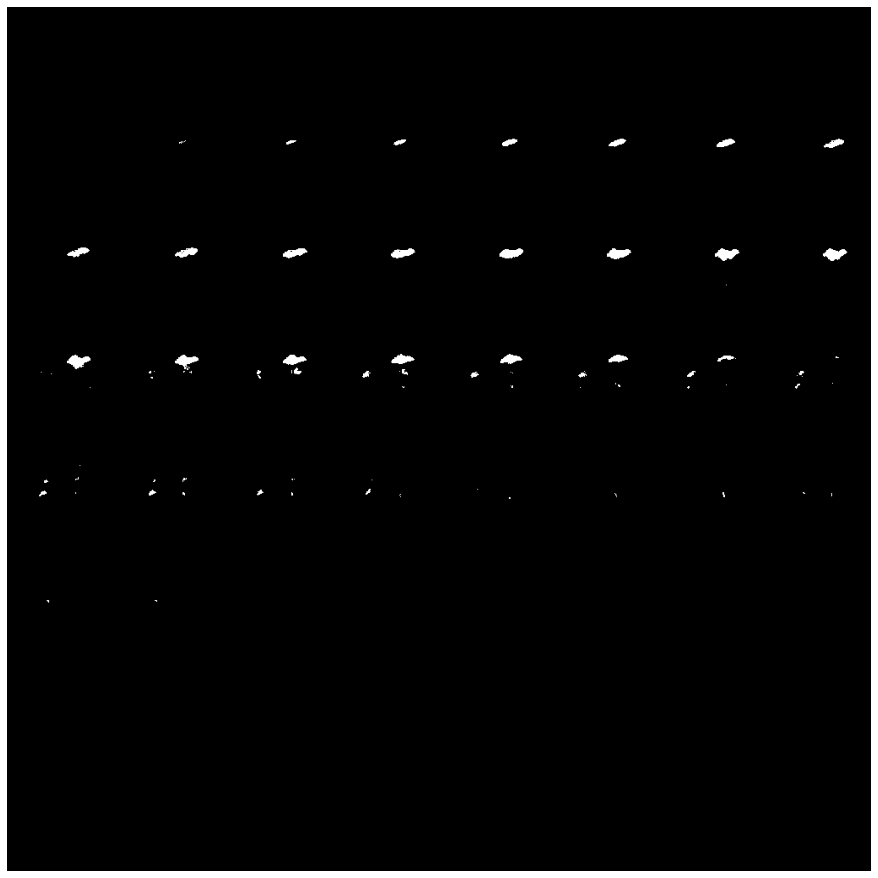

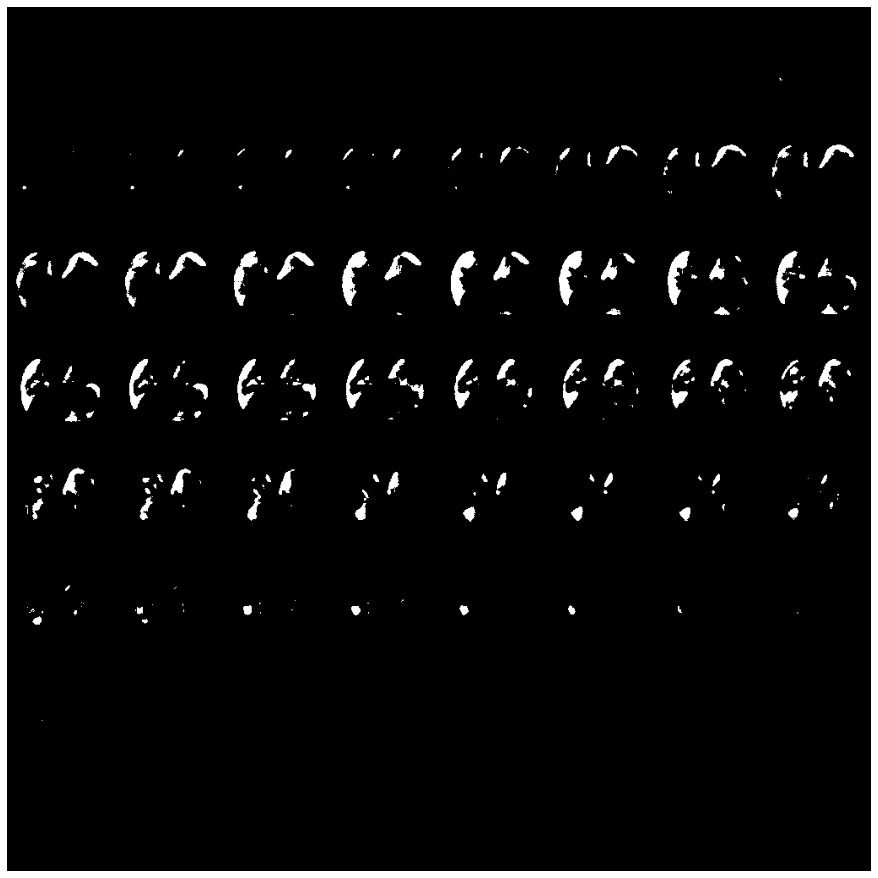

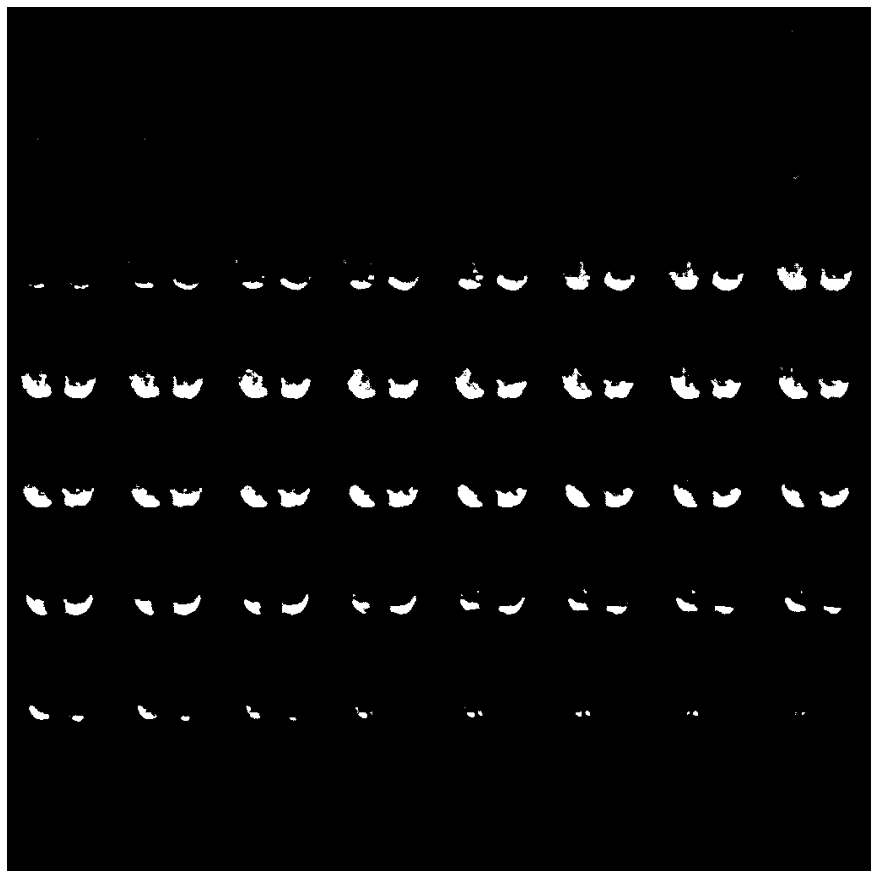

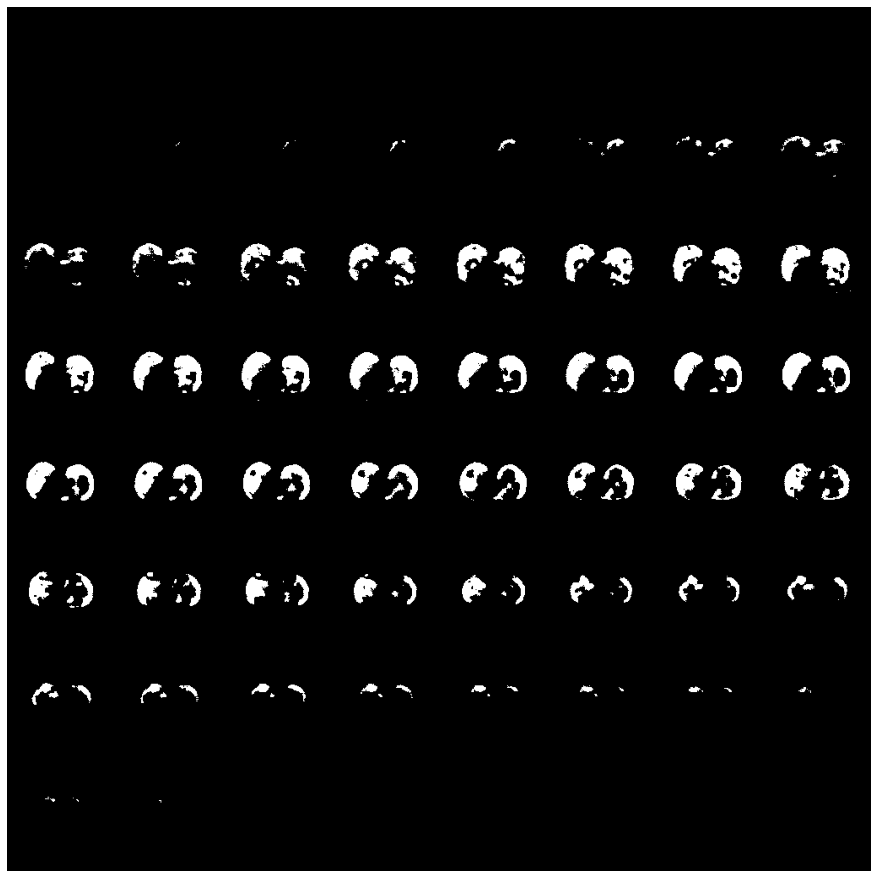

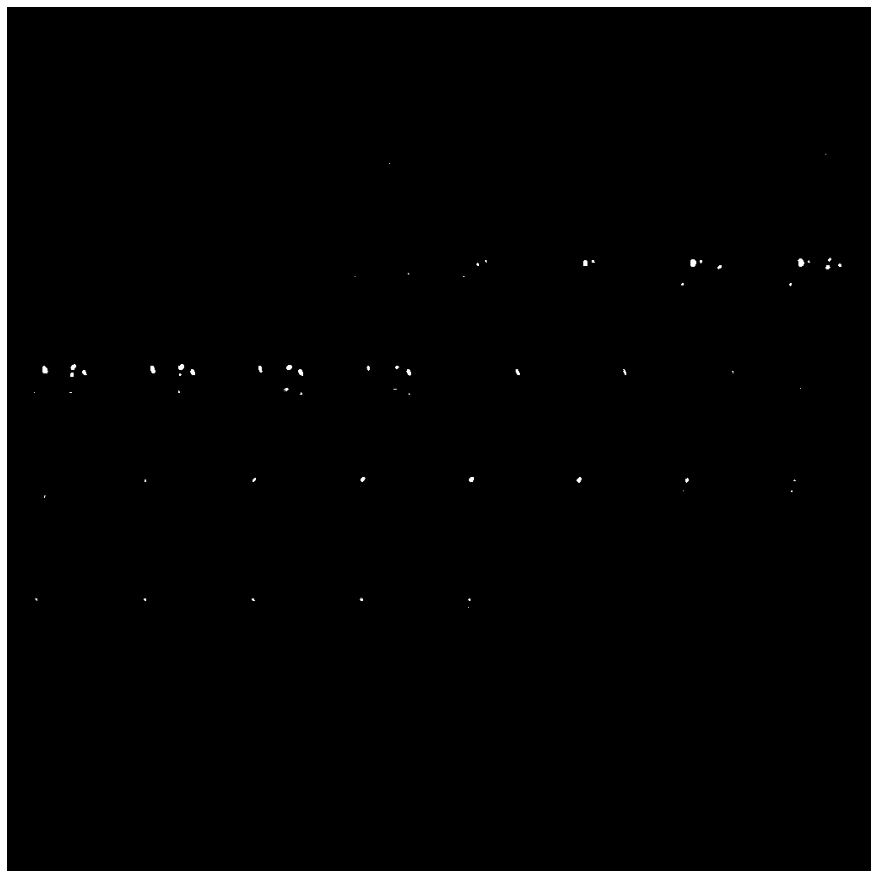

...

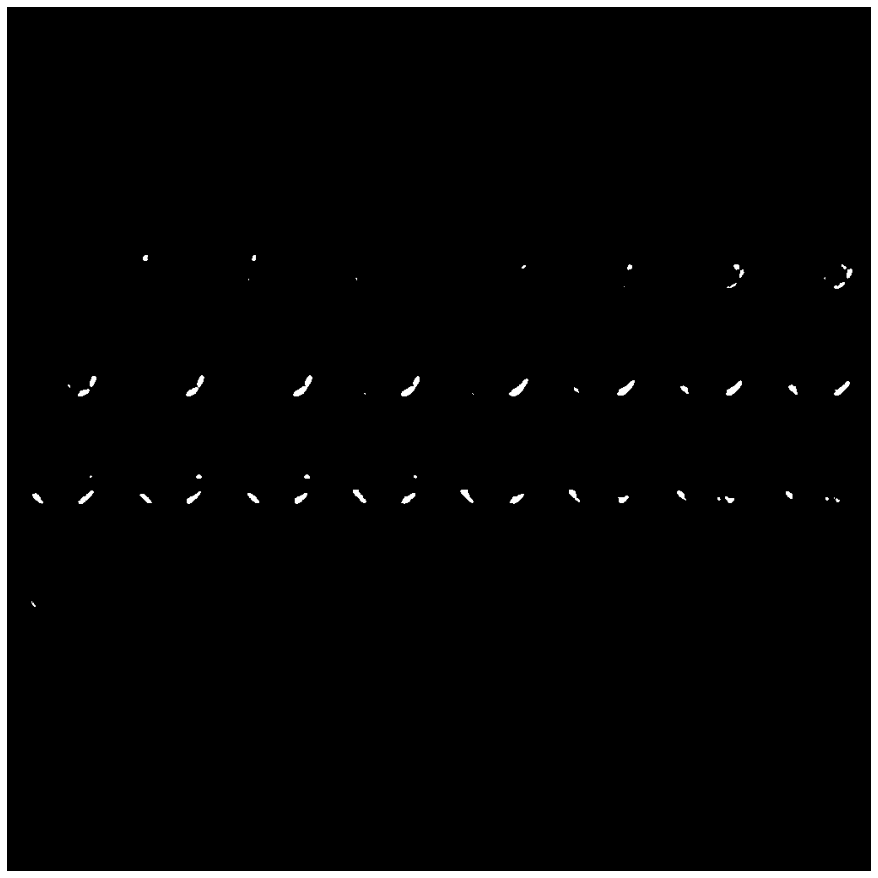

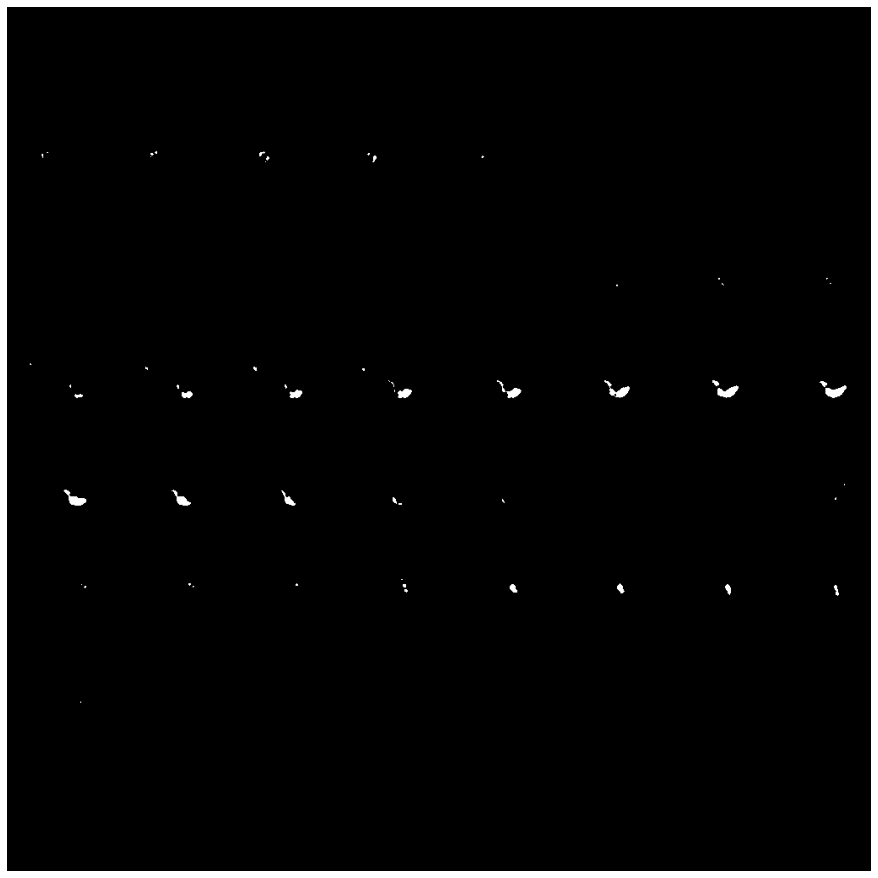

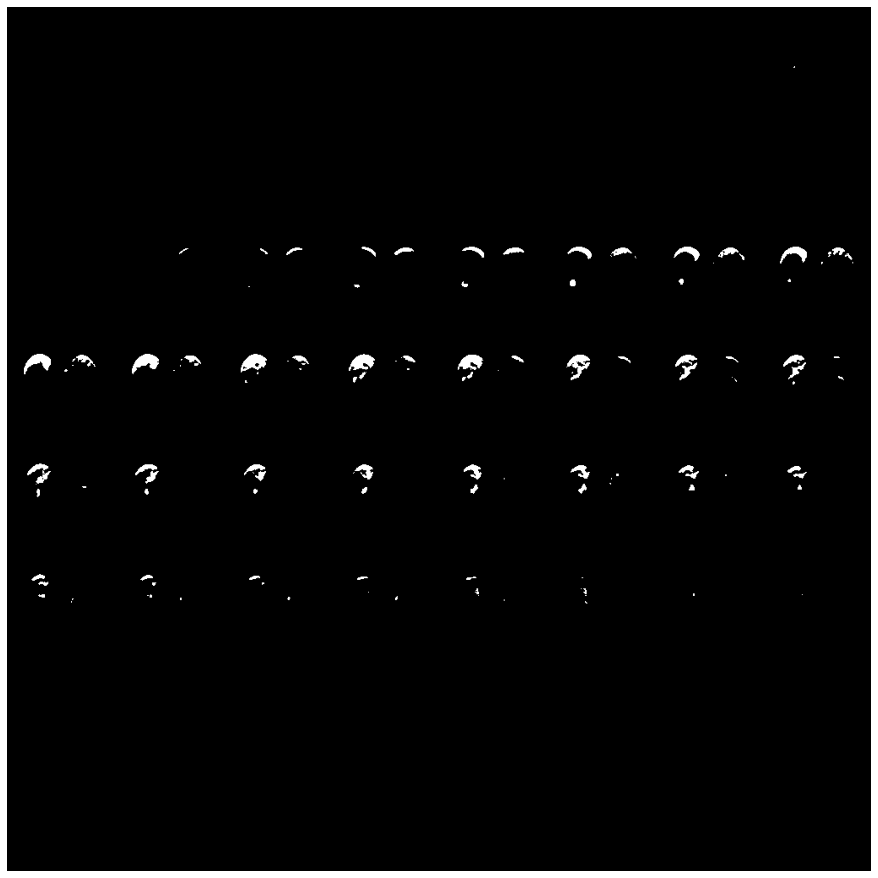

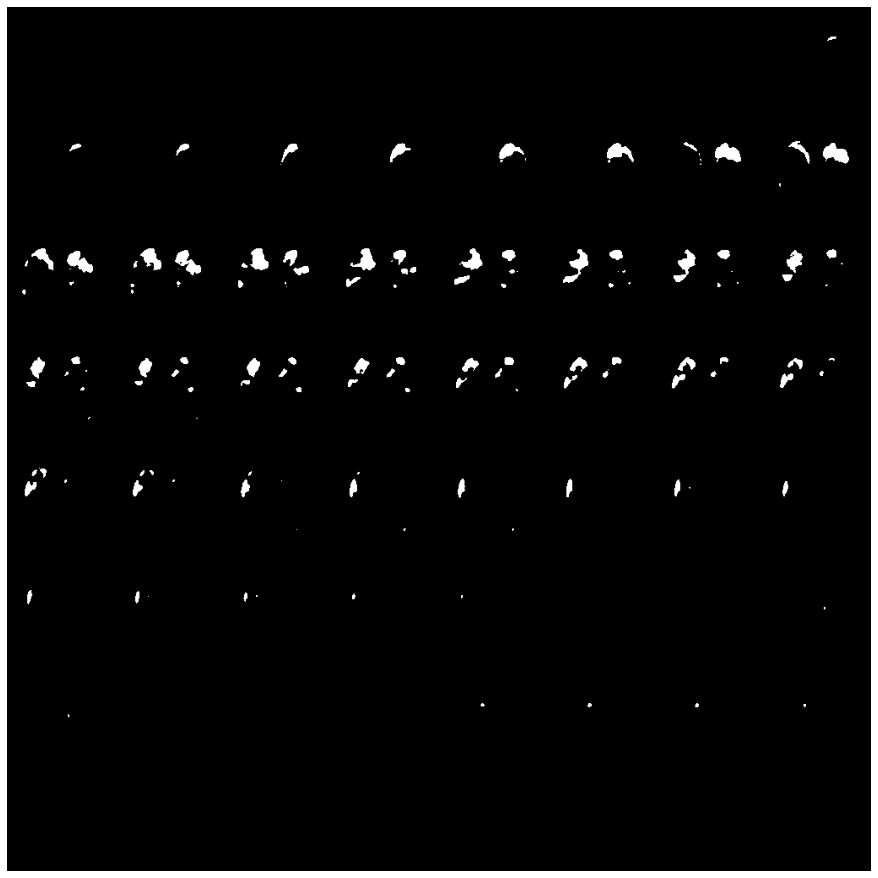

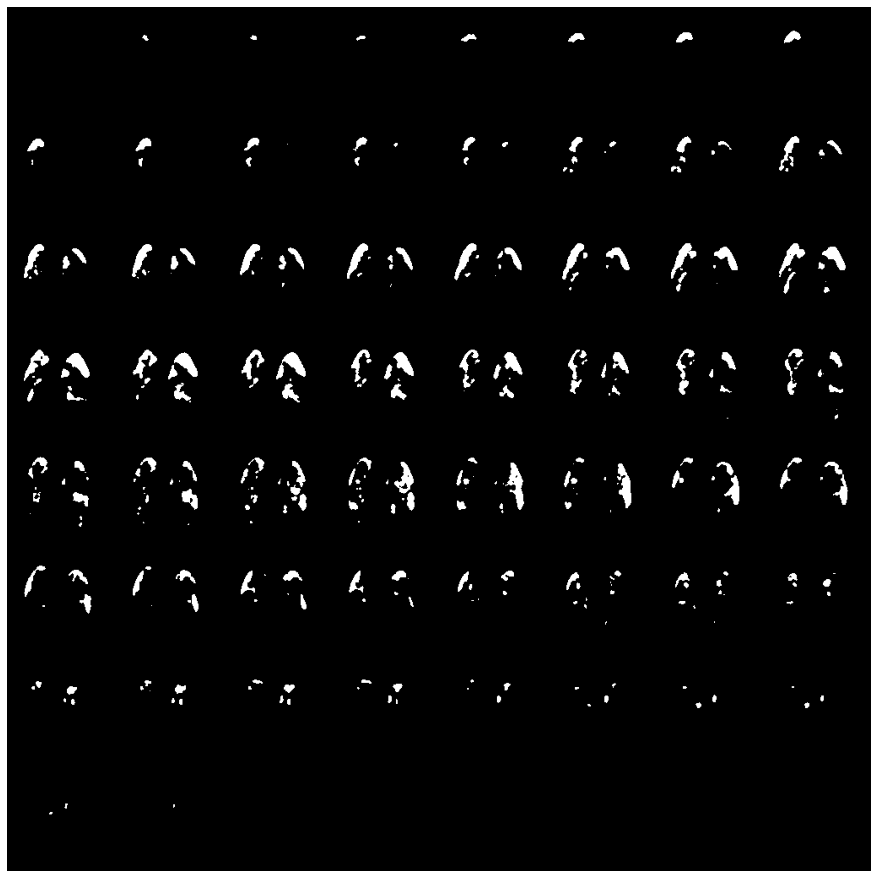

In [72]:
model1 = U_Net1()
model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_2/model") 
class Model3: 
    def __init__(self):
        model1 = U_Net1()
        model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_3/model") 
        model2 = U_Net4()
        model2.load_weights(base_path + f"experiment_weights/Unet/final_unet4_fold_num_3/model") 
        model3 = U_Net5()
        model3.load_weights(base_path + f"experiment_weights/Unet/final_unet5_fold_num_3/model") 
        self.model1 = model1
        self.model2 = model2
        self.model3 = model3
    def predict(self, lung):
        predictions_i1 = self.model1.predict(lung)
        predictions_i4 = self.model2.predict(lung)
        predictions_i5 = self.model3.predict(lung)
        predictions_ii = (predictions_i1*u1_c + predictions_i4*u4_c + predictions_i5*u5_c) / (u1_c + u4_c + u5_c)
        return predictions_ii
class Model4: 
    def __init__(self):
        model1 = U_Net1()
        model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_4/model") 
        model2 = U_Net4()
        model2.load_weights(base_path + f"experiment_weights/Unet/final_unet4_fold_num_4/model") 
        model3 = U_Net5()
        model3.load_weights(base_path + f"experiment_weights/Unet/final_unet5_fold_num_4/model") 
        self.model1 = model1
        self.model2 = model2
        self.model3 = model3
    def predict(self, lung):
        predictions_i1 = self.model1.predict(lung)
        predictions_i4 = self.model2.predict(lung)
        predictions_i5 = self.model3.predict(lung)
        predictions_ii = (predictions_i1*u1_c + predictions_i4*u4_c + predictions_i5*u5_c) / (u1_c + u4_c + u5_c)
        return predictions_ii
class Model5: 
    def __init__(self):
        model1 = U_Net1()
        model1.load_weights(base_path + f"experiment_weights/Unet/final_unet1_fold_num_5/model") 
        model2 = U_Net4()
        model2.load_weights(base_path + f"experiment_weights/Unet/final_unet4_fold_num_5/model") 
        model3 = U_Net5()
        model3.load_weights(base_path + f"experiment_weights/Unet/final_unet5_fold_num_5/model") 
        self.model1 = model1
        self.model2 = model2
        self.model3 = model3
    def predict(self, lung):
        predictions_i1 = self.model1.predict(lung)
        predictions_i4 = self.model2.predict(lung)
        predictions_i5 = self.model3.predict(lung)
        predictions_ii = (predictions_i1*u1_c + predictions_i4*u4_c + predictions_i5*u5_c) / (u1_c + u4_c + u5_c)
        return predictions_ii
models = [final_model1, model1, Model3(), Model4(), Model5()]
for i in range(5):
    for k in range(i*4, i*4+4):
        p = models[i].predict(np.reshape(covid19s[k], (1, 128, 128, 64, 1)))
        plot_slices(8, 8, 128, 128, np.squeeze(p) >= 0.5)